In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

# Read clusters' data

In [5]:
data = pd.read_excel('/content/drive/MyDrive/IEOR4574:Project_2/electricity_og_data.xlsx')

In [6]:
data

,Unnamed: 0,2011-01-01 00:00:00,2011-01-02 00:00:00,2011-01-03 00:00:00,2011-01-04 00:00:00,2011-01-05 00:00:00,2011-01-06 00:00:00,2011-01-07 00:00:00,2011-01-08 00:00:00,2011-01-09 00:00:00,...,2014-12-24 00:00:00,2014-12-25 00:00:00,2014-12-26 00:00:00,2014-12-27 00:00:00,2014-12-28 00:00:00,2014-12-29 00:00:00,2014-12-30 00:00:00,2014-12-31 00:00:00,2015-01-01 00:00:00,Cluster
0,MT_001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,170.050761,151.015228,2.131980e+02,2.119289e+02,2.271574e+02,2.487310e+02,2.322335e+02,2.296954e+02,2.538071,14
1,MT_002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2259.601707,2177.809388,2.173542e+03,2.145804e+03,2.131579e+03,2.212660e+03,2.205548e+03,2.273115e+03,19.914651,5
2,MT_003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,166.811468,1.737619,1.615986e+02,1.772372e+02,1.511729e+02,1.607298e+02,1.650738e+02,1.668115e+02,1.737619,14
3,MT_004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,13871.951220,12922.764228,1.387805e+04,1.494512e+04,1.432724e+04,1.406707e+04,1.429065e+04,1.400610e+04,178.861789,5
4,MT_005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6798.780488,6773.170732,6.979268e+03,7.368293e+03,6.776829e+03,7.198780e+03,7.189024e+03,7.023171e+03,84.146341,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
365,MT_366,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,537.156232,539.496782,1.084845e+03,6.980690e+02,5.523698e+02,1.153891e+03,8.923347e+02,5.301346e+02,4.095963,11
366,MT_367,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,54141.352063,46725.197542,5.390342e+04,5.348112e+04,4.591484e+04,5.392888e+04,5.633450e+04,5.025988e+04,628.621598,5
367,MT_368,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,13050.083472,4938.230384,1.249750e+04,7.823038e+03,4.405676e+03,1.291486e+04,1.599666e+04,1.324541e+04,131.886477,5
368,MT_369,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,75068.181818,67715.542522,7.672287e+04,7.096848e+04,6.613563e+04,7.388270e+04,7.395015e+04,7.041642e+04,673.020528,5


In [7]:
data = data.drop(columns = ['Unnamed: 0'], axis = 1)
cluster = data.groupby('Cluster').mean()
cluster = cluster.T
cluster = cluster[:-1]

<Axes: title={'center': 'clusters data visualization across time'}>

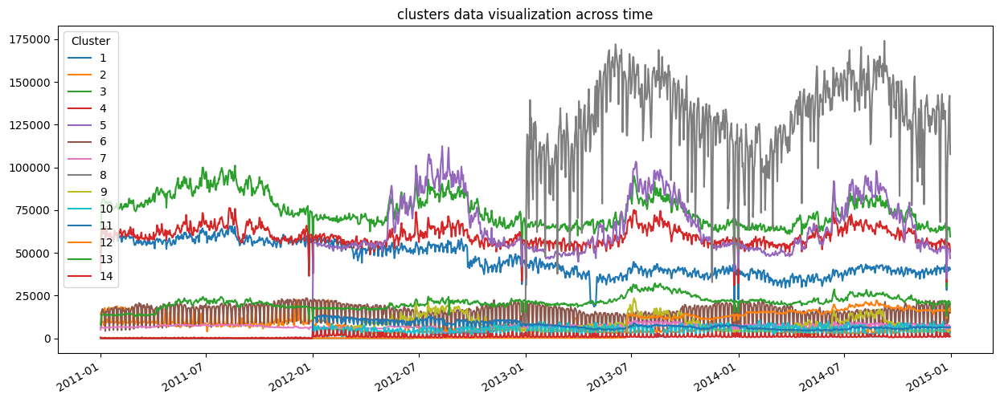

In [8]:
cluster.plot(figsize=(15,6),title = 'clusters data visualization across time')

In [9]:
cluster.index = pd.to_datetime(cluster.index)
cluster = cluster.resample("D").mean()

# check upon weather data

In [10]:
weather = pd.read_csv('/content/drive/MyDrive/IEOR4574:Project_2/daily_temperature.csv',  sep=';', decimal=',')

In [11]:
weather = weather[:-1]

In [12]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1827 entries, 0 to 1826
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   [       1827 non-null   object
dtypes: object(1)
memory usage: 14.4+ KB


In [13]:
weather

,[
0,"{""DATE"":""2011-01-01"",""STATION"":""PO000008535"",""..."
1,",{""DATE"":""2011-01-02"",""STATION"":""PO000008535"",..."
2,",{""DATE"":""2011-01-03"",""STATION"":""PO000008535"",..."
3,",{""DATE"":""2011-01-04"",""STATION"":""PO000008535"",..."
4,",{""DATE"":""2011-01-05"",""STATION"":""PO000008535"",..."
...,...
1822,",{""DATE"":""2015-12-28"",""STATION"":""PO000008535"",..."
1823,",{""DATE"":""2015-12-29"",""STATION"":""PO000008535"",..."
1824,",{""DATE"":""2015-12-30"",""STATION"":""PO000008535"",..."
1825,",{""DATE"":""2015-12-31"",""STATION"":""PO000008535"",..."


In [14]:
weather.rename(columns={"[": "text"}, inplace = True)
# df = pd.DataFrame.from_dict()
weather = weather.astype("string")
weather.text[0]
for i in range(1, len(weather.text)):
    weather.text[i]= weather.text[i].replace(',','',1)
df = []
for i in range(len(weather.text)):
    data=eval(weather.text[i])
    d = pd.DataFrame(data,index=[i])
    df.append(d)
for i in range(len(df)):
    if 'TAVG' not in df[i].columns:
        df[i]['TAVG'] = (float(df[i]['TMAX']) + float(df[i]['TMIN']))/2

for i in range(len(df)):
    if 'TAVG' not in df[i].columns:
        print('ERROR!!!')
w = pd.concat(df)
w.set_index('DATE', inplace = True)
w = w.drop(columns = ['STATION'], axis = 1)

In [15]:
w

,TMAX,TAVG,TMIN,PRCP
DATE,,,,
2011-01-01,63,57,52,0.02
2011-01-02,54,51,49,0.00
2011-01-03,56,52,49,0.00
2011-01-04,60,56,50,0.02
2011-01-05,62,60,58,1.23
...,...,...,...,...
2015-12-28,64,60,49,0.28
2015-12-29,65,56,51,0.00
2015-12-30,64,59,52,0.08


# Check stationarity & signal decomposition

##c1

In [16]:
c1 = cluster[1]

In [17]:
from sklearn.linear_model import LinearRegression
from scipy.optimize import curve_fit
from statsmodels.tsa.stattools import acovf
from matplotlib.ticker import FormatStrFormatter
import datetime as dt
from scipy import signal
from scipy.fft import fft, ifft
from matplotlib.ticker import AutoMinorLocator
import math
from statsmodels.formula.api import ols
from statsmodels.graphics.api import interaction_plot, abline_plot
from statsmodels.stats.anova import anova_lm
import statsmodels.api as sm

<Figure size 2000x700 with 0 Axes>

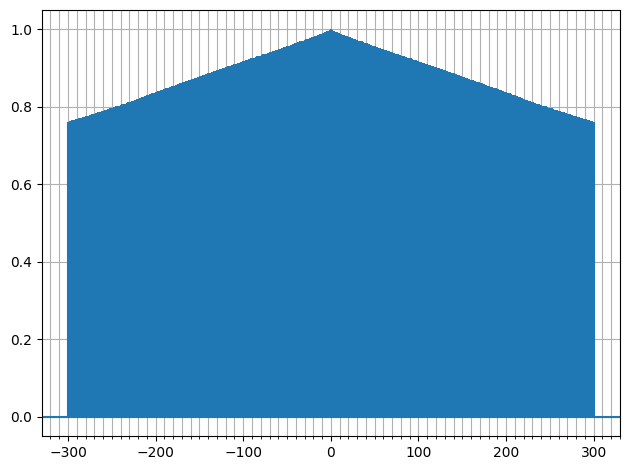

In [18]:
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c1.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

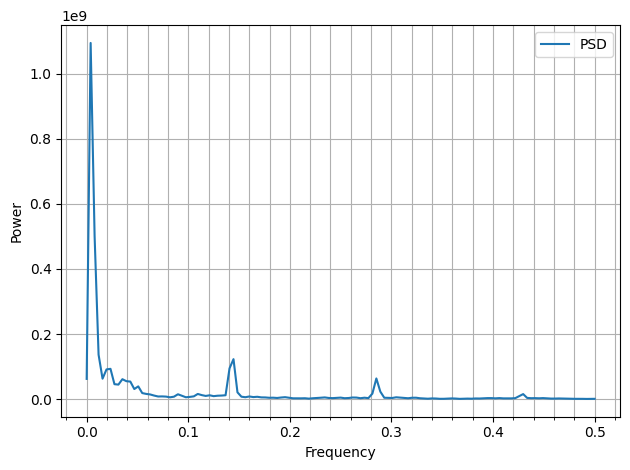

In [19]:
freqs, psd = signal.welch(c1.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

In [20]:
c1

2011-01-01    44477.134629
2011-01-02    57871.002017
2011-01-03    60482.968064
2011-01-04    61772.433396
2011-01-05    61266.570611
                  ...     
2014-12-27    41676.324490
2014-12-28    39507.351438
2014-12-29    40898.133923
2014-12-30    41543.813208
2014-12-31    40302.788409
Freq: D, Name: 1, Length: 1461, dtype: float64

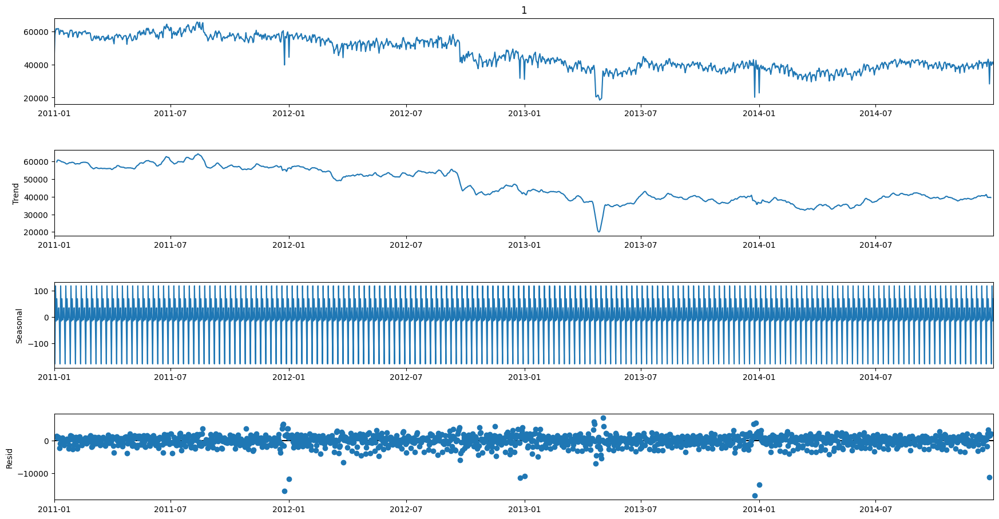

In [21]:
from statsmodels.tsa.seasonal import seasonal_decompose
z = c1.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 8,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

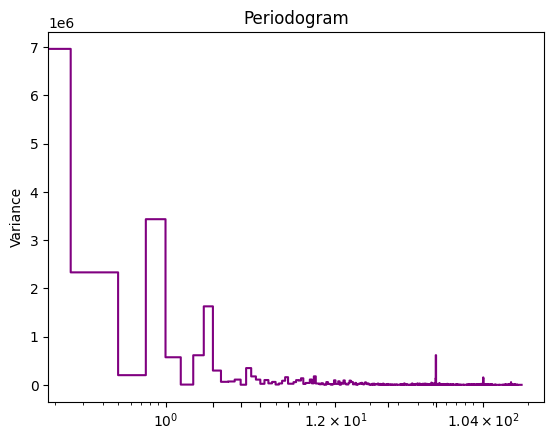

In [22]:
def plot_periodogram(ts, detrend='linear', ax=None):
    from scipy.signal import periodogram
    fs = pd.Timedelta("1Y") / pd.Timedelta("1D")
    freqencies, spectrum = periodogram(
        ts,
        fs=fs,
        detrend=detrend,
        window="boxcar",
        scaling='spectrum',
    )
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 3, 4, 6, 12, 26, 52, 104])
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    return ax
plot_periodogram(c1.values)

In [23]:
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess

fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c1.index,
period = 8,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c1 = pd.concat([c1,dp.in_sample()], axis = 1)


In [24]:
c1.rename(columns={1: 'power_usage'}, inplace = True)

In [25]:
c1.columns

Index(['power_usage', 'const', 'trend', 's(2,8)', 's(3,8)', 's(4,8)', 's(5,8)',
       's(6,8)', 's(7,8)', 's(8,8)', 'sin(1,freq=A-DEC)', 'cos(1,freq=A-DEC)',
       'sin(2,freq=A-DEC)', 'cos(2,freq=A-DEC)', 'sin(3,freq=A-DEC)',
       'cos(3,freq=A-DEC)'],
      dtype='object')

## c2

<Figure size 2000x700 with 0 Axes>

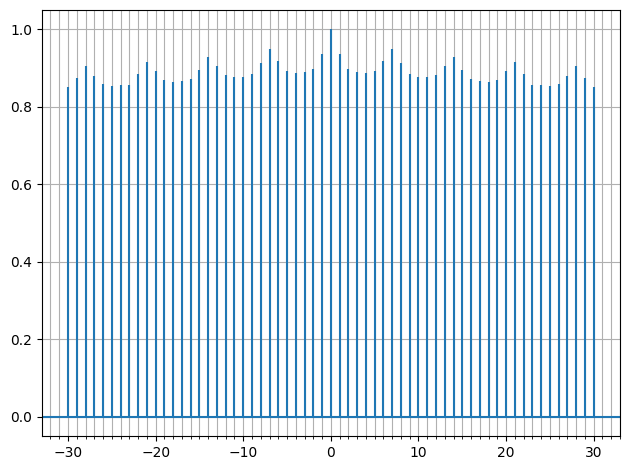

In [26]:
c2 = cluster[2]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c2.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

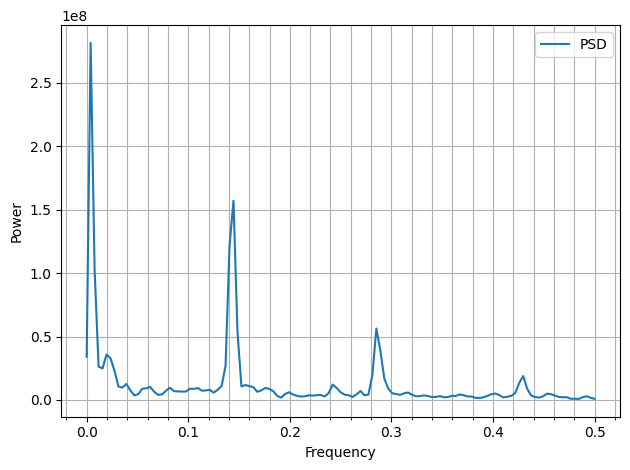

In [27]:
freqs, psd = signal.welch(c2.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

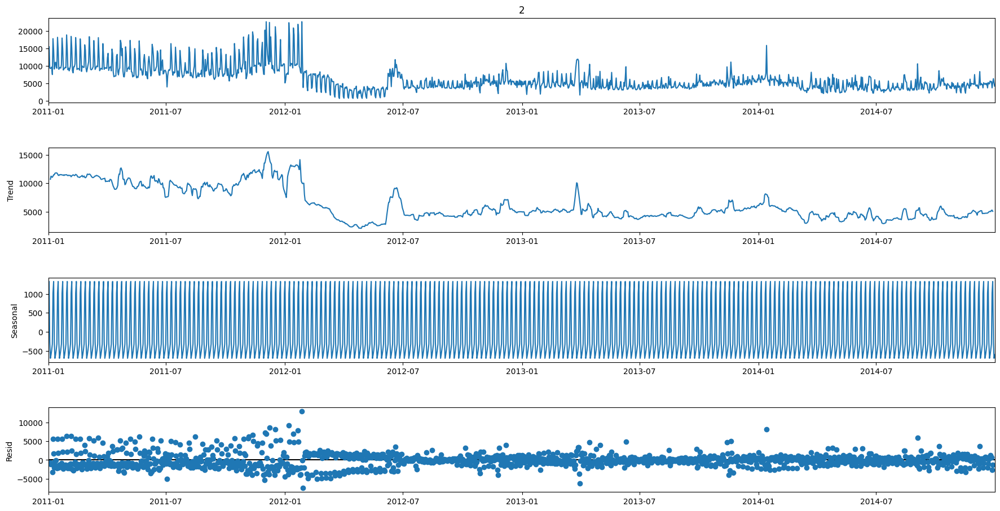

In [28]:
from statsmodels.tsa.seasonal import seasonal_decompose
z = c2.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 7,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

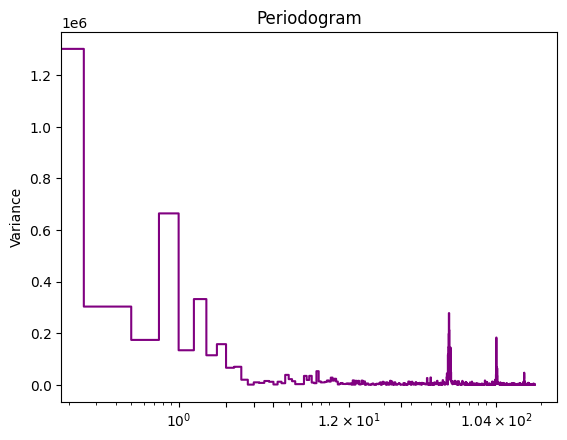

In [29]:
plot_periodogram(c2.values)

In [30]:
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess

fourier = CalendarFourier(freq="A", order=7)
dp = DeterministicProcess(
index= c2.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c2 = pd.concat([c2,dp.in_sample()], axis = 1)


In [31]:
c2.rename(columns={2: 'power_usage'}, inplace = True)

## c3

<Figure size 2000x700 with 0 Axes>

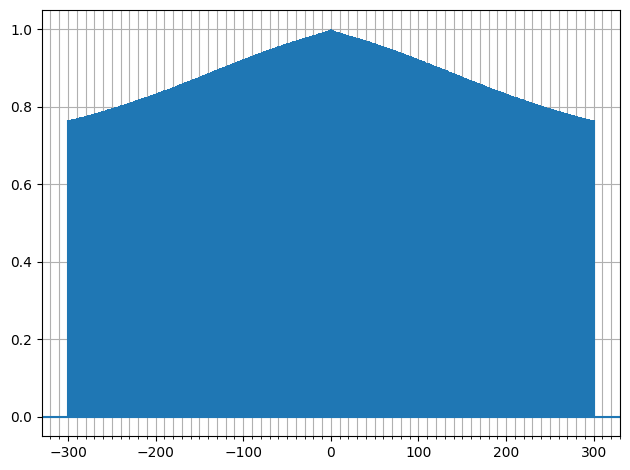

In [32]:
c3 = cluster[3]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c3.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

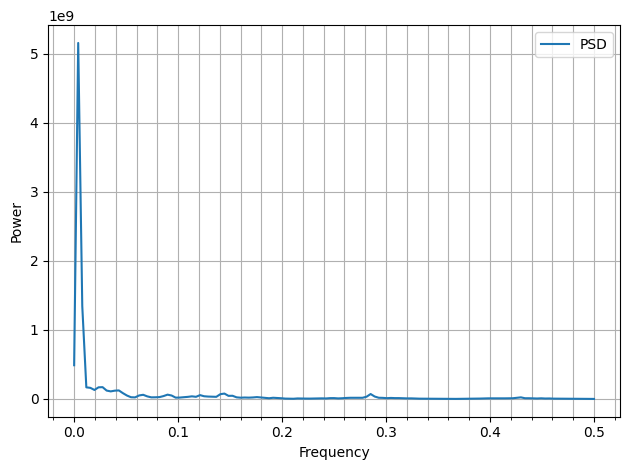

In [33]:
freqs, psd = signal.welch(c3.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

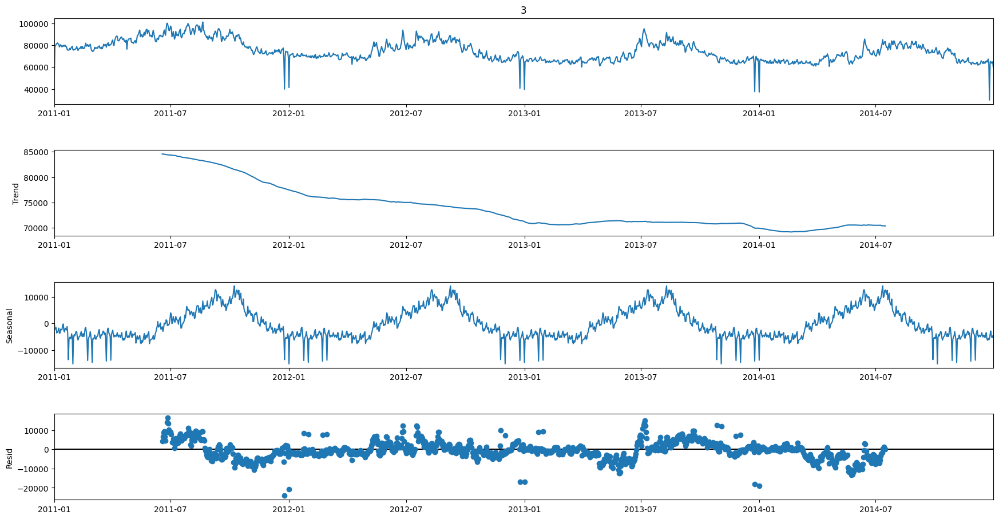

In [34]:
from statsmodels.tsa.seasonal import seasonal_decompose
z = c3.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 336,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

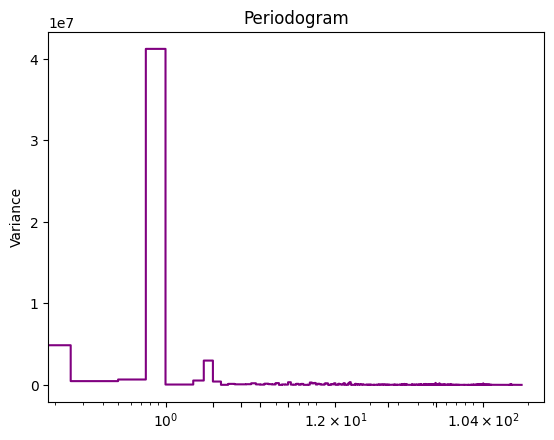

In [35]:
plot_periodogram(c3.values)

In [36]:
fourier = CalendarFourier(freq="A", order=2)
dp = DeterministicProcess(
index= c3.index,
# period = 336,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c3 = pd.concat([c3,dp.in_sample()], axis = 1)

In [37]:
c3.rename(columns={3: 'power_usage'}, inplace = True)

In [38]:
c3['year'] = c3.index.year
c3['dayofyear'] = c3.index.day_of_year

In [39]:
c3.columns

Index(['power_usage', 'const', 'trend', 'sin(1,freq=A-DEC)',
       'cos(1,freq=A-DEC)', 'sin(2,freq=A-DEC)', 'cos(2,freq=A-DEC)', 'year',
       'dayofyear'],
      dtype='object')

## c4

<Figure size 2000x700 with 0 Axes>

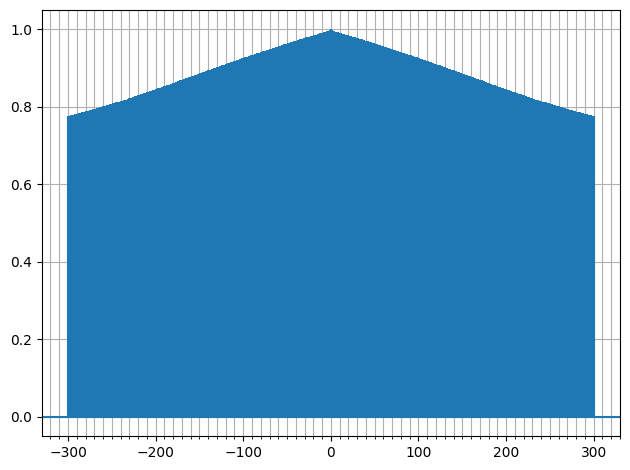

In [40]:
c4 = cluster[4]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c4.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

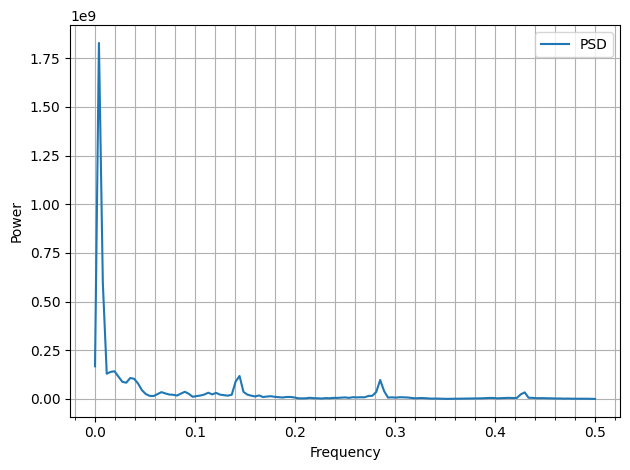

In [41]:
freqs, psd = signal.welch(c4.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

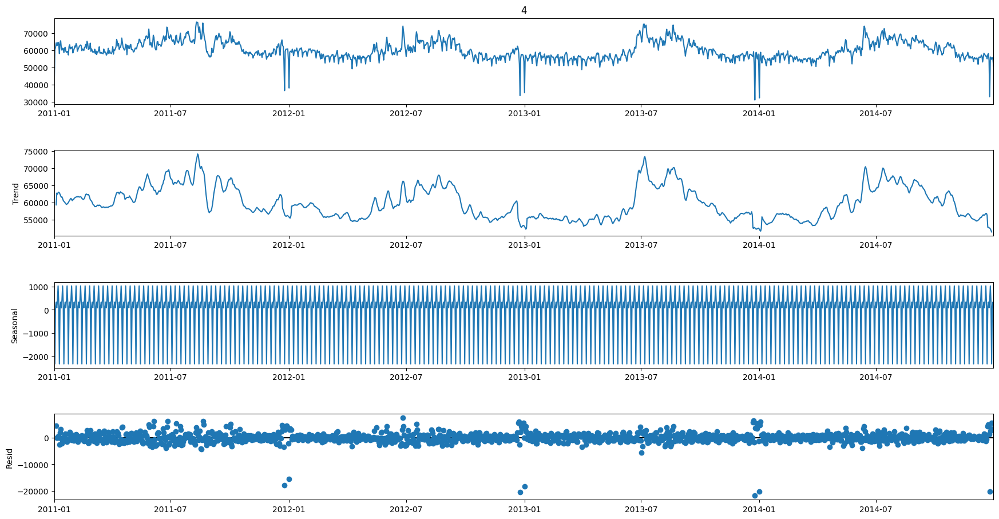

In [42]:
z = c4.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

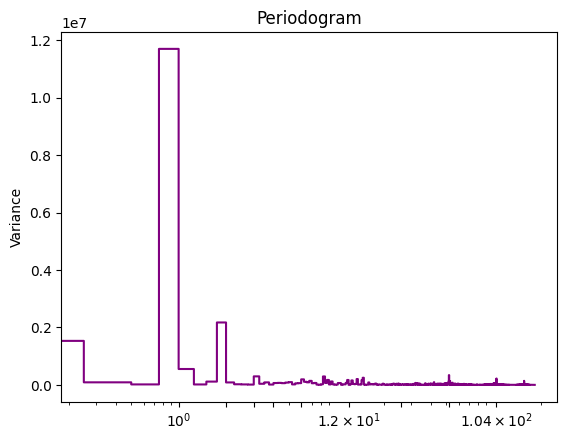

In [43]:
plot_periodogram(c4.values)

In [44]:
fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c4.index,
# period = 336,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c4 = pd.concat([c4,dp.in_sample()], axis = 1)

In [45]:
c4.head()

,4,const,trend,"sin(1,freq=A-DEC)","cos(1,freq=A-DEC)","sin(2,freq=A-DEC)","cos(2,freq=A-DEC)","sin(3,freq=A-DEC)","cos(3,freq=A-DEC)"
2011-01-01,39389.403943,1.0,1.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
2011-01-02,60251.493111,1.0,2.0,0.017213,0.999852,0.034422,0.999407,0.051620,0.998667
2011-01-03,61476.724574,1.0,3.0,0.034422,0.999407,0.068802,0.997630,0.103102,0.994671
2011-01-04,64210.288529,1.0,4.0,0.051620,0.998667,0.103102,0.994671,0.154309,0.988023
2011-01-05,62791.501885,1.0,5.0,0.068802,0.997630,0.137279,0.990532,0.205104,0.978740


In [46]:
c4.rename(columns={4: 'power_usage'}, inplace = True)

In [47]:
c4['year'] = c4.index.year
c4['dayofyear'] = c4.index.day_of_year

## c5

<Figure size 2000x700 with 0 Axes>

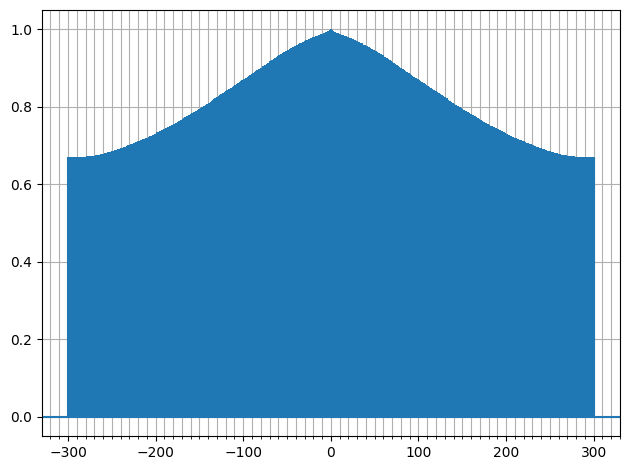

In [48]:
c5 = cluster[5]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c5.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

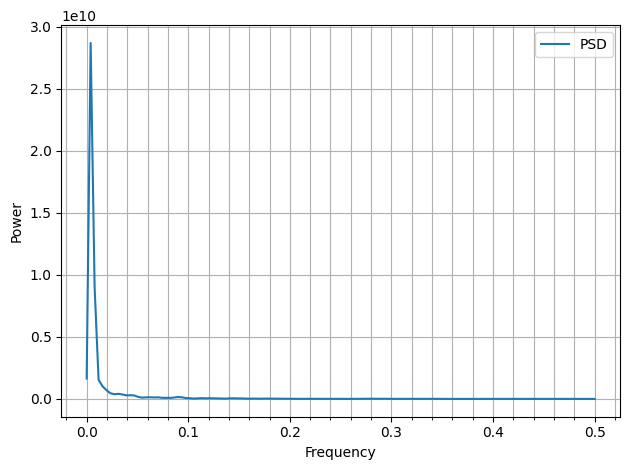

In [49]:
freqs, psd = signal.welch(c5.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

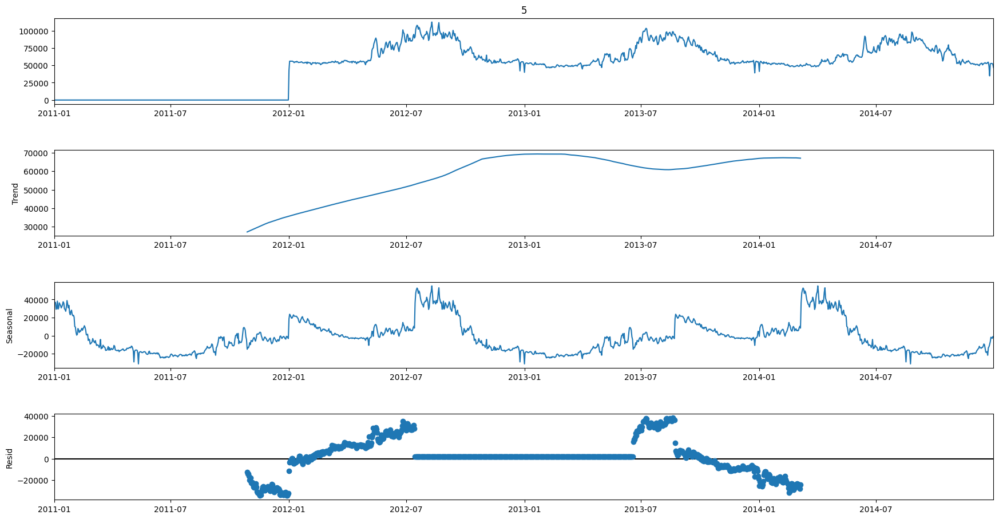

In [50]:
z = c5.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 600, model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

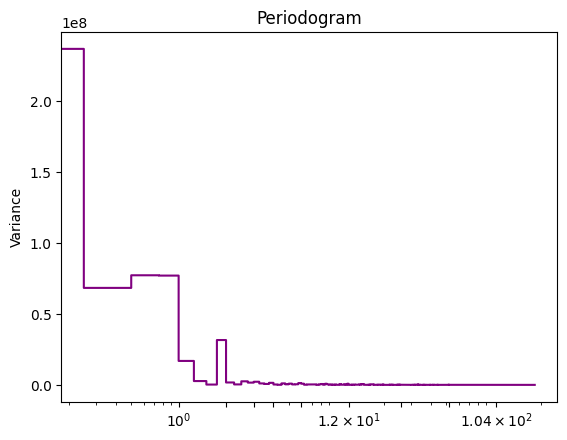

In [51]:
plot_periodogram(c5.values)

In [52]:
fourier = CalendarFourier(freq="A", order=1)
dp = DeterministicProcess(
index= c5.index,
# period = 365,
constant=True,               # dummy feature for bias (y-intercept)
order=0,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c5 = pd.concat([c5,dp.in_sample()], axis = 1)

In [53]:
c5.rename(columns={5: 'power_usage'}, inplace = True)

In [54]:
c5['year'] = c5.index.year
c5['dayofyear'] = c5.index.day_of_year

## c6

<Figure size 2000x700 with 0 Axes>

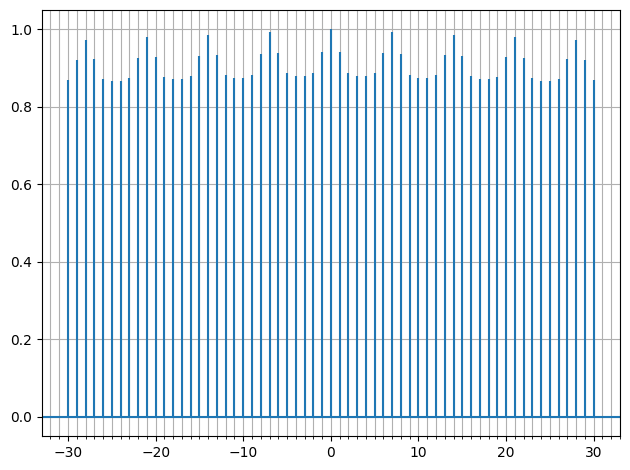

In [55]:
c6 = cluster[6]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c6.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

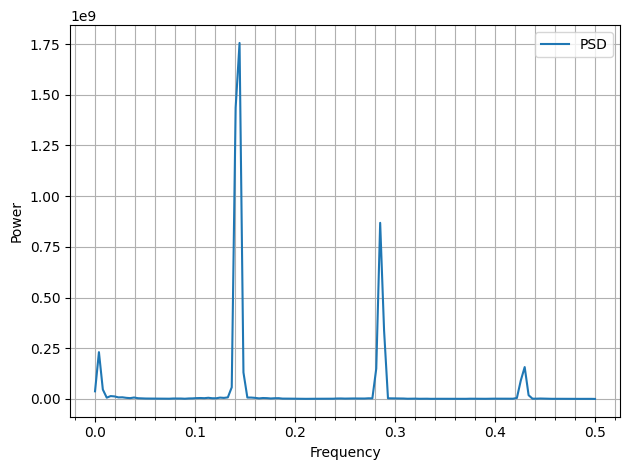

In [56]:
freqs, psd = signal.welch(c6.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

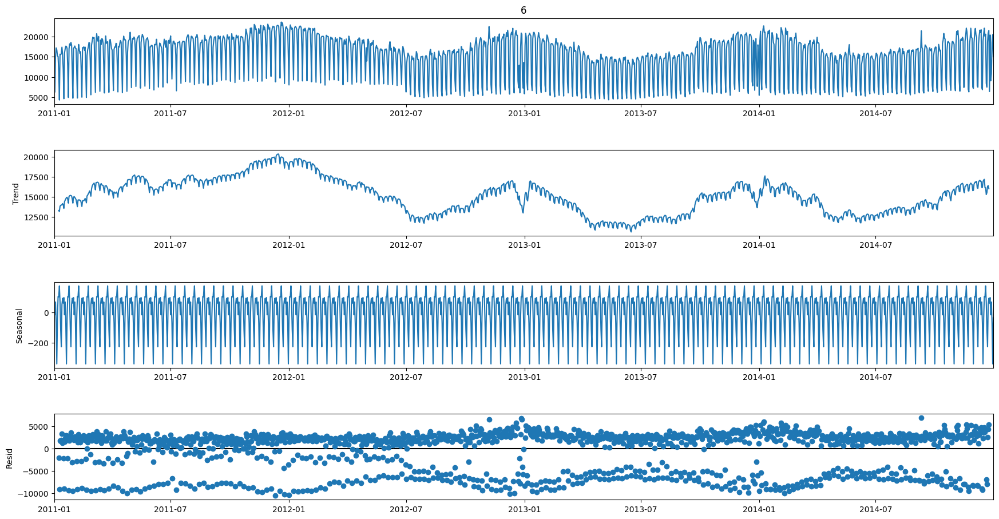

In [57]:
z = c6.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 15, model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

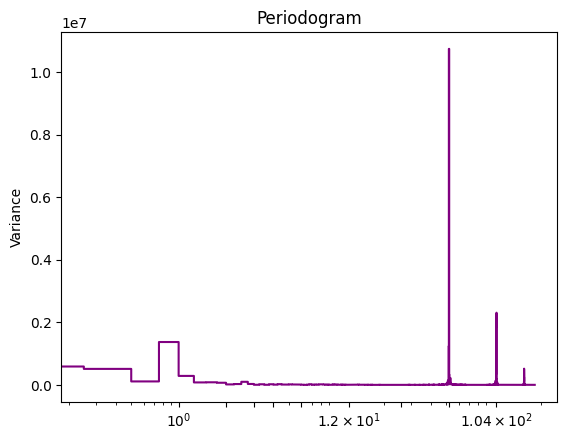

In [58]:
plot_periodogram(c6.values)

In [59]:
fourier = CalendarFourier(freq="A", order=1)
dp = DeterministicProcess(
index= c6.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c6 = pd.concat([c6,dp.in_sample()], axis = 1)

In [60]:
c6.rename(columns={6: 'power_usage'}, inplace = True)

In [61]:
c6['week'] = c6.index.week

In [62]:
c6['month'] = c6.index.month

In [63]:
c6['quarter'] = c6.index.quarter

In [64]:
c6

,power_usage,const,trend,"s(2,7)","s(3,7)","s(4,7)","s(5,7)","s(6,7)","s(7,7)","sin(1,freq=A-DEC)","cos(1,freq=A-DEC)",week,month,quarter
2011-01-01,6326.966479,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,52,1,1
2011-01-02,6298.691631,1.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.017213,0.999852,52,1,1
2011-01-03,15174.066695,1.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.034422,0.999407,1,1,1
2011-01-04,17206.472871,1.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.051620,0.998667,1,1,1
2011-01-05,16723.909272,1.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,0.068802,0.997630,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-27,9077.387688,1.0,1457.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.085965,0.996298,52,12,4
2014-12-28,10892.474484,1.0,1458.0,1.0,0.0,0.0,0.0,0.0,0.0,-0.068802,0.997630,52,12,4
2014-12-29,18584.851580,1.0,1459.0,0.0,1.0,0.0,0.0,0.0,0.0,-0.051620,0.998667,1,12,4
2014-12-30,20471.627963,1.0,1460.0,0.0,0.0,1.0,0.0,0.0,0.0,-0.034422,0.999407,1,12,4


In [65]:
c6['year'] = c6.index.year
c6['dayofyear'] = c6.index.day_of_year

## c7

<Figure size 2000x700 with 0 Axes>

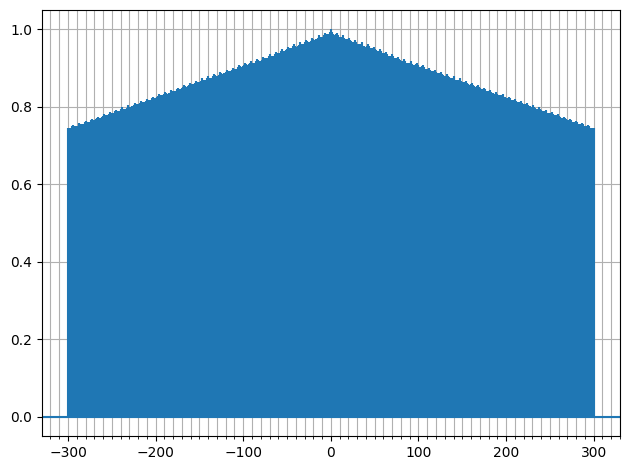

In [66]:
c7 = cluster[7]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c7.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

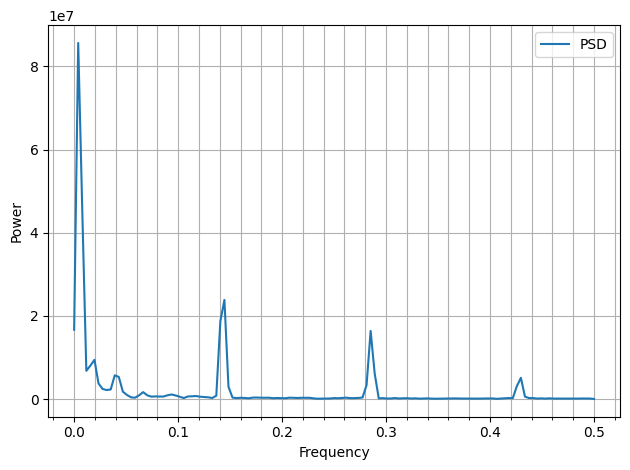

In [67]:
freqs, psd = signal.welch(c7.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

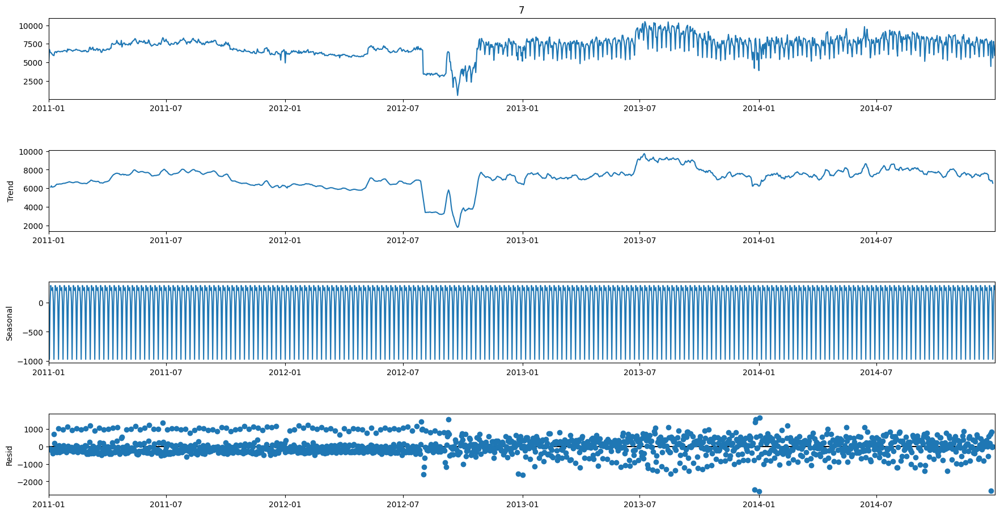

In [68]:
z = c7.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z, model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

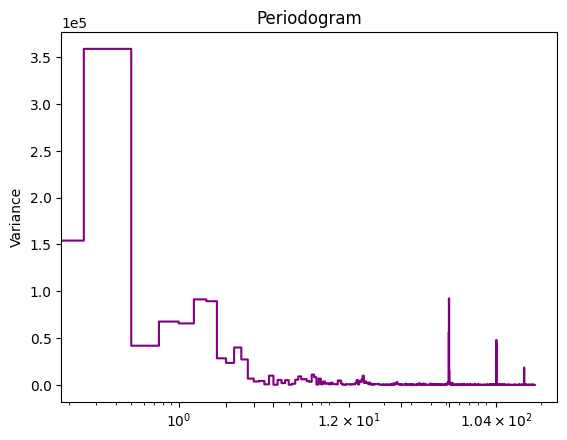

In [69]:
plot_periodogram(c7.values)

In [70]:
fourier = CalendarFourier(freq="A", order=6)
dp = DeterministicProcess(
index= c7.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c7 = pd.concat([c7,dp.in_sample()], axis = 1)

In [71]:
c7.rename(columns={7: 'power_usage'}, inplace = True)

In [72]:
c7['week'] = c7.index.week
c7['quarter'] = c7.index.quarter
c7['month'] = c7.index.month

## c8

<Figure size 2000x700 with 0 Axes>

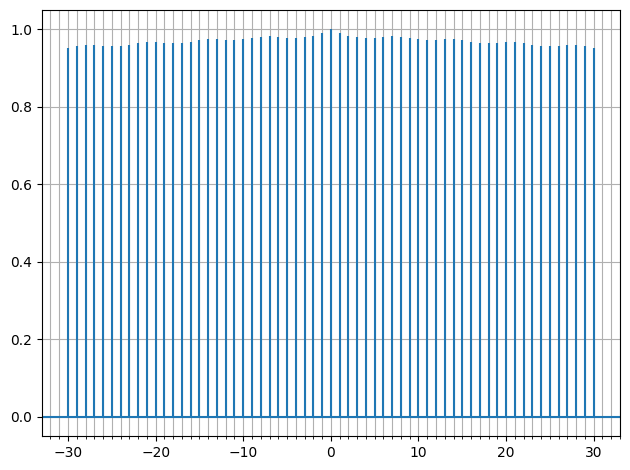

In [73]:
c8 = cluster[8]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c8.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

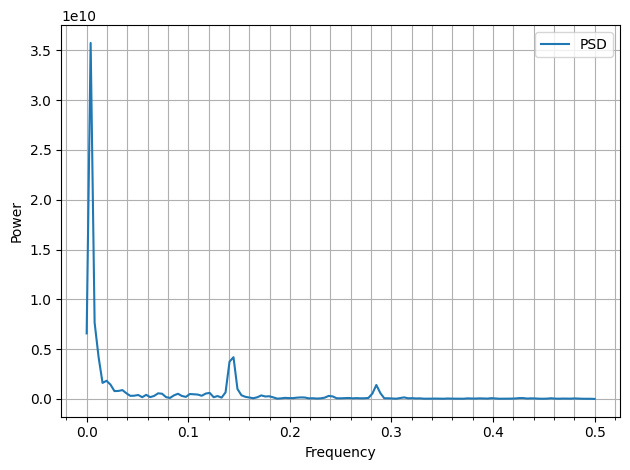

In [74]:
freqs, psd = signal.welch(c8.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

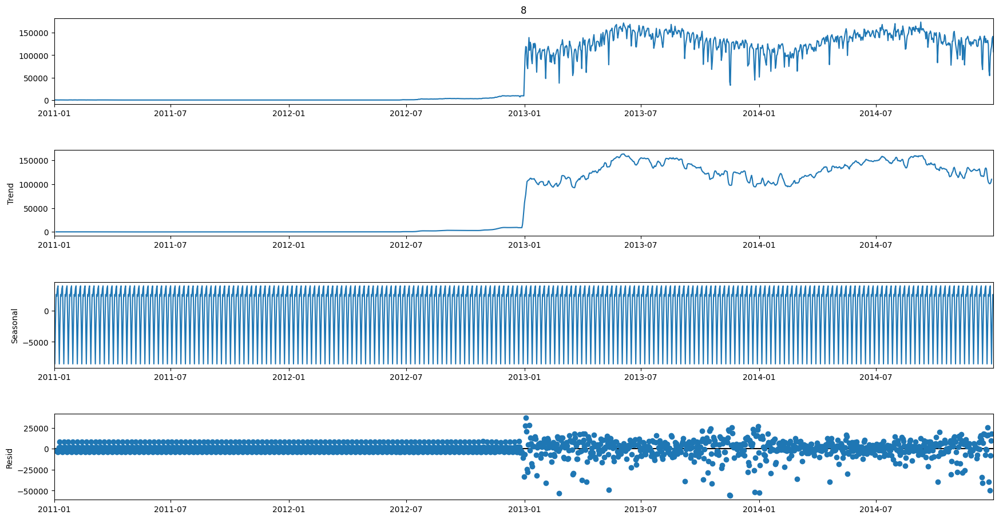

In [75]:
z = c8.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z, model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

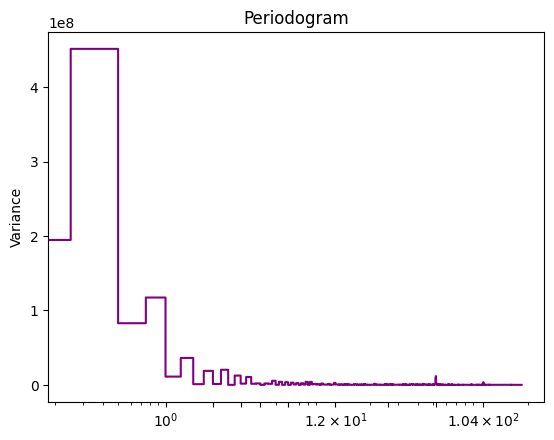

In [76]:
plot_periodogram(c8.values)

In [77]:
fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c8.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=0,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c8 = pd.concat([c8,dp.in_sample()], axis = 1)

In [78]:
c8.rename(columns={8: 'power_usage'}, inplace = True)

In [79]:
c8['year'] = c8.index.year
c8['dayofyear'] = c8.index.day_of_year

## c9

<Figure size 2000x700 with 0 Axes>

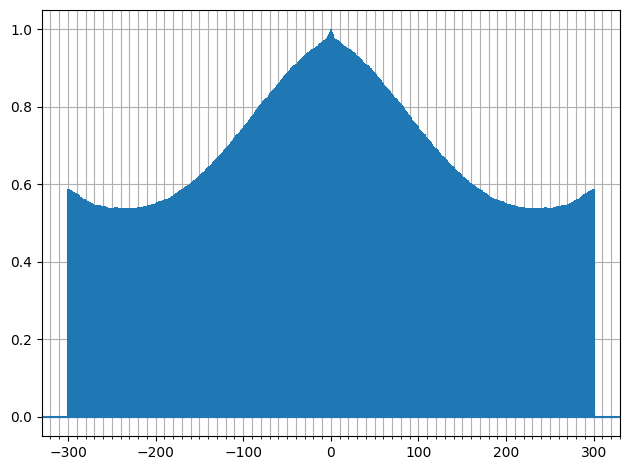

In [80]:
c9= cluster[9]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c9.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

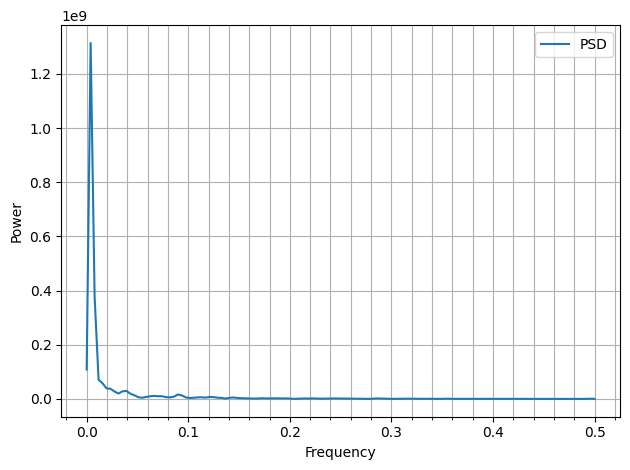

In [81]:
freqs, psd = signal.welch(c9.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

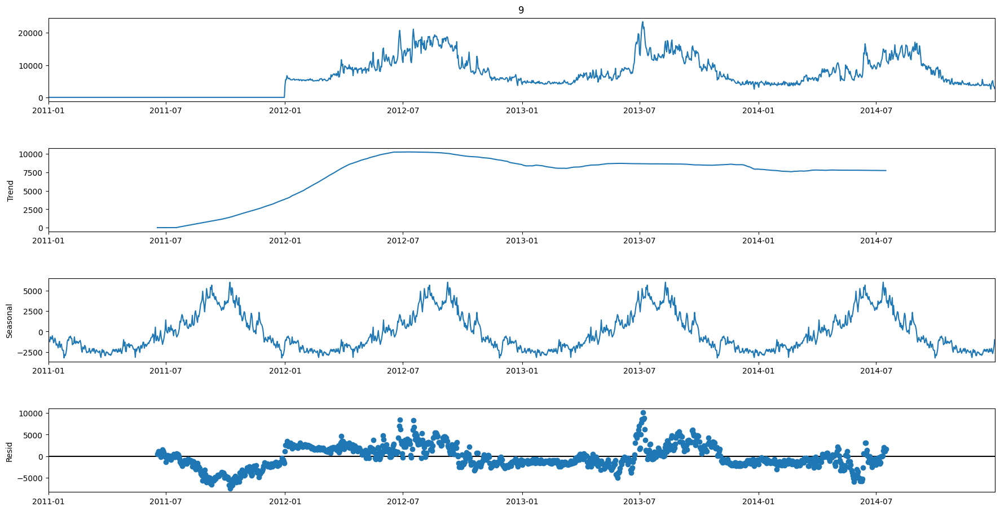

In [82]:
z = c9.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z, period = 336,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

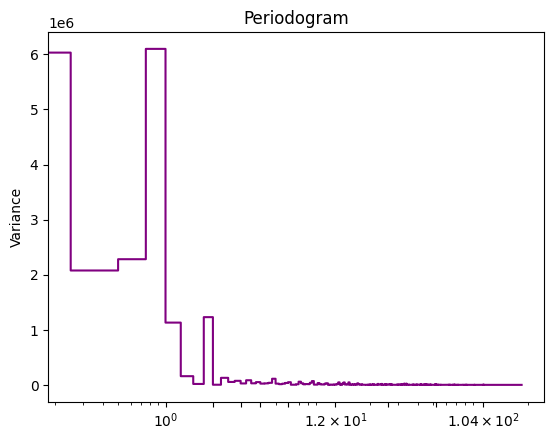

In [83]:
plot_periodogram(c9.values)

In [84]:
fourier = CalendarFourier(freq="A", order=4)
dp = DeterministicProcess(
index= c9.index,
# period = 336,
constant=True,               # dummy feature for bias (y-intercept)
order=0,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c9 = pd.concat([c9,dp.in_sample()], axis = 1)

In [85]:
c9.rename(columns={9: 'power_usage'}, inplace = True)

In [86]:
c9['year'] = c9.index.year
c9['dayofyear'] = c9.index.day_of_year

## c10

<Figure size 2000x700 with 0 Axes>

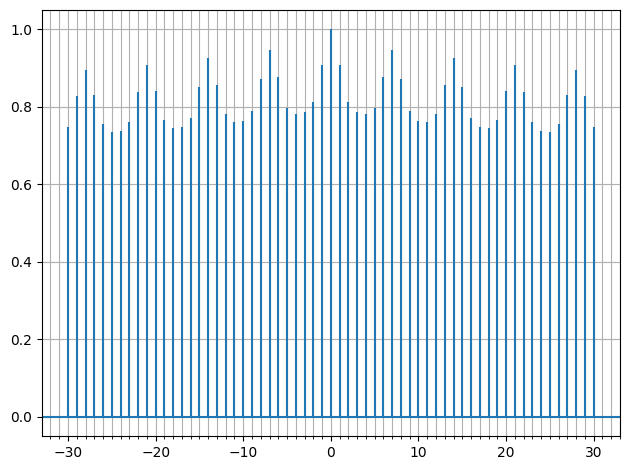

In [87]:
c10= cluster[10]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c10.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

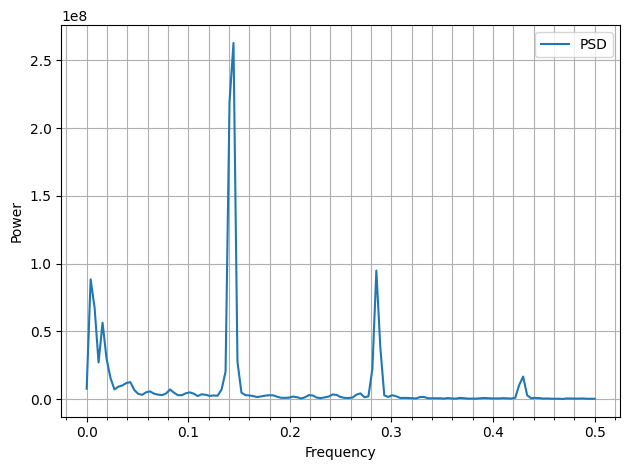

In [88]:
freqs, psd = signal.welch(c10.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

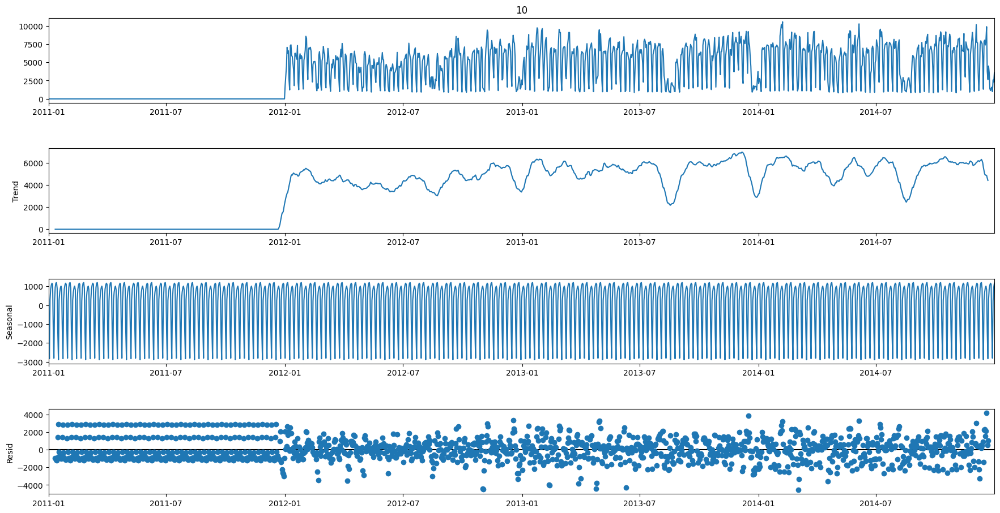

In [89]:
z = c10.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period = 21,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

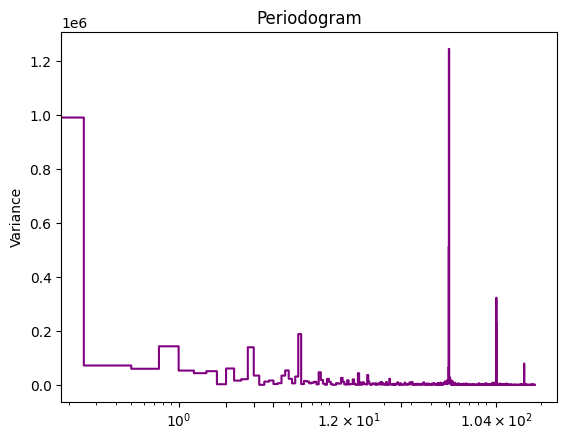

In [90]:
plot_periodogram(c10.values)

In [91]:
fourier = CalendarFourier(freq="A", order=6)
dp = DeterministicProcess(
index= c10.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=0,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c10 = pd.concat([c10,dp.in_sample()], axis = 1)

In [92]:
c10['week'] = c10.index.week
c10['quarter'] = c10.index.quarter
c10['month'] = c10.index.month

In [93]:
c10.rename(columns={10: 'power_usage'}, inplace = True)

In [94]:
c10['year'] = c10.index.year
c10['dayofyear'] = c10.index.day_of_year

## c11

<Figure size 2000x700 with 0 Axes>

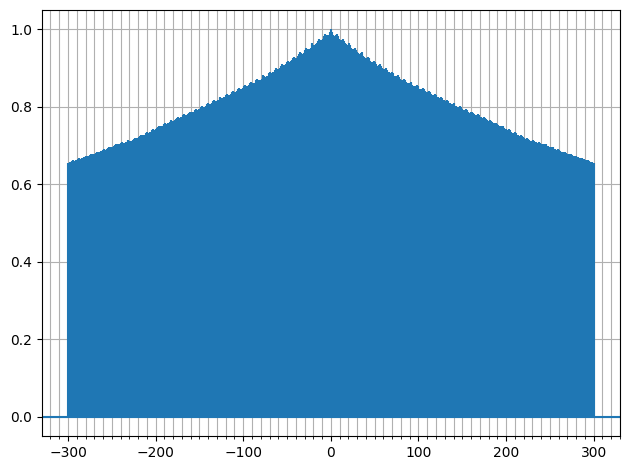

In [95]:
c11= cluster[11]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c11.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

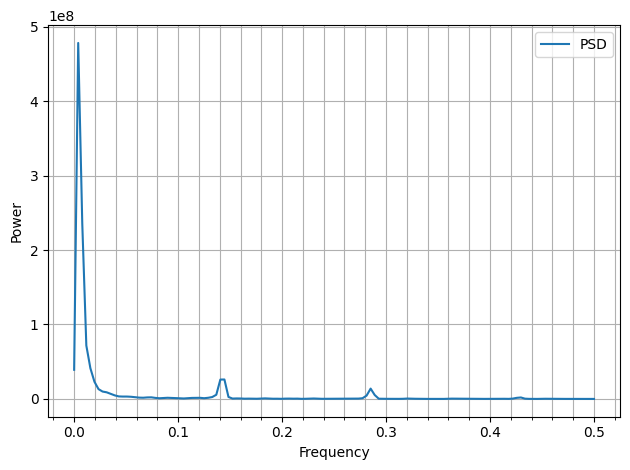

In [96]:
freqs, psd = signal.welch(c11.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

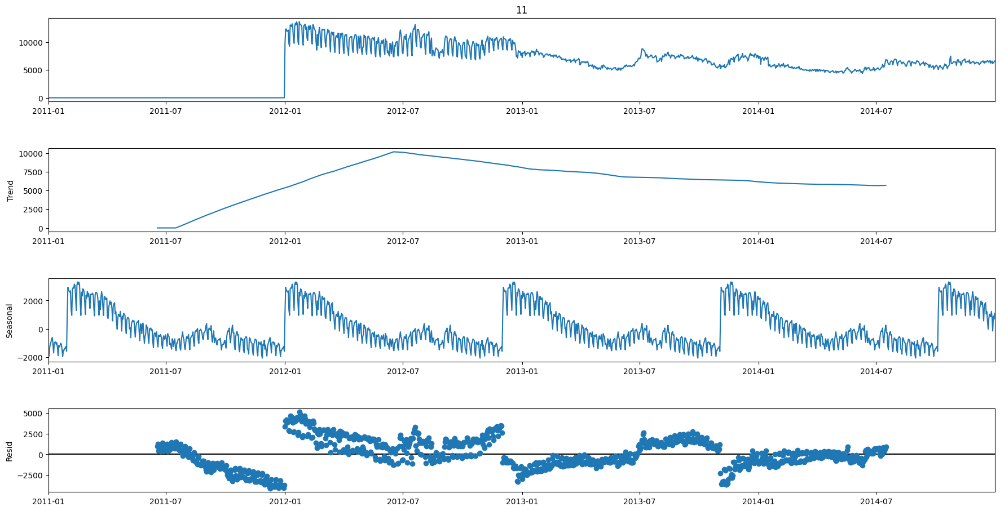

In [97]:
z = c11.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period=336,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

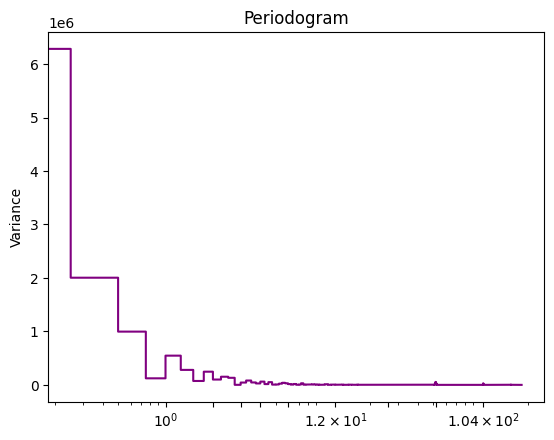

In [98]:
plot_periodogram(c11.values)

In [99]:
fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c11.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c11 = pd.concat([c11,dp.in_sample()], axis = 1)

In [100]:
c11['dayofyear'] = c11.index.day_of_year

In [101]:
c11.rename(columns={11: 'power_usage'}, inplace = True)

## c12

<Figure size 2000x700 with 0 Axes>

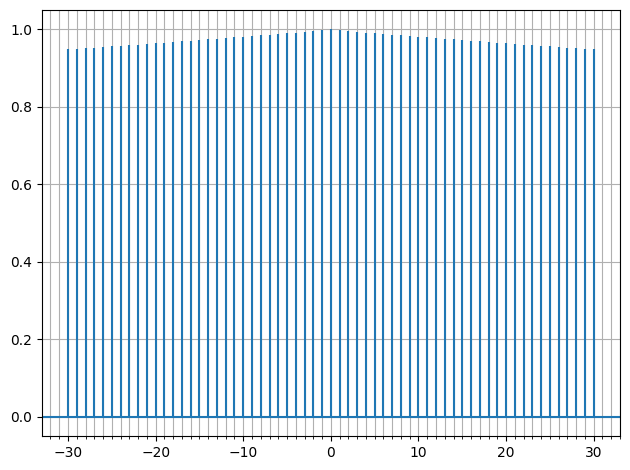

In [102]:
c12= cluster[12]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c12.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

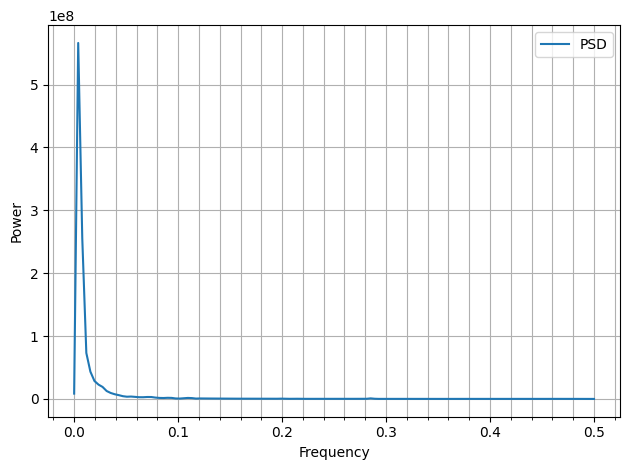

In [103]:
freqs, psd = signal.welch(c12.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

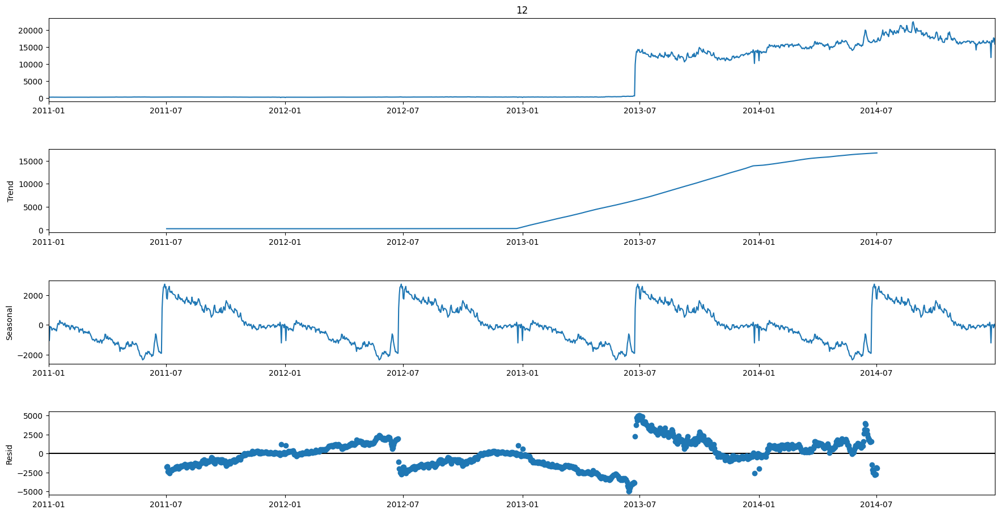

In [104]:
z = c12.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period=365,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

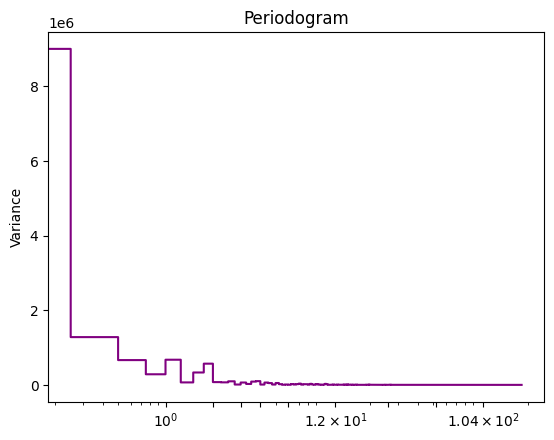

In [105]:
plot_periodogram(c12.values)

In [106]:
fourier = CalendarFourier(freq="A", order=1)
dp = DeterministicProcess(
index= c12.index,
# period = 365,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c12 = pd.concat([c12,dp.in_sample()], axis = 1)

In [107]:
c12.rename(columns={12: 'power_usage'}, inplace = True)

In [108]:
c12['year'] = c12.index.year
c12['dayofyear'] = c12.index.day_of_year

## c13

<Figure size 2000x700 with 0 Axes>

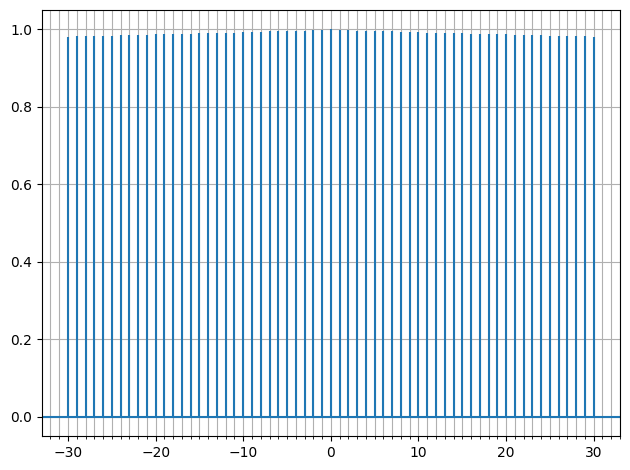

In [109]:
c13= cluster[13]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c13.values, maxlags = 30)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

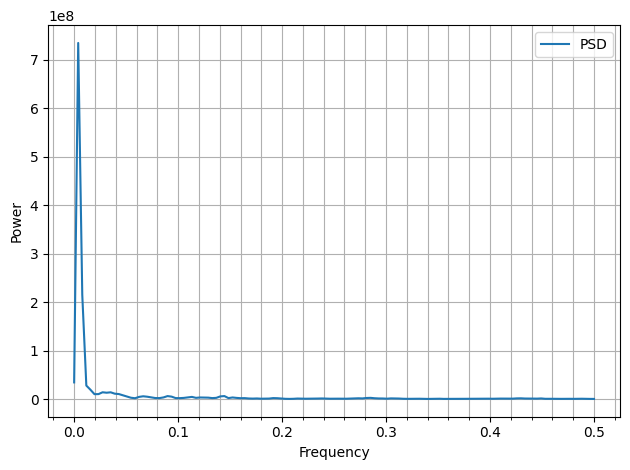

In [110]:
freqs, psd = signal.welch(c13.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

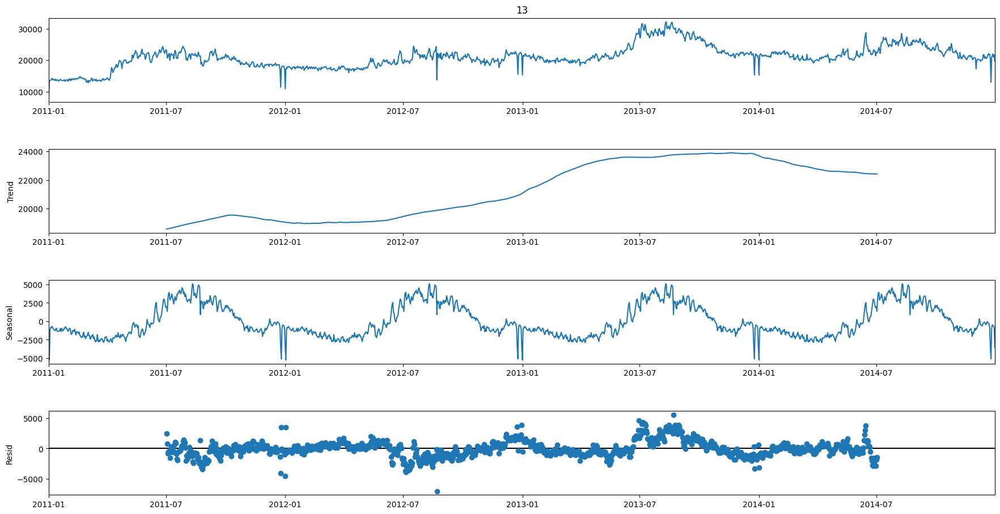

In [111]:
z = c13.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period=365,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

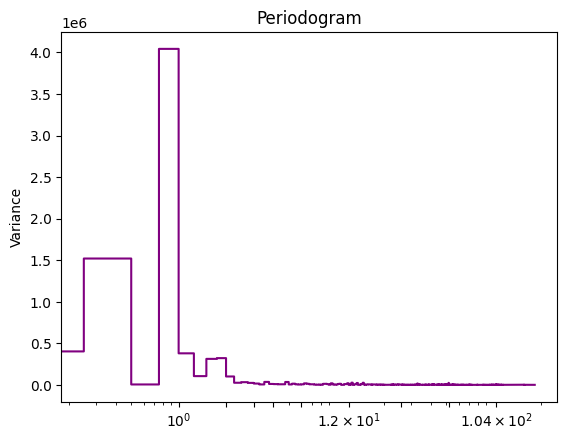

In [112]:
plot_periodogram(c13.values)

In [113]:
fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c13.index,
# period = 365,
constant=True,               # dummy feature for bias (y-intercept)
order=3,
seasonal=False,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c13 = pd.concat([c13,dp.in_sample()], axis = 1)

In [114]:
c13.rename(columns={13: 'power_usage'}, inplace = True)

In [115]:
c10['year'] = c10.index.year
c10['dayofyear'] = c10.index.day_of_year

## c14

<Figure size 2000x700 with 0 Axes>

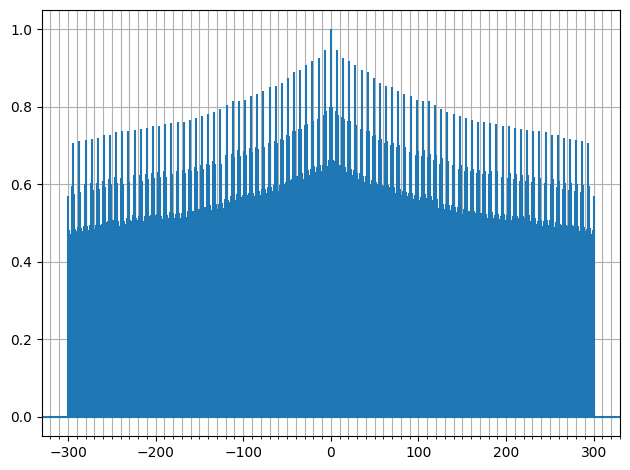

In [116]:
c14= cluster[14]
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.acorr(c14.values, maxlags = 300)
minor_locator = AutoMinorLocator(10)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
# plt.legend(['$R_X$(\u03C4)'],loc='upper left')
# plt.xlabel('\u03C4')
# plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

<Figure size 2000x700 with 0 Axes>

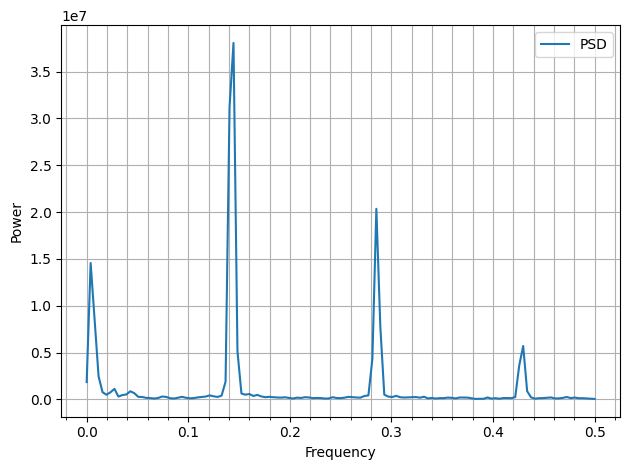

In [117]:
freqs, psd = signal.welch(c14.values)
plt.figure(figsize=(20, 7))
fig, ax = plt.subplots()
ax.plot(freqs, psd)
minor_locator = AutoMinorLocator(5)
ax.xaxis.set_minor_locator(minor_locator)
plt.grid(which='minor')
plt.legend(['PSD'])
plt.xlabel('Frequency')
plt.ylabel('Power')
ax.grid(True, which='both')
plt.tight_layout()
fig.show()

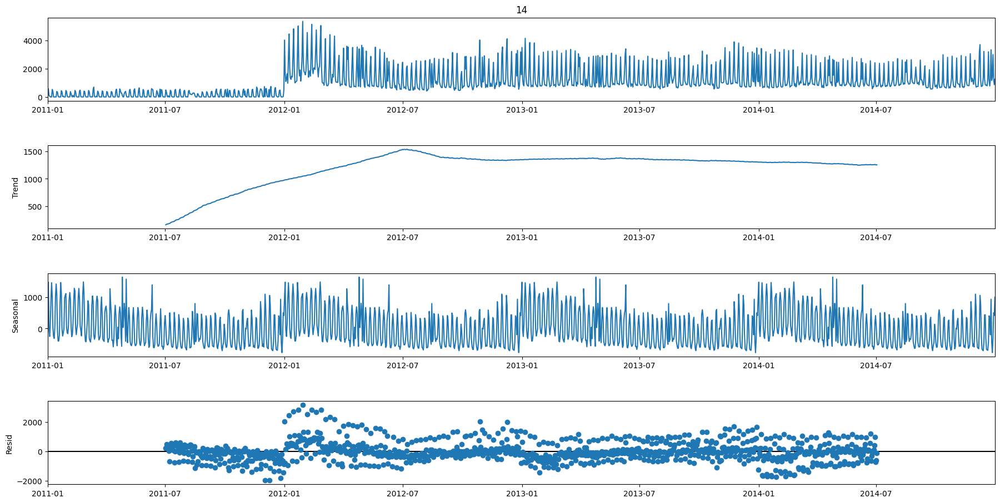

In [118]:
z = c14.copy()
# z = z.reset_index(drop = True)
decomp = seasonal_decompose(z,period=365,model ='Additive')
fig = decomp.plot()
fig.set_size_inches(20,10)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

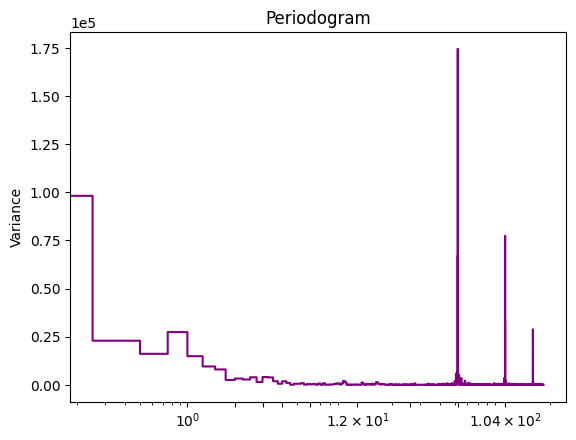

In [119]:
plot_periodogram(c14.values)

In [120]:
fourier = CalendarFourier(freq="A", order=3)
dp = DeterministicProcess(
index= c14.index,
period = 7,
constant=True,               # dummy feature for bias (y-intercept)
order=1,
seasonal=True,
additional_terms=[fourier],  # annual seasonality (fourier)
drop=True,                   # drop terms to avoid collinearity
)
c14 = pd.concat([c14,dp.in_sample()], axis = 1)

In [121]:
c14.rename(columns={14: 'power_usage'}, inplace = True)

In [122]:
c14['week'] = c14.index.week
c14['quarter'] = c14.index.quarter
c14['month'] = c14.index.month

In [123]:
c14['year'] = c14.index.year
c14['dayofyear'] = c14.index.day_of_year

In [124]:
cluster.columns

Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], dtype='int64', name='Cluster')

# Adding lag features

In [125]:
from pathlib import Path
from warnings import simplefilter

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.signal import periodogram
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from statsmodels.graphics.tsaplots import plot_pacf

def lagplot(x, y=None, lag=1, standardize=False, ax=None, **kwargs):
    from matplotlib.offsetbox import AnchoredText
    x_ = x.shift(lag)
    if standardize:
        x_ = (x_ - x_.mean()) / x_.std()
    if y is not None:
        y_ = (y - y.mean()) / y.std() if standardize else y
    else:
        y_ = x
    corr = y_.corr(x_)
    if ax is None:
        fig, ax = plt.subplots()
    scatter_kws = dict(
        alpha=0.75,
        s=3,
    )
    line_kws = dict(color='C3', )
    ax = sns.regplot(x=x_,
                     y=y_,
                     scatter_kws=scatter_kws,
                     line_kws=line_kws,
                     lowess=True,
                     ax=ax,
                     **kwargs)
    at = AnchoredText(
        f"{corr:.2f}",
        prop=dict(size="large"),
        frameon=True,
        loc="upper left",
    )
    at.patch.set_boxstyle("square, pad=0.0")
    ax.add_artist(at)
    ax.set(title=f"Lag {lag}", xlabel=x_.name, ylabel=y_.name)
    return ax

def plot_lags(x, y=None, lags=6, nrows=1, lagplot_kwargs={}, **kwargs):
    import math
    kwargs.setdefault('nrows', nrows)
    kwargs.setdefault('ncols', math.ceil(lags / nrows))
    kwargs.setdefault('figsize', (kwargs['ncols'] * 2, nrows * 2 + 0.5))
    fig, axs = plt.subplots(sharex=True, sharey=True, squeeze=False, **kwargs)
    for ax, k in zip(fig.get_axes(), range(kwargs['nrows'] * kwargs['ncols'])):
        if k + 1 <= lags:
            ax = lagplot(x, y, lag=k + 1, ax=ax, **lagplot_kwargs)
            ax.set_title(f"Lag {k + 1}", fontdict=dict(fontsize=14))
            ax.set(xlabel="", ylabel="")
        else:
            ax.axis('off')
    plt.setp(axs[-1, :], xlabel=x.name)
    plt.setp(axs[:, 0], ylabel=y.name if y is not None else x.name)
    fig.tight_layout(w_pad=0.1, h_pad=0.1)
    return fig

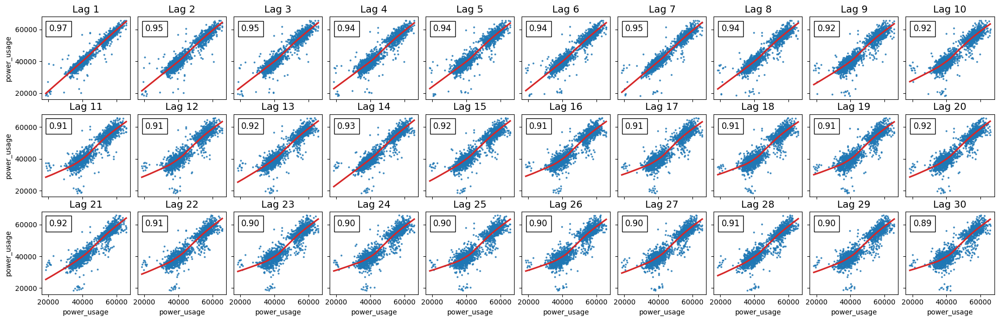

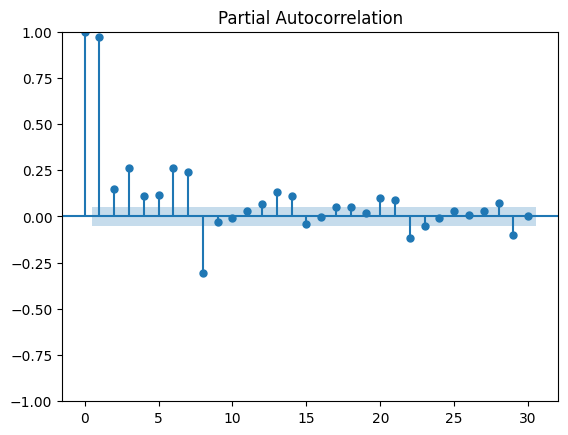

In [126]:
_ = plot_lags(c1.power_usage, lags=30, nrows=3)
_ = plot_pacf(c1.power_usage, lags=30)

In [127]:
for j in range(1, 9):
    c1["lag_{}".format(j)] = c1.power_usage.shift(j)

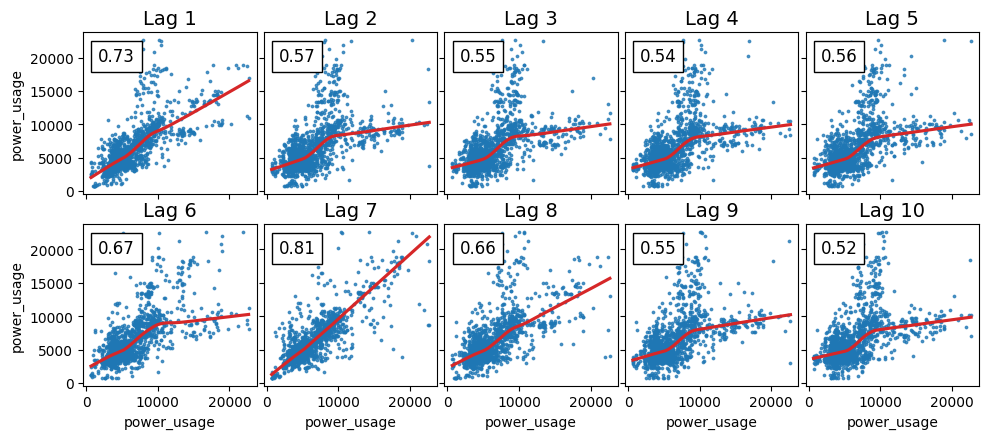

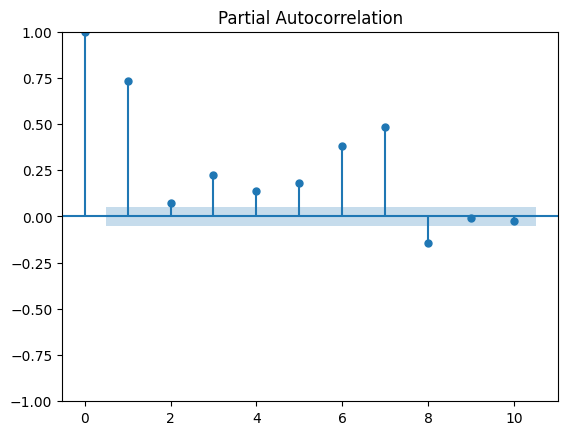

In [128]:
_ = plot_lags(c2.power_usage, lags=10, nrows=2)
_ = plot_pacf(c2.power_usage, lags=10)

In [129]:
for j in range(1, 8):
    c2["lag_{}".format(j)] = c2.power_usage.shift(j)

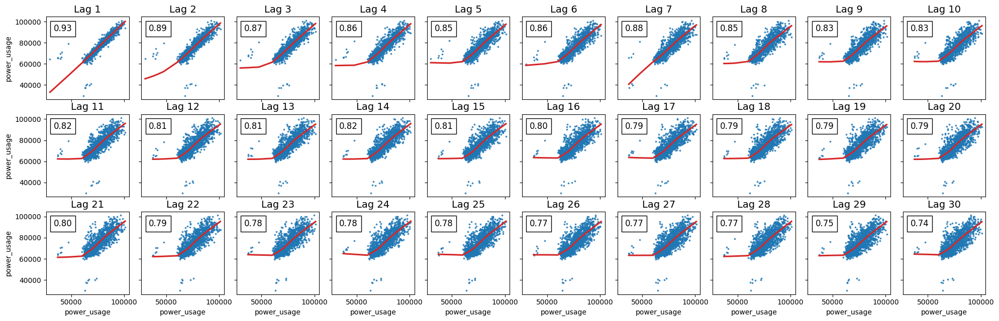

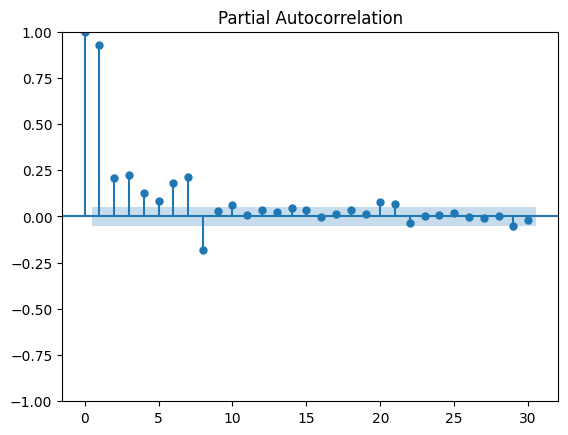

In [130]:
_ = plot_lags(c3.power_usage, lags=30, nrows=3)
_ = plot_pacf(c3.power_usage, lags=30)

In [131]:
for j in range(1, 9):
    c3["lag_{}".format(j)] = c3.power_usage.shift(j)

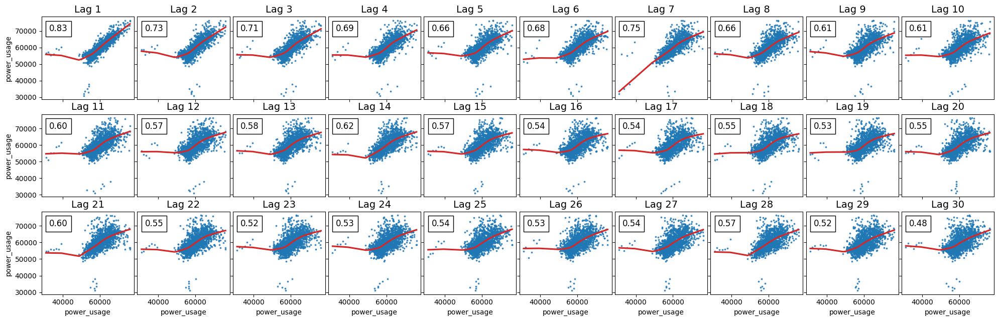

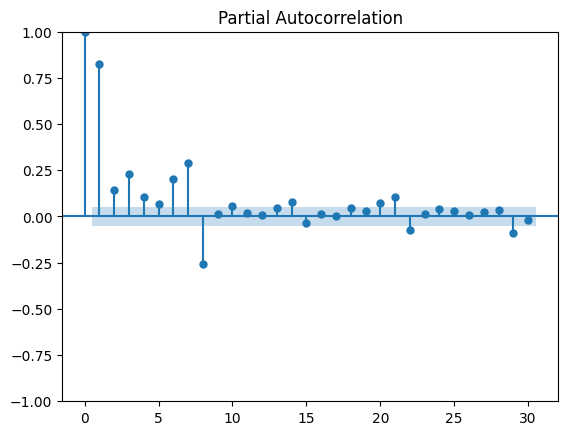

In [132]:
_ = plot_lags(c4.power_usage, lags=30, nrows=3)
_ = plot_pacf(c4.power_usage, lags=30)

In [133]:
for j in range(1, 9):
    c4["lag_{}".format(j)] = c4.power_usage.shift(j)

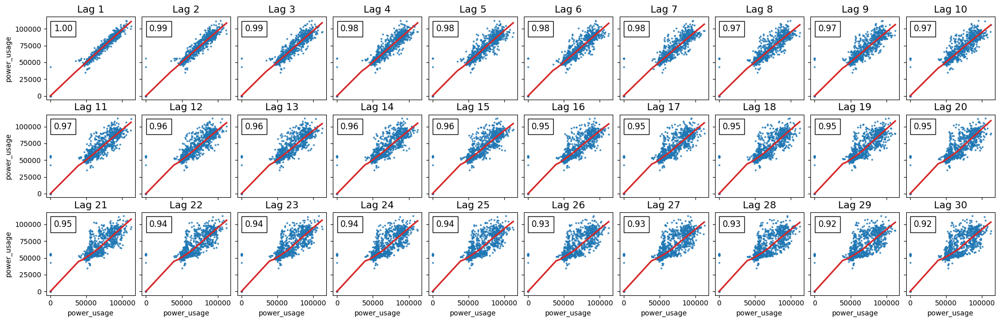

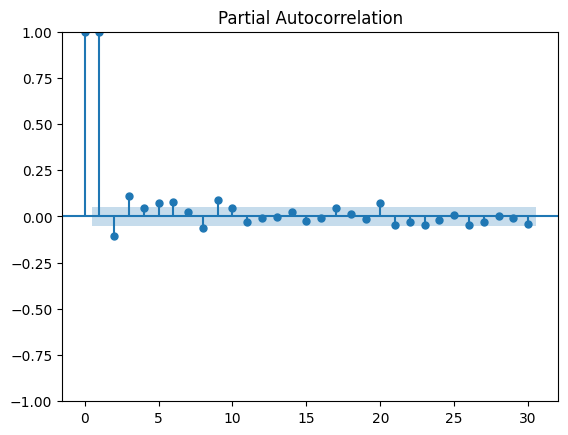

In [134]:
_ = plot_lags(c5.power_usage, lags=30, nrows=3)
_ = plot_pacf(c5.power_usage, lags=30)

In [135]:
for j in range(1, 4):
    c5["lag_{}".format(j)] = c5.power_usage.shift(j)

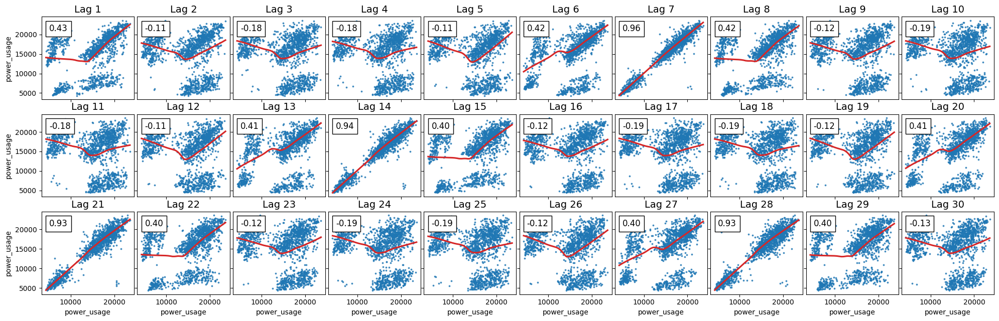

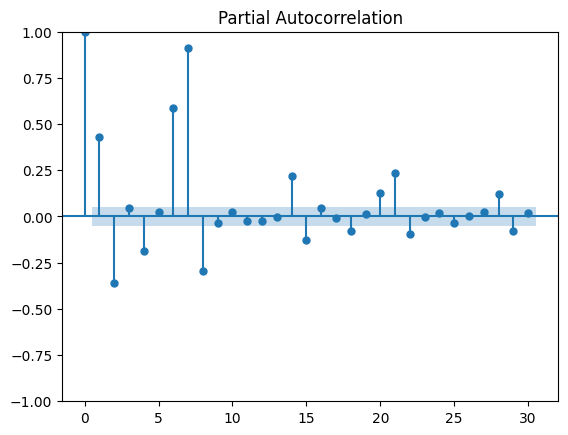

In [136]:
_ = plot_lags(c6.power_usage, lags=30, nrows=3)
_ = plot_pacf(c6.power_usage, lags=30)

In [137]:
for j in range(1, 9):
    c6["lag_{}".format(j)] = c6.power_usage.shift(j)

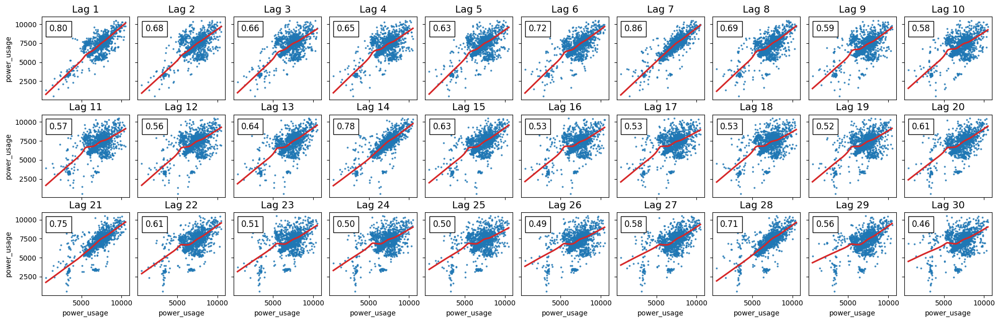

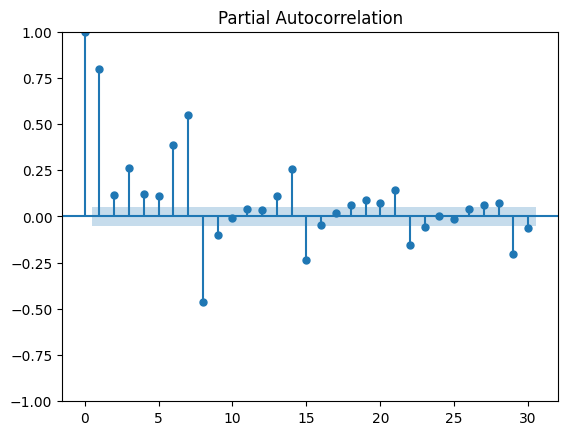

In [138]:
_ = plot_lags(c7.power_usage, lags=30, nrows=3)
_ = plot_pacf(c7.power_usage, lags=30)

In [139]:
for j in range(1, 9):
    c7["lag_{}".format(j)] = c7.power_usage.shift(j)

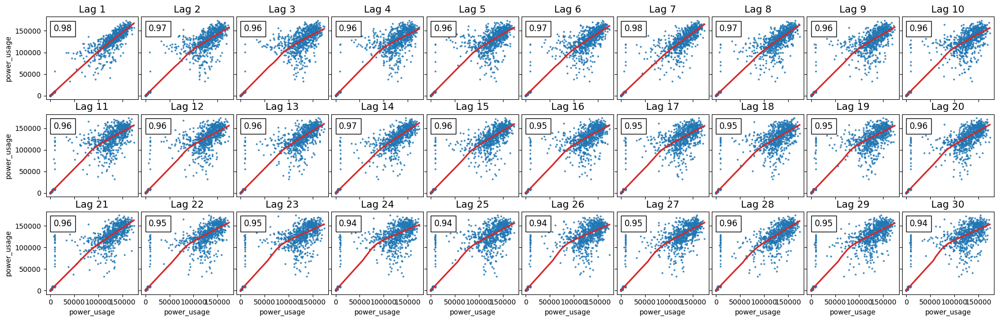

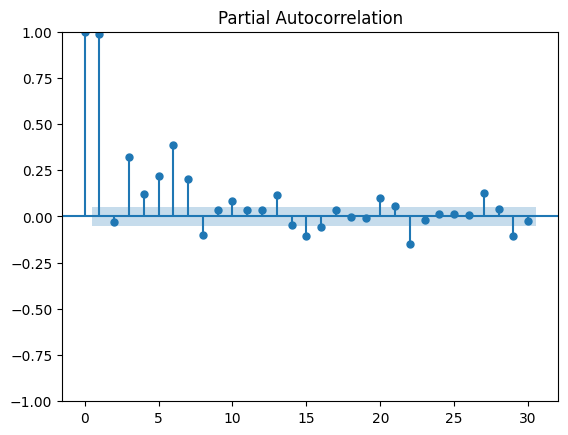

In [140]:
_ = plot_lags(c8.power_usage, lags=30, nrows=3)
_ = plot_pacf(c8.power_usage, lags=30)

In [141]:
for j in range(1, 8):
    c8["lag_{}".format(j)] = c8.power_usage.shift(j)

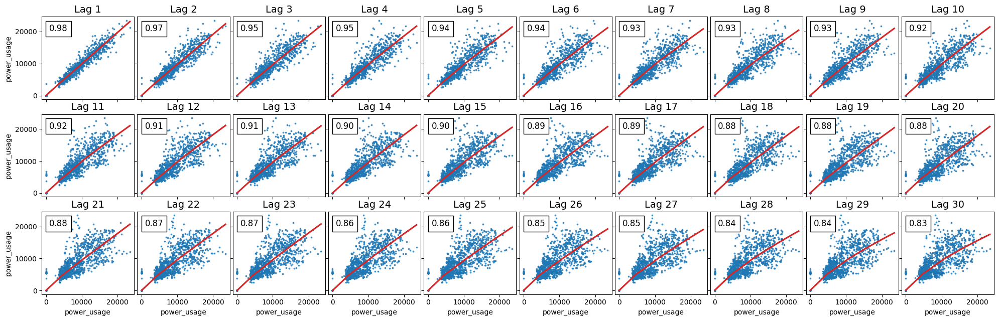

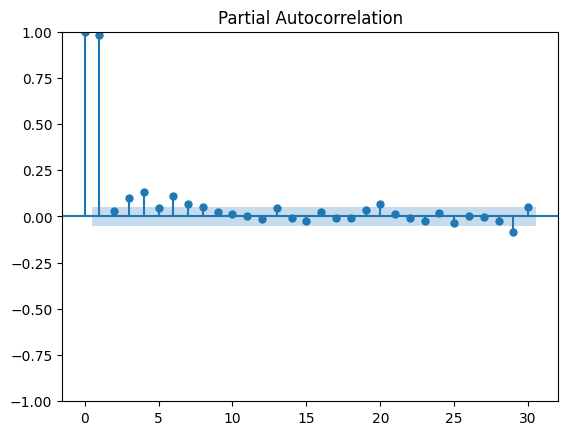

In [142]:
_ = plot_lags(c9.power_usage, lags=30, nrows=3)
_ = plot_pacf(c9.power_usage, lags=30)

In [143]:
for j in range(1, 5):
    c9["lag_{}".format(j)] = c9.power_usage.shift(j)

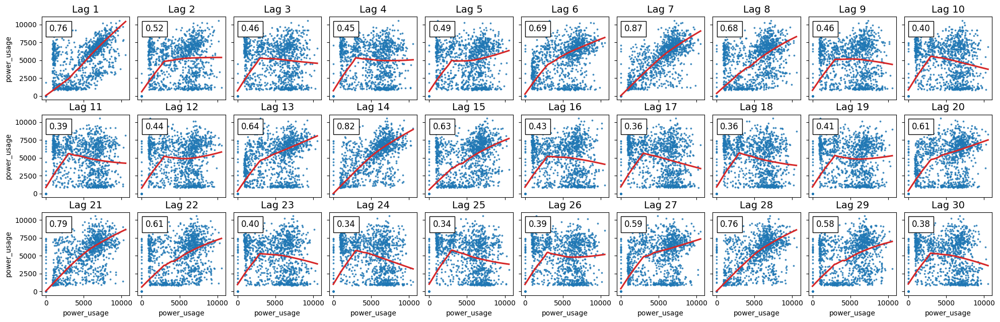

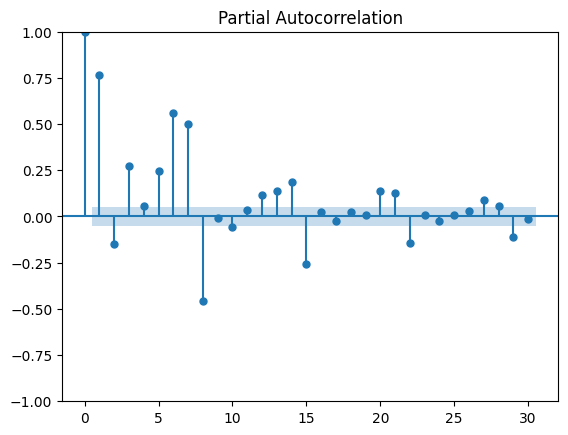

In [144]:
_ = plot_lags(c10.power_usage, lags=30, nrows=3)
_ = plot_pacf(c10.power_usage, lags=30)

In [145]:
for j in range(1, 9):
    c10["lag_{}".format(j)] = c10.power_usage.shift(j)

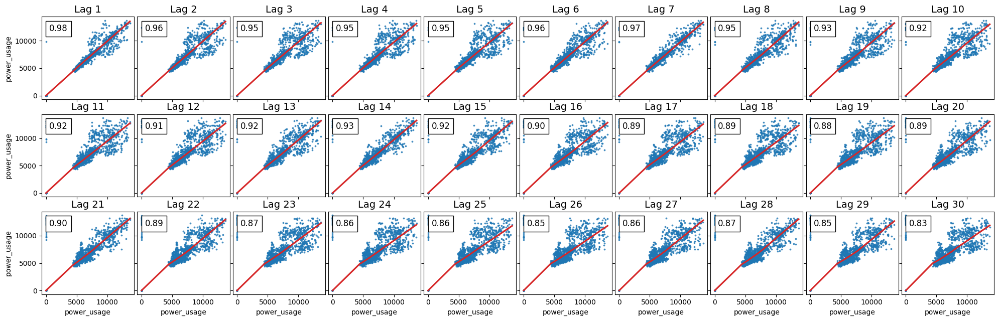

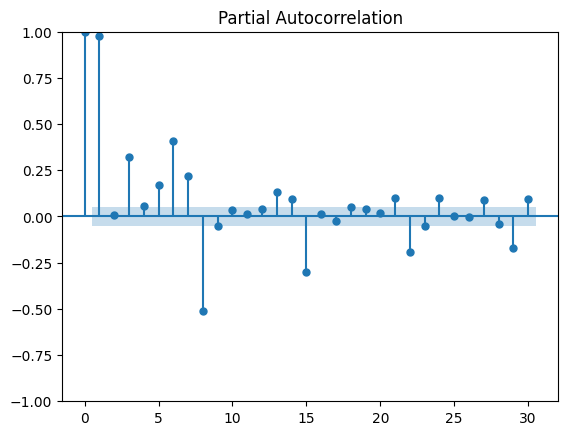

In [146]:
_ = plot_lags(c11.power_usage, lags=30, nrows=3)
_ = plot_pacf(c11.power_usage, lags=30)

In [147]:
for j in range(1, 9):
    c11["lag_{}".format(j)] = c11.power_usage.shift(j)

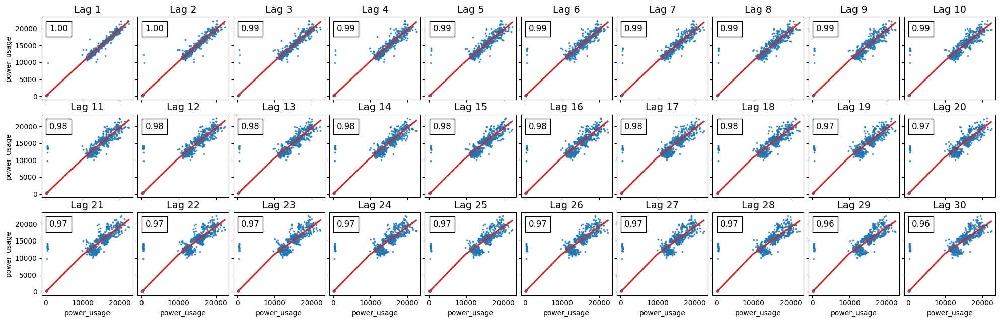

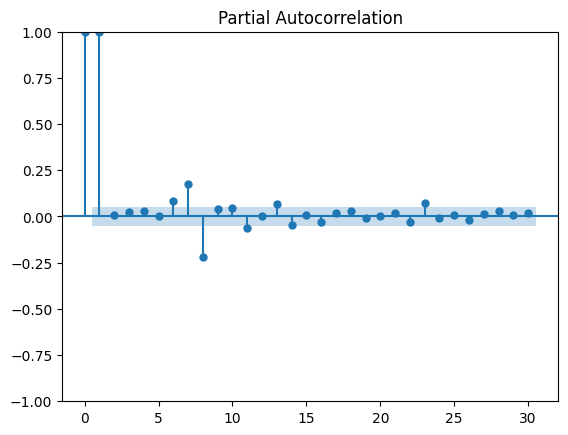

In [148]:
_ = plot_lags(c12.power_usage, lags=30, nrows=3)
_ = plot_pacf(c12.power_usage, lags=30)

In [149]:
for j in range(1, 2):
    c12["lag_{}".format(j)] = c12.power_usage.shift(j)

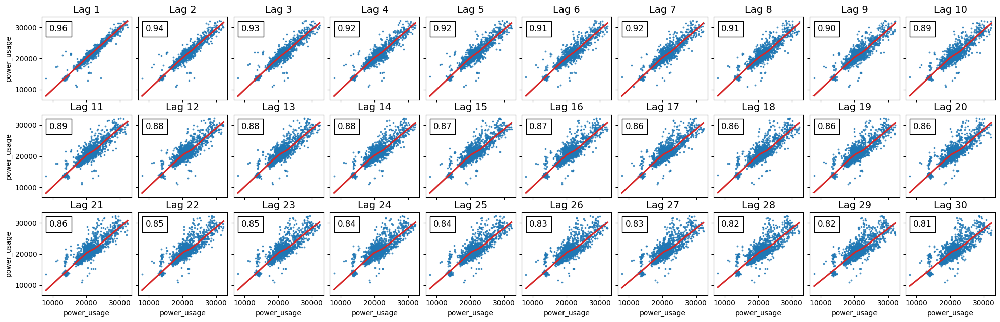

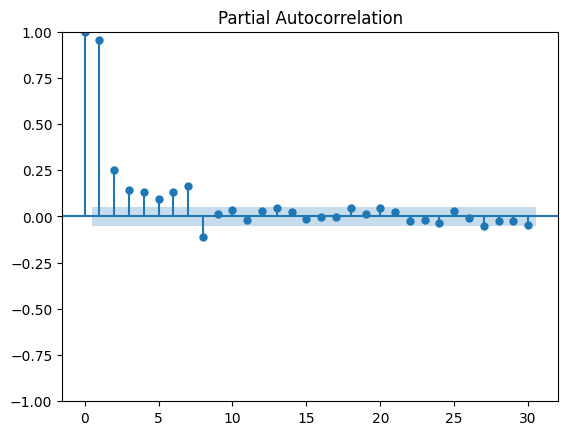

In [150]:
_ = plot_lags(c13.power_usage, lags=30, nrows=3)
_ = plot_pacf(c13.power_usage, lags=30)

In [151]:
for j in range(1, 9):
    c13["lag_{}".format(j)] = c13.power_usage.shift(j)

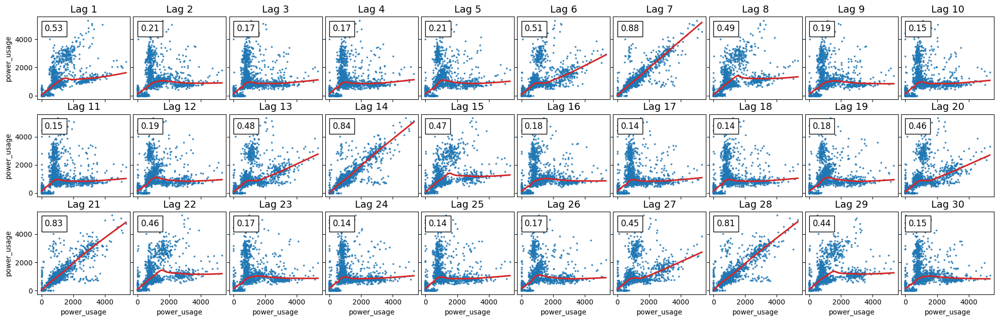

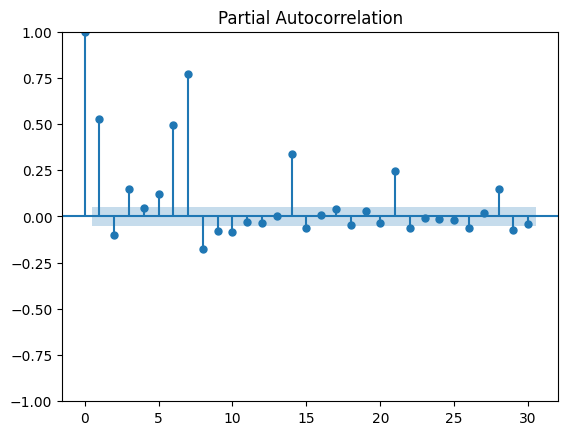

In [152]:
_ = plot_lags(c14.power_usage, lags=30, nrows=3)
_ = plot_pacf(c14.power_usage, lags=30)

In [153]:
for j in range(1, 11):
    c14["lag_{}".format(j)] = c14.power_usage.shift(j)

# Adding daily temperature features

In [154]:
w1 = w['2011-01-01':'2014-12-31']
w1.index = pd.to_datetime(w1.index)
w1 = w1.resample("D").mean()

In [155]:
c1 = pd.concat([c1,w1], axis=1)
c2 = pd.concat([c2,w1], axis=1)
c3 = pd.concat([c3,w1], axis=1)
c4 = pd.concat([c4,w1], axis=1)
c5 = pd.concat([c5,w1], axis=1)
c6 = pd.concat([c6,w1], axis=1)
c7 = pd.concat([c7,w1], axis=1)
c8 = pd.concat([c8,w1], axis=1)
c9 = pd.concat([c9,w1], axis=1)
c10 = pd.concat([c10,w1], axis=1)
c11 = pd.concat([c11,w1], axis=1)
c12 = pd.concat([c12,w1], axis=1)
c13 = pd.concat([c13,w1], axis=1)
c14 = pd.concat([c14,w1], axis=1)

# Temporal Fusion Transformer

In [156]:
%%capture
pip install torch pytorch-lightning pytorch_forecasting

In [157]:
import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping, LearningRateMonitor
from lightning.pytorch.loggers import TensorBoardLogger
import torch

from pytorch_forecasting import Baseline, TemporalFusionTransformer, TimeSeriesDataSet
from pytorch_forecasting.data import GroupNormalizer
from pytorch_forecasting.metrics import SMAPE, PoissonLoss, QuantileLoss
from pytorch_forecasting.models.temporal_fusion_transformer.tuning import optimize_hyperparameters

import seaborn as sns

In [158]:
max_prediction_length = 180
max_encoder_length = 360

In [159]:
c1['days_from_start'] = (c1.index - c1.index.min()).days
c2['days_from_start'] = (c2.index - c2.index.min()).days
c3['days_from_start'] = (c3.index - c3.index.min()).days
c4['days_from_start'] = (c4.index - c4.index.min()).days
c5['days_from_start'] = (c5.index - c5.index.min()).days
c6['days_from_start'] = (c6.index - c6.index.min()).days
c7['days_from_start'] = (c7.index - c7.index.min()).days
c8['days_from_start'] = (c8.index - c8.index.min()).days
c9['days_from_start'] = (c9.index - c9.index.min()).days
c10['days_from_start'] = (c10.index - c10.index.min()).days
c11['days_from_start'] = (c11.index - c11.index.min()).days
c12['days_from_start'] = (c12.index - c12.index.min()).days
c13['days_from_start'] = (c13.index - c13.index.min()).days
c14['days_from_start'] = (c14.index - c14.index.min()).days

In [160]:
c1['cluster'] = '1'
c2['cluster'] = '2'
c3['cluster'] = '3'
c4['cluster'] = '4'
c5['cluster'] = '5'
c6['cluster'] = '6'
c7['cluster'] = '7'
c8['cluster'] = '8'
c9['cluster'] = '9'
c10['cluster'] = '10'
c11['cluster'] = '11'
c12['cluster'] = '12'
c13['cluster'] = '13'
c14['cluster'] = '14'

In [161]:
batch_size = 64

In [172]:
def label_time (row):
    if (row.name - cluster2.index.min()).days < 60:
      return 1
    elif (row.name- cluster2.index.min()).days < 120:
      return 2
    else:
      return 3

In [176]:
import torch
torch.cuda.empty_cache()

In [177]:
import gc
gc.collect()

1133943

## c14 TFT

In [ ]:
c14c = []
for i in c14.columns[1:-2]:
    c14c.append(i)
c14 = c14.fillna(0)
training14 = TimeSeriesDataSet(
    c14['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c14c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation14 = TimeSeriesDataSet.from_dataset(training14, c14[:-180], predict=True, stop_randomization=True)
test14 = TimeSeriesDataSet.from_dataset(validation14, c14, predict=True, stop_randomization=True)
train_dataloader14 = training14.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader14 = validation14.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader14 = test14.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals14 = torch.cat([y for x, (y, weight) in iter(val_dataloader14)]).to('cuda')
baseline_predictions14 = Baseline().predict(val_dataloader14).to('cuda')
((actuals14 - baseline_predictions14)/(actuals14)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


2.3834388256073

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer14 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft14 = TemporalFusionTransformer.from_dataset(
    training14,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer14.fit(tft14,
    train_dataloaders=train_dataloader14,
    val_dataloaders=val_dataloader14)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 12.2 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.8 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.7 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 1242.955
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 1242.955


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.353 >= min_delta = 1. New best score: 1222.602
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.353 >= min_delta = 1. New best score: 1222.602


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 42.225 >= min_delta = 1. New best score: 1180.377
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 42.225 >= min_delta = 1. New best score: 1180.377


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 73.500 >= min_delta = 1. New best score: 1106.878
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 73.500 >= min_delta = 1. New best score: 1106.878


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 111.248 >= min_delta = 1. New best score: 995.630
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 111.248 >= min_delta = 1. New best score: 995.630


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 108.845 >= min_delta = 1. New best score: 886.785
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 108.845 >= min_delta = 1. New best score: 886.785


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 195.321 >= min_delta = 1. New best score: 691.464
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 195.321 >= min_delta = 1. New best score: 691.464


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 192.451 >= min_delta = 1. New best score: 499.013
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 192.451 >= min_delta = 1. New best score: 499.013


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 96.836 >= min_delta = 1. New best score: 402.178
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 96.836 >= min_delta = 1. New best score: 402.178


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 60.507 >= min_delta = 1. New best score: 341.671
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 60.507 >= min_delta = 1. New best score: 341.671


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 82.094 >= min_delta = 1. New best score: 259.577
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 82.094 >= min_delta = 1. New best score: 259.577


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 24.481 >= min_delta = 1. New best score: 235.096
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 24.481 >= min_delta = 1. New best score: 235.096


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 37.819 >= min_delta = 1. New best score: 197.277
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 37.819 >= min_delta = 1. New best score: 197.277


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 35.155 >= min_delta = 1. New best score: 162.122
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 35.155 >= min_delta = 1. New best score: 162.122


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 27.913 >= min_delta = 1. New best score: 134.209
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 27.913 >= min_delta = 1. New best score: 134.209


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.297 >= min_delta = 1. New best score: 130.912
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.297 >= min_delta = 1. New best score: 130.912


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 6.727 >= min_delta = 1. New best score: 124.185
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 6.727 >= min_delta = 1. New best score: 124.185


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.015 >= min_delta = 1. New best score: 121.170
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.015 >= min_delta = 1. New best score: 121.170


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 121.170. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 121.170. Signaling Trainer to stop.


In [ ]:
best_model_path14 = trainer14.checkpoint_callback.best_model_path
print(best_model_path14)
best_tft14= TemporalFusionTransformer.load_from_checkpoint(best_model_path14)
actuals14_p = torch.cat([y[0] for x, y in iter(val_dataloader14)]).to('cuda')
predictions14= best_tft14.predict(val_dataloader14).to('cuda')
((actuals14_p - predictions14)/(actuals14_p)).abs().mean().item()

lightning_logs/lightning_logs/version_0/checkpoints/epoch=28-step=551.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.2236030250787735

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


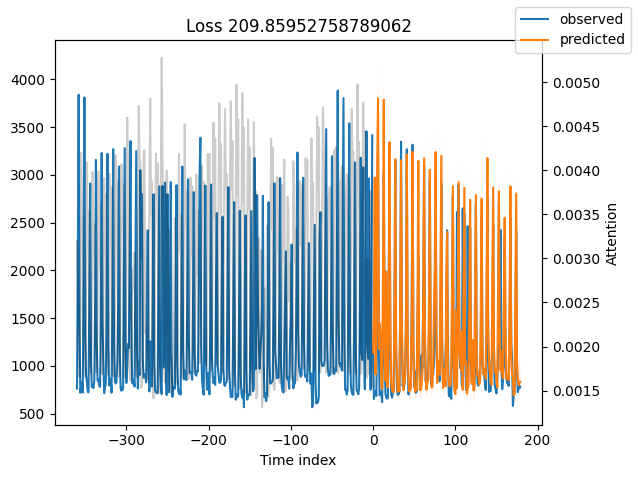

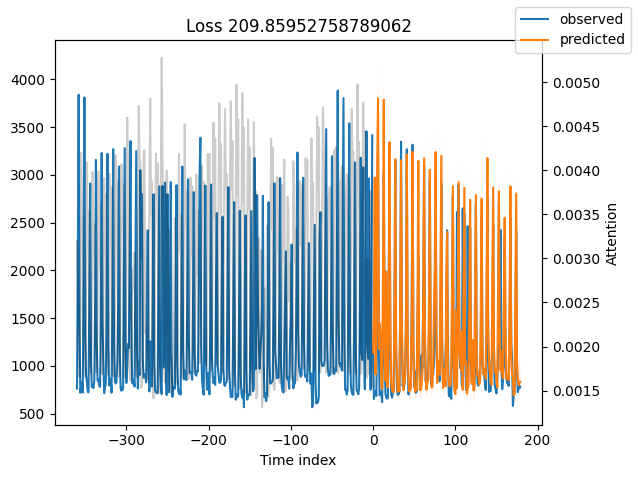

In [ ]:
raw_predictions14= best_tft14.predict(val_dataloader14, mode="raw", return_x=True)
best_tft14.plot_prediction(raw_predictions14.x, raw_predictions14.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


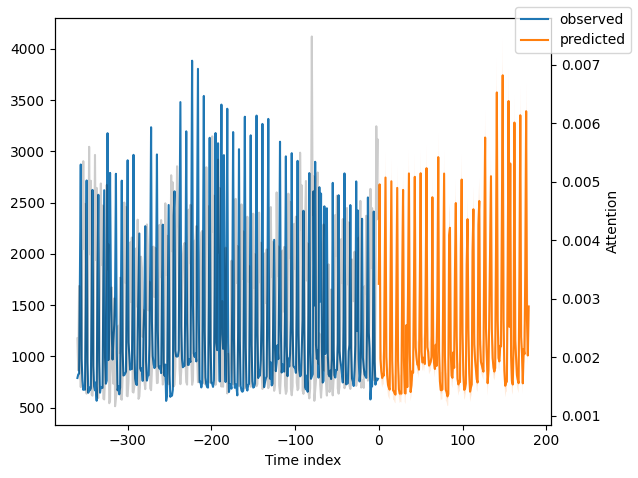

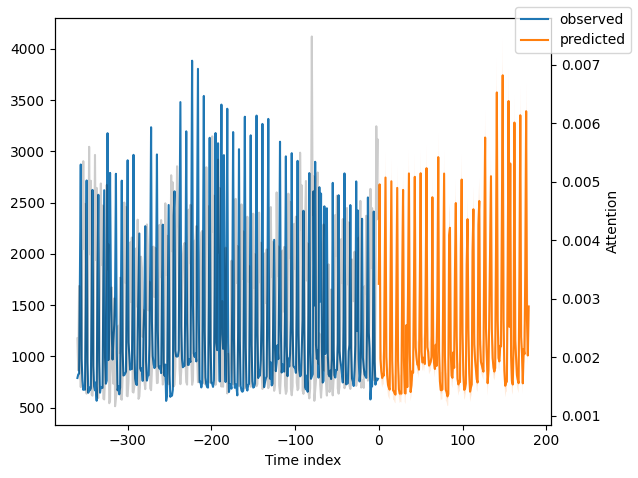

In [ ]:
new_raw_predictions14 = best_tft14.predict(test_dataloader14, mode="raw", return_x=True)
best_tft14.plot_prediction(new_raw_predictions14.x, new_raw_predictions14.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


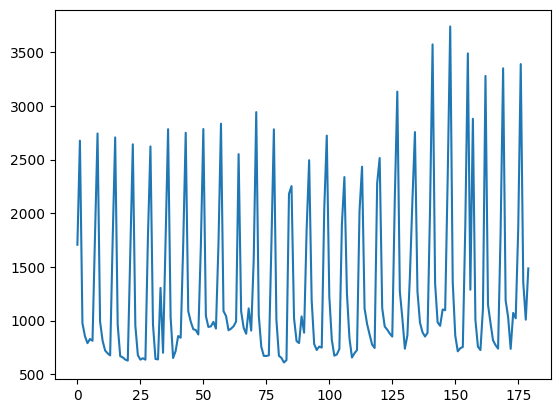

In [ ]:
new_raw_predictions14 = best_tft14.predict(test_dataloader14).to('cuda')
new_raw_predictions14 = new_raw_predictions14.cpu().numpy()
new_raw_predictions14 = new_raw_predictions14[0]
plt.plot(new_raw_predictions14)

In [ ]:
cluster14 = cluster[14][-180:].to_frame(name='original')
cluster14['prediction'] = new_raw_predictions14.tolist()
cluster14['MAPE'] = abs(cluster14.original-cluster14.prediction)/cluster14.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

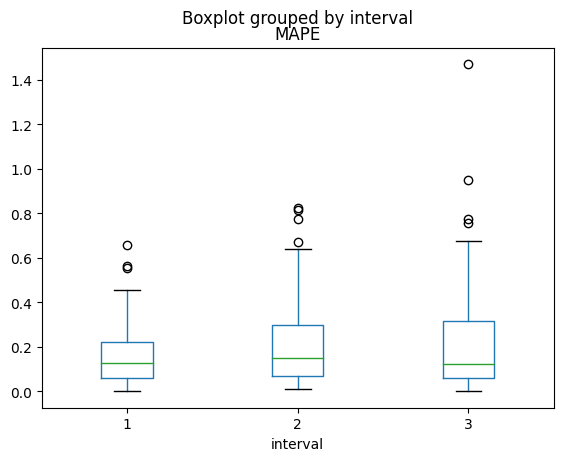

In [ ]:
cluster14['interval'] = cluster14.apply (lambda row: label_time(row), axis = 1)
cluster14.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape14 = cluster14['MAPE'].mean()
mape14

0.20625223307862986

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x1075 with 1 Axes>,
 'decoder_variables': <Figure size 700x1050 with 1 Axes>}

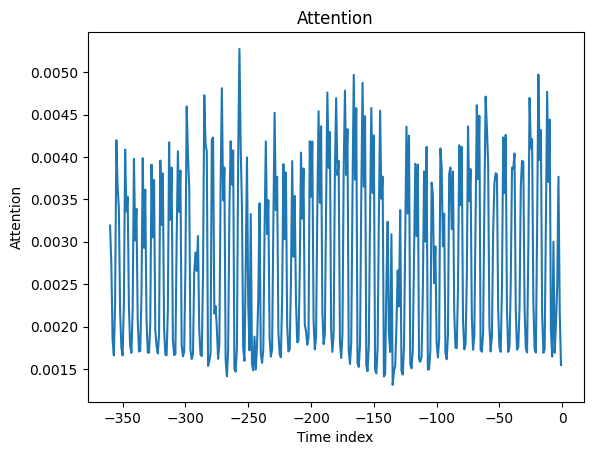

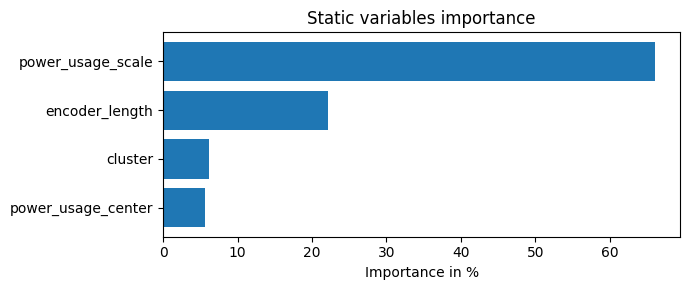

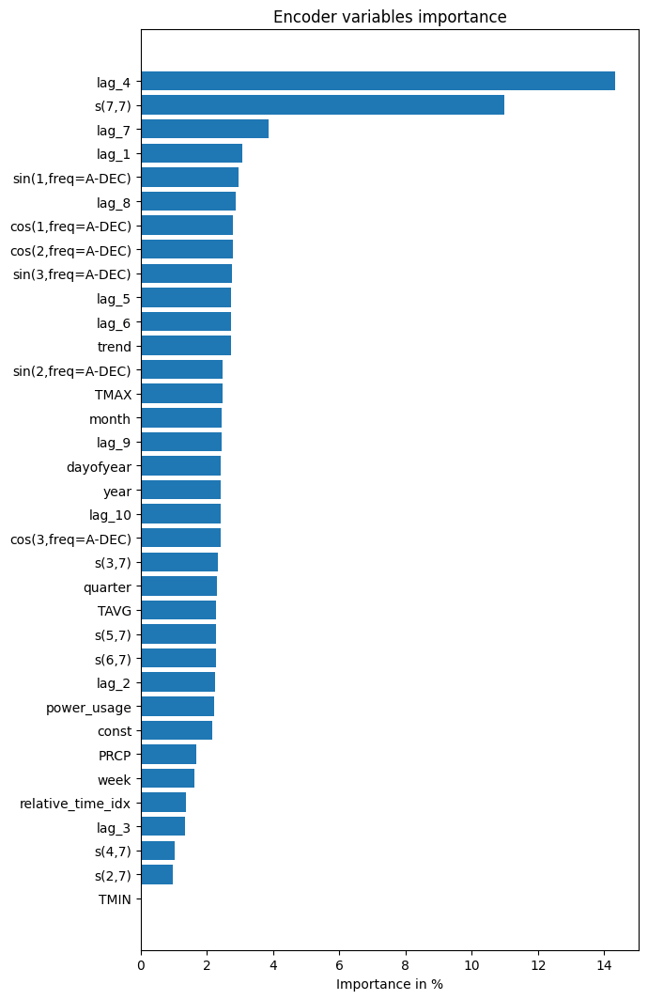

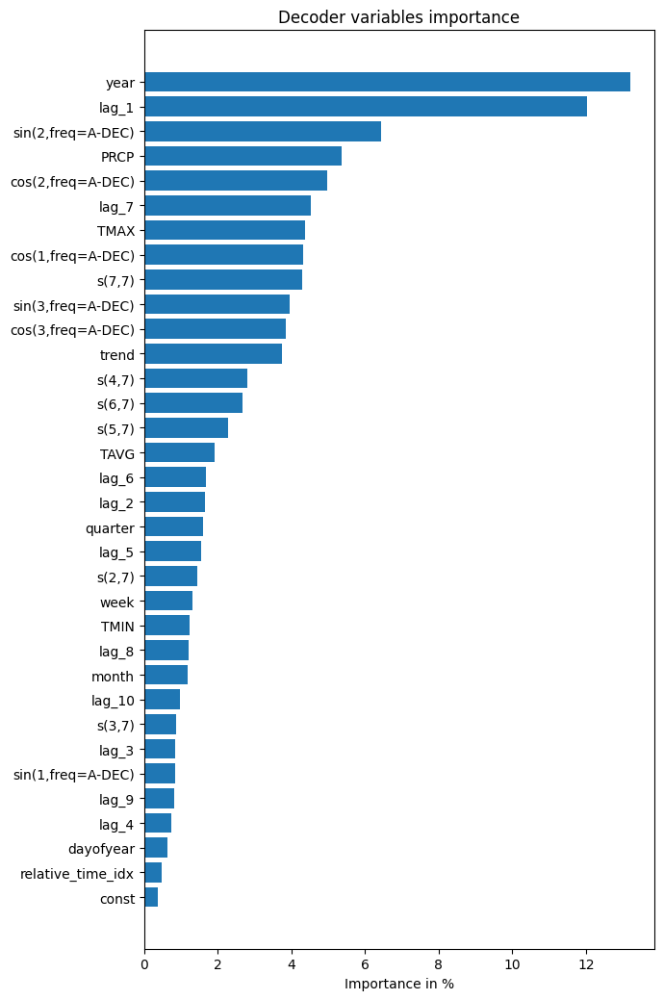

In [ ]:
interpretation14 = best_tft14.interpret_output(raw_predictions14.output, reduction="sum")
best_tft14.plot_interpretation(interpretation14)




---



## c13 TFT

In [ ]:
c13c = []
for i in c13.columns[1:-2]:
    c13c.append(i)
c13 = c13.fillna(0)
training13 = TimeSeriesDataSet(
    c13['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c13c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation13 = TimeSeriesDataSet.from_dataset(training13, c13[:-180], predict=True, stop_randomization=True)
test13 = TimeSeriesDataSet.from_dataset(validation13, c13, predict=True, stop_randomization=True)
train_dataloader13 = training13.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader13 = validation13.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader13 = test13.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals13 = torch.cat([y for x, (y, weight) in iter(val_dataloader13)]).to('cuda')
baseline_predictions13 = Baseline().predict(val_dataloader13).to('cuda')
((actuals13 - baseline_predictions13)/(actuals13)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.04600276052951813

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer13 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft13 = TemporalFusionTransformer.from_dataset(
    training13,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer13.fit(tft13,
    train_dataloaders=train_dataloader13,
    val_dataloaders=val_dataloader13)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 8.6 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 2.6 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.5 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 21480.830
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 21480.830


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.516 >= min_delta = 1. New best score: 21460.314
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.516 >= min_delta = 1. New best score: 21460.314


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 42.678 >= min_delta = 1. New best score: 21417.637
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 42.678 >= min_delta = 1. New best score: 21417.637


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 74.602 >= min_delta = 1. New best score: 21343.035
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 74.602 >= min_delta = 1. New best score: 21343.035


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 116.465 >= min_delta = 1. New best score: 21226.570
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 116.465 >= min_delta = 1. New best score: 21226.570


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.516 >= min_delta = 1. New best score: 21114.055
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.516 >= min_delta = 1. New best score: 21114.055


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 208.568 >= min_delta = 1. New best score: 20905.486
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 208.568 >= min_delta = 1. New best score: 20905.486


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 273.262 >= min_delta = 1. New best score: 20632.225
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 273.262 >= min_delta = 1. New best score: 20632.225


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 345.178 >= min_delta = 1. New best score: 20287.047
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 345.178 >= min_delta = 1. New best score: 20287.047


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 423.762 >= min_delta = 1. New best score: 19863.285
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 423.762 >= min_delta = 1. New best score: 19863.285


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 507.705 >= min_delta = 1. New best score: 19355.580
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 507.705 >= min_delta = 1. New best score: 19355.580


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 410.842 >= min_delta = 1. New best score: 18944.738
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 410.842 >= min_delta = 1. New best score: 18944.738


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 666.736 >= min_delta = 1. New best score: 18278.002
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 666.736 >= min_delta = 1. New best score: 18278.002


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 767.461 >= min_delta = 1. New best score: 17510.541
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 767.461 >= min_delta = 1. New best score: 17510.541


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 873.422 >= min_delta = 1. New best score: 16637.119
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 873.422 >= min_delta = 1. New best score: 16637.119


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 984.208 >= min_delta = 1. New best score: 15652.911
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 984.208 >= min_delta = 1. New best score: 15652.911


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1099.944 >= min_delta = 1. New best score: 14552.967
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1099.944 >= min_delta = 1. New best score: 14552.967


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 844.194 >= min_delta = 1. New best score: 13708.772
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 844.194 >= min_delta = 1. New best score: 13708.772


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1310.959 >= min_delta = 1. New best score: 12397.813
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1310.959 >= min_delta = 1. New best score: 12397.813


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1441.731 >= min_delta = 1. New best score: 10956.082
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1441.731 >= min_delta = 1. New best score: 10956.082


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1577.299 >= min_delta = 1. New best score: 9378.783
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1577.299 >= min_delta = 1. New best score: 9378.783


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1717.447 >= min_delta = 1. New best score: 7661.336
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1717.447 >= min_delta = 1. New best score: 7661.336


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1862.470 >= min_delta = 1. New best score: 5798.866
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1862.470 >= min_delta = 1. New best score: 5798.866


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1395.957 >= min_delta = 1. New best score: 4402.909
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1395.957 >= min_delta = 1. New best score: 4402.909


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2109.124 >= min_delta = 1. New best score: 2293.785
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2109.124 >= min_delta = 1. New best score: 2293.785


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1560.555 >= min_delta = 1. New best score: 733.230
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1560.555 >= min_delta = 1. New best score: 733.230


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 26.000 >= min_delta = 1. New best score: 707.230
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 26.000 >= min_delta = 1. New best score: 707.230


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 11.752 >= min_delta = 1. New best score: 695.478
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 11.752 >= min_delta = 1. New best score: 695.478


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 95.384 >= min_delta = 1. New best score: 600.094
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 95.384 >= min_delta = 1. New best score: 600.094


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.969 >= min_delta = 1. New best score: 596.125
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.969 >= min_delta = 1. New best score: 596.125


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 56.197 >= min_delta = 1. New best score: 539.928
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 56.197 >= min_delta = 1. New best score: 539.928


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 42.365 >= min_delta = 1. New best score: 497.563
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 42.365 >= min_delta = 1. New best score: 497.563


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 149.848 >= min_delta = 1. New best score: 347.715
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 149.848 >= min_delta = 1. New best score: 347.715


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 347.715. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 347.715. Signaling Trainer to stop.


In [ ]:
best_model_path13 = trainer13.checkpoint_callback.best_model_path
print(best_model_path13)
best_tft13= TemporalFusionTransformer.load_from_checkpoint(best_model_path13)
actuals13_p = torch.cat([y[0] for x, y in iter(val_dataloader13)]).to('cuda')
predictions13= best_tft13.predict(val_dataloader13).to('cuda')
((actuals13_p - predictions13)/(actuals13_p)).abs().mean().item()

lightning_logs/lightning_logs/version_0/checkpoints/epoch=43-step=836.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.0390385277569294

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


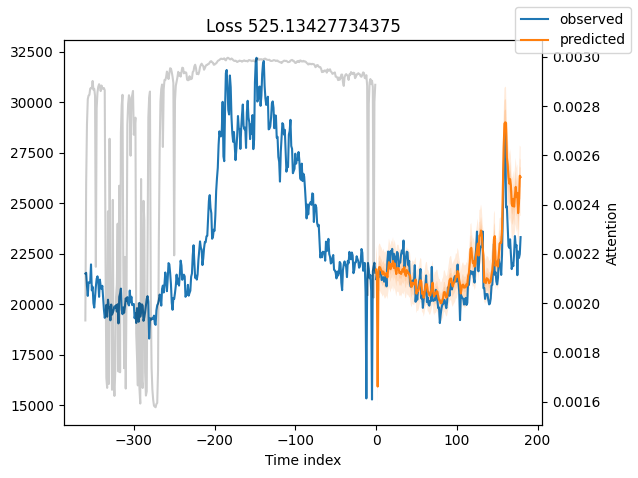

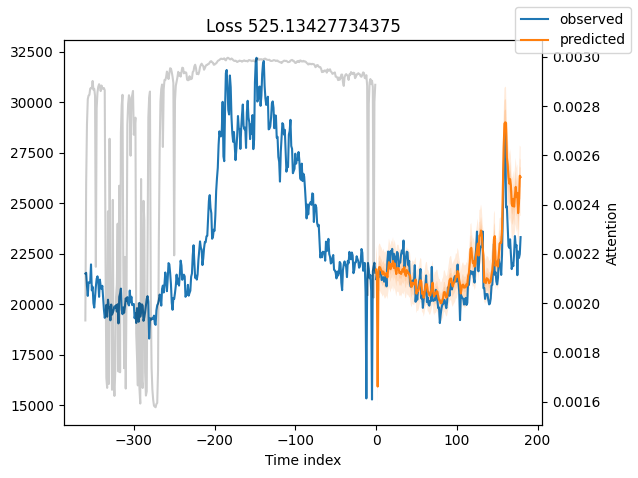

In [ ]:
raw_predictions13= best_tft13.predict(val_dataloader13, mode="raw", return_x=True)
best_tft13.plot_prediction(raw_predictions13.x, raw_predictions13.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


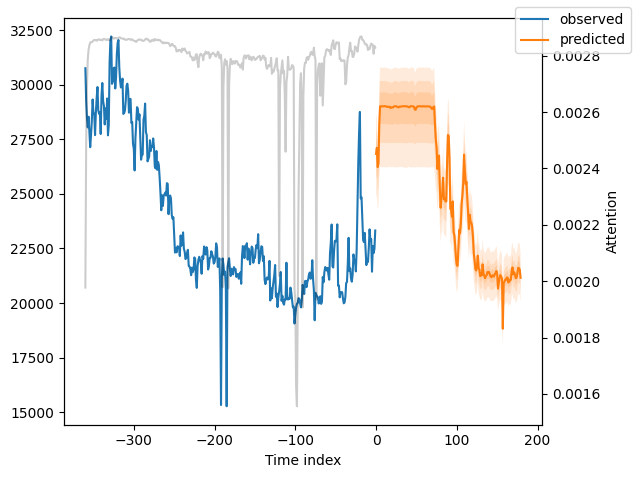

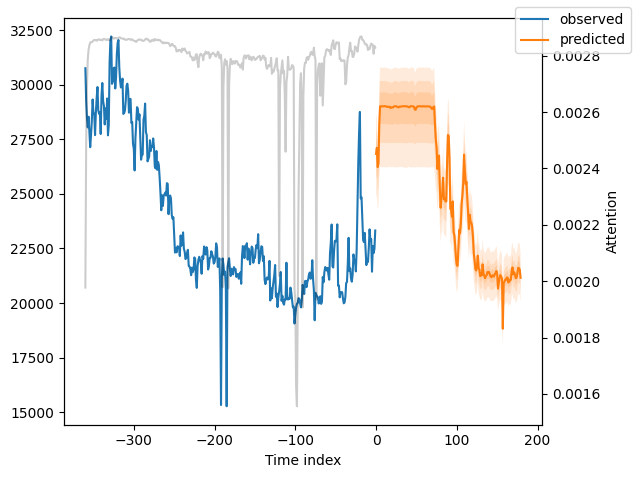

In [ ]:
new_raw_predictions13 = best_tft13.predict(test_dataloader13, mode="raw", return_x=True)
best_tft13.plot_prediction(new_raw_predictions13.x, new_raw_predictions13.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


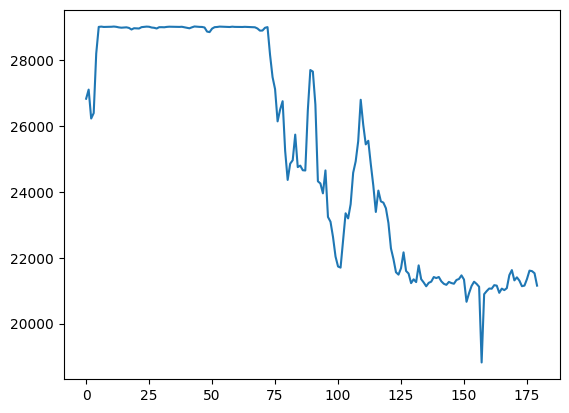

In [ ]:
new_raw_predictions13 = best_tft13.predict(test_dataloader13).to('cuda')
new_raw_predictions13 = new_raw_predictions13.cpu().numpy()
new_raw_predictions13 = new_raw_predictions13[0]
plt.plot(new_raw_predictions13)

In [ ]:
cluster13 = cluster[13][-180:].to_frame(name='original')
cluster13['prediction'] = new_raw_predictions13.tolist()
cluster13['MAPE'] = abs(cluster13.original-cluster13.prediction)/cluster13.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

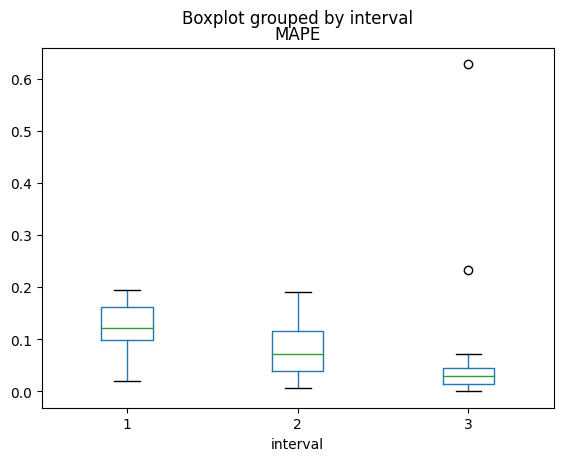

In [ ]:
cluster13['interval'] = cluster13.apply (lambda row: label_time(row), axis = 1)
cluster13.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape13 = cluster13['MAPE'].mean()
mape13

0.08194565123015383

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x800 with 1 Axes>,
 'decoder_variables': <Figure size 700x775 with 1 Axes>}

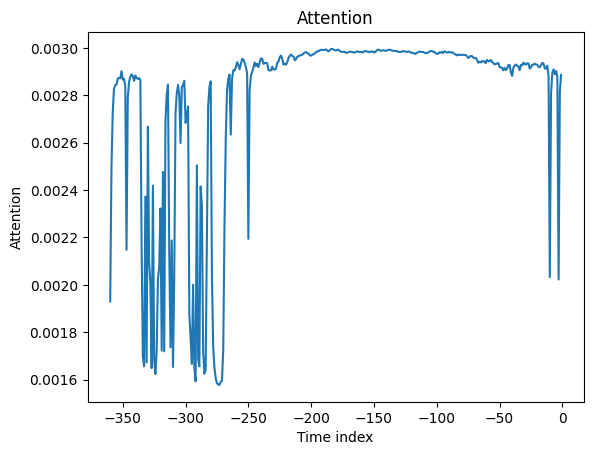

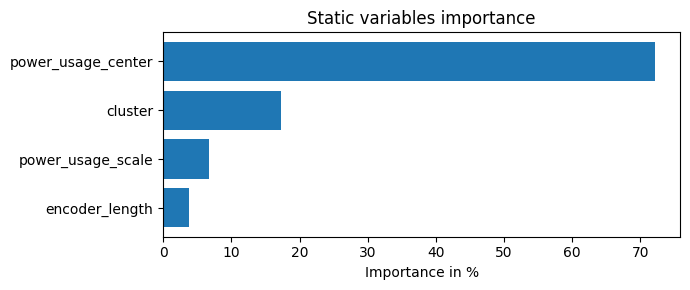

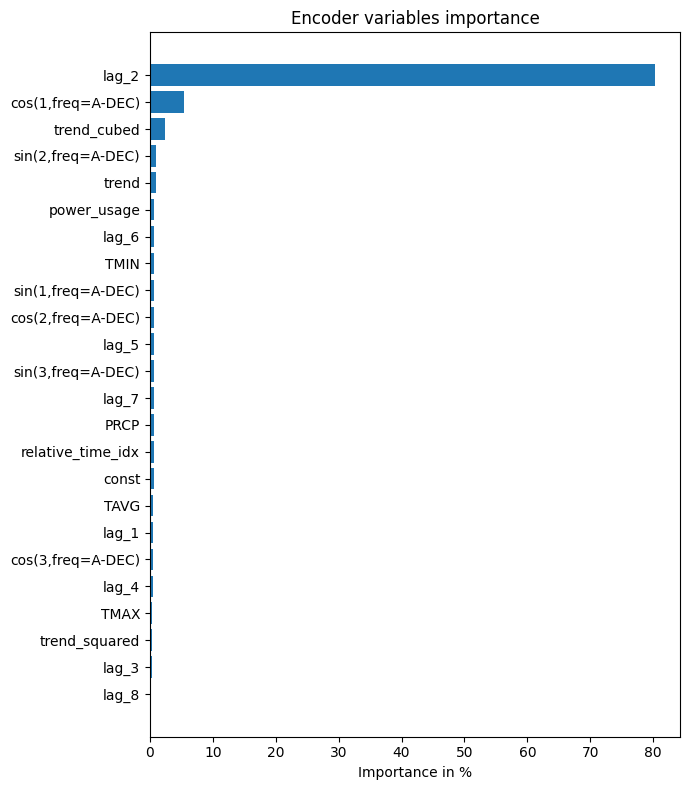

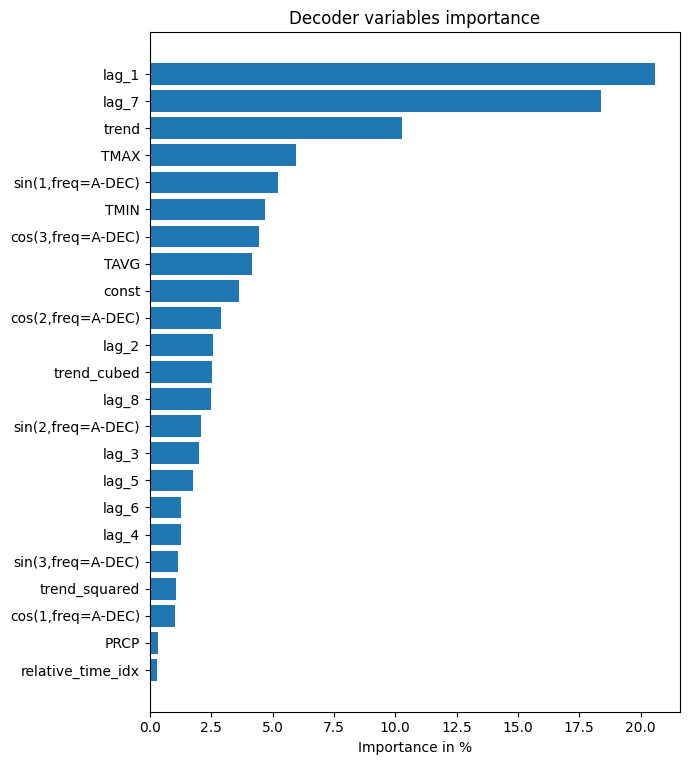

In [ ]:
interpretation13 = best_tft13.interpret_output(raw_predictions13.output, reduction="sum")
best_tft13.plot_interpretation(interpretation13)

## c12 TFT

In [ ]:
c12 = c12[365:]

In [ ]:
c12['days_from_start'] = (c12.index - c12.index.min()).days

In [ ]:
c12

,power_usage,const,trend,"sin(1,freq=A-DEC)","cos(1,freq=A-DEC)",year,dayofyear,lag_1,TMAX,TAVG,TMIN,PRCP,days_from_start,cluster
2012-01-01,106.882782,1.0,366.0,0.000000,1.000000,2012,1,203.885788,60.0,55.0,49.0,0.00,0,12
2012-01-02,206.795835,1.0,367.0,0.017166,0.999853,2012,2,106.882782,63.0,56.0,50.0,0.15,1,12
2012-01-03,207.114641,1.0,368.0,0.034328,0.999411,2012,3,206.795835,59.0,52.0,45.0,0.00,2,12
2012-01-04,214.315515,1.0,369.0,0.051479,0.998674,2012,4,207.114641,65.0,57.0,45.0,0.00,3,12
2012-01-05,215.306999,1.0,370.0,0.068615,0.997643,2012,5,214.315515,64.0,56.0,48.0,0.00,4,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-27,16674.683305,1.0,1457.0,-0.085965,0.996298,2014,361,16871.763804,57.0,53.0,49.0,0.00,1091,12
2014-12-28,16356.718918,1.0,1458.0,-0.068802,0.997630,2014,362,16674.683305,61.0,56.0,51.0,0.00,1092,12
2014-12-29,17627.633297,1.0,1459.0,-0.051620,0.998667,2014,363,16356.718918,53.0,49.0,45.0,0.00,1093,12
2014-12-30,17495.117285,1.0,1460.0,-0.034422,0.999407,2014,364,17627.633297,52.0,45.5,39.0,0.00,1094,12


In [ ]:
c12c = []
for i in c12.columns[1:-2]:
    c12c.append(i)
c12 = c12.fillna(0)
training12 = TimeSeriesDataSet(
    c12['2012-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c12c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation12 = TimeSeriesDataSet.from_dataset(training12, c12[:-180], predict=True, stop_randomization=True)
test12 = TimeSeriesDataSet.from_dataset(validation12, c12, predict=True, stop_randomization=True)
train_dataloader12 = training12.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader12 = validation12.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader12 = test12.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals12 = torch.cat([y for x, (y, weight) in iter(val_dataloader12)]).to('cuda')
baseline_predictions12 = Baseline().predict(val_dataloader12).to('cuda')
((actuals12 - baseline_predictions12)/(actuals12)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.153970867395401

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=0.1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer12 = pl.Trainer(
    max_epochs=150,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft12 = TemporalFusionTransformer.from_dataset(
    training12,
    learning_rate=0.01,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer12.fit(tft12,
    train_dataloaders=train_dataloader12,
    val_dataloaders=val_dataloader12)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 5.1 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 1.4 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 1.3 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 15559.490
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 15559.490


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1.750 >= min_delta = 0.1. New best score: 15557.740
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1.750 >= min_delta = 0.1. New best score: 15557.740


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 0.948 >= min_delta = 0.1. New best score: 15556.792
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 0.948 >= min_delta = 0.1. New best score: 15556.792


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1.881 >= min_delta = 0.1. New best score: 15554.911
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1.881 >= min_delta = 0.1. New best score: 15554.911


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2.402 >= min_delta = 0.1. New best score: 15552.509
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2.402 >= min_delta = 0.1. New best score: 15552.509


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1.837 >= min_delta = 0.1. New best score: 15550.672
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1.837 >= min_delta = 0.1. New best score: 15550.672


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.396 >= min_delta = 0.1. New best score: 15547.275
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.396 >= min_delta = 0.1. New best score: 15547.275


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4.042 >= min_delta = 0.1. New best score: 15543.233
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4.042 >= min_delta = 0.1. New best score: 15543.233


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2.908 >= min_delta = 0.1. New best score: 15540.325
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2.908 >= min_delta = 0.1. New best score: 15540.325


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 5.200 >= min_delta = 0.1. New best score: 15535.125
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 5.200 >= min_delta = 0.1. New best score: 15535.125


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 5.950 >= min_delta = 0.1. New best score: 15529.175
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 5.950 >= min_delta = 0.1. New best score: 15529.175


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4.147 >= min_delta = 0.1. New best score: 15525.027
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4.147 >= min_delta = 0.1. New best score: 15525.027


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 7.269 >= min_delta = 0.1. New best score: 15517.759
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 7.269 >= min_delta = 0.1. New best score: 15517.759


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 8.120 >= min_delta = 0.1. New best score: 15509.639
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 8.120 >= min_delta = 0.1. New best score: 15509.639


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 5.549 >= min_delta = 0.1. New best score: 15504.090
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 5.549 >= min_delta = 0.1. New best score: 15504.090


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 9.593 >= min_delta = 0.1. New best score: 15494.497
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 9.593 >= min_delta = 0.1. New best score: 15494.497


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 10.530 >= min_delta = 0.1. New best score: 15483.967
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 10.530 >= min_delta = 0.1. New best score: 15483.967


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 7.093 >= min_delta = 0.1. New best score: 15476.874
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 7.093 >= min_delta = 0.1. New best score: 15476.874


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 12.131 >= min_delta = 0.1. New best score: 15464.743
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 12.131 >= min_delta = 0.1. New best score: 15464.743


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 13.141 >= min_delta = 0.1. New best score: 15451.603
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 13.141 >= min_delta = 0.1. New best score: 15451.603


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 8.764 >= min_delta = 0.1. New best score: 15442.839
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 8.764 >= min_delta = 0.1. New best score: 15442.839


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 14.855 >= min_delta = 0.1. New best score: 15427.983
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 14.855 >= min_delta = 0.1. New best score: 15427.983


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 15.937 >= min_delta = 0.1. New best score: 15412.047
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 15.937 >= min_delta = 0.1. New best score: 15412.047


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 10.540 >= min_delta = 0.1. New best score: 15401.507
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 10.540 >= min_delta = 0.1. New best score: 15401.507


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 17.754 >= min_delta = 0.1. New best score: 15383.753
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 17.754 >= min_delta = 0.1. New best score: 15383.753


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 18.892 >= min_delta = 0.1. New best score: 15364.861
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 18.892 >= min_delta = 0.1. New best score: 15364.861


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 12.420 >= min_delta = 0.1. New best score: 15352.441
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 12.420 >= min_delta = 0.1. New best score: 15352.441


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.811 >= min_delta = 0.1. New best score: 15331.631
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.811 >= min_delta = 0.1. New best score: 15331.631


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 22.025 >= min_delta = 0.1. New best score: 15309.605
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 22.025 >= min_delta = 0.1. New best score: 15309.605


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 14.283 >= min_delta = 0.1. New best score: 15295.322
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 14.283 >= min_delta = 0.1. New best score: 15295.322


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 22.742 >= min_delta = 0.1. New best score: 15272.580
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 22.742 >= min_delta = 0.1. New best score: 15272.580


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 22.035 >= min_delta = 0.1. New best score: 15250.545
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 22.035 >= min_delta = 0.1. New best score: 15250.545


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 13.745 >= min_delta = 0.1. New best score: 15236.800
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 13.745 >= min_delta = 0.1. New best score: 15236.800


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 22.661 >= min_delta = 0.1. New best score: 15214.139
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 22.661 >= min_delta = 0.1. New best score: 15214.139


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 23.514 >= min_delta = 0.1. New best score: 15190.625
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 23.514 >= min_delta = 0.1. New best score: 15190.625


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 15.181 >= min_delta = 0.1. New best score: 15175.444
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 15.181 >= min_delta = 0.1. New best score: 15175.444


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 21.477 >= min_delta = 0.1. New best score: 15153.968
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 21.477 >= min_delta = 0.1. New best score: 15153.968


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 26.741 >= min_delta = 0.1. New best score: 15127.227
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 26.741 >= min_delta = 0.1. New best score: 15127.227


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 41.415 >= min_delta = 0.1. New best score: 15085.812
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 41.415 >= min_delta = 0.1. New best score: 15085.812


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2.020 >= min_delta = 0.1. New best score: 15083.792
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2.020 >= min_delta = 0.1. New best score: 15083.792


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 11.117 >= min_delta = 0.1. New best score: 15072.675
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 11.117 >= min_delta = 0.1. New best score: 15072.675


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2.480 >= min_delta = 0.1. New best score: 15070.194
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2.480 >= min_delta = 0.1. New best score: 15070.194


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 13.356 >= min_delta = 0.1. New best score: 15056.838
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 13.356 >= min_delta = 0.1. New best score: 15056.838


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.710 >= min_delta = 0.1. New best score: 15053.128
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.710 >= min_delta = 0.1. New best score: 15053.128


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 35.310 >= min_delta = 0.1. New best score: 15017.818
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 35.310 >= min_delta = 0.1. New best score: 15017.818


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 51.855 >= min_delta = 0.1. New best score: 14965.963
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 51.855 >= min_delta = 0.1. New best score: 14965.963


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 7.928 >= min_delta = 0.1. New best score: 14958.035
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 7.928 >= min_delta = 0.1. New best score: 14958.035


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 16.193 >= min_delta = 0.1. New best score: 14941.842
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 16.193 >= min_delta = 0.1. New best score: 14941.842


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.639 >= min_delta = 0.1. New best score: 14938.203
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.639 >= min_delta = 0.1. New best score: 14938.203


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 33.897 >= min_delta = 0.1. New best score: 14904.306
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 33.897 >= min_delta = 0.1. New best score: 14904.306


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 45.404 >= min_delta = 0.1. New best score: 14858.901
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 45.404 >= min_delta = 0.1. New best score: 14858.901


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 36.116 >= min_delta = 0.1. New best score: 14822.785
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 36.116 >= min_delta = 0.1. New best score: 14822.785


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 16.321 >= min_delta = 0.1. New best score: 14806.464
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 16.321 >= min_delta = 0.1. New best score: 14806.464


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 35.369 >= min_delta = 0.1. New best score: 14771.095
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 35.369 >= min_delta = 0.1. New best score: 14771.095


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 52.832 >= min_delta = 0.1. New best score: 14718.263
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 52.832 >= min_delta = 0.1. New best score: 14718.263


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 47.657 >= min_delta = 0.1. New best score: 14670.605
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 47.657 >= min_delta = 0.1. New best score: 14670.605


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 75.809 >= min_delta = 0.1. New best score: 14594.797
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 75.809 >= min_delta = 0.1. New best score: 14594.797


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 38.659 >= min_delta = 0.1. New best score: 14556.138
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 38.659 >= min_delta = 0.1. New best score: 14556.138


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 24.049 >= min_delta = 0.1. New best score: 14532.089
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 24.049 >= min_delta = 0.1. New best score: 14532.089


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 37.932 >= min_delta = 0.1. New best score: 14494.157
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 37.932 >= min_delta = 0.1. New best score: 14494.157


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 49.746 >= min_delta = 0.1. New best score: 14444.411
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 49.746 >= min_delta = 0.1. New best score: 14444.411


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 9.743 >= min_delta = 0.1. New best score: 14434.668
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 9.743 >= min_delta = 0.1. New best score: 14434.668


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 40.957 >= min_delta = 0.1. New best score: 14393.711
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 40.957 >= min_delta = 0.1. New best score: 14393.711


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 39.162 >= min_delta = 0.1. New best score: 14354.549
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 39.162 >= min_delta = 0.1. New best score: 14354.549


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 25.728 >= min_delta = 0.1. New best score: 14328.821
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 25.728 >= min_delta = 0.1. New best score: 14328.821


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 44.270 >= min_delta = 0.1. New best score: 14284.552
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 44.270 >= min_delta = 0.1. New best score: 14284.552


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 34.270 >= min_delta = 0.1. New best score: 14250.282
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 34.270 >= min_delta = 0.1. New best score: 14250.282


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 27.674 >= min_delta = 0.1. New best score: 14222.608
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 27.674 >= min_delta = 0.1. New best score: 14222.608


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.391 >= min_delta = 0.1. New best score: 14179.218
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.391 >= min_delta = 0.1. New best score: 14179.218


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 55.546 >= min_delta = 0.1. New best score: 14123.672
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 55.546 >= min_delta = 0.1. New best score: 14123.672


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 16.172 >= min_delta = 0.1. New best score: 14107.500
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 16.172 >= min_delta = 0.1. New best score: 14107.500


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 47.036 >= min_delta = 0.1. New best score: 14060.464
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 47.036 >= min_delta = 0.1. New best score: 14060.464


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 39.438 >= min_delta = 0.1. New best score: 14021.025
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 39.438 >= min_delta = 0.1. New best score: 14021.025


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 29.730 >= min_delta = 0.1. New best score: 13991.295
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 29.730 >= min_delta = 0.1. New best score: 13991.295


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 33.270 >= min_delta = 0.1. New best score: 13958.025
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 33.270 >= min_delta = 0.1. New best score: 13958.025


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 61.670 >= min_delta = 0.1. New best score: 13896.355
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 61.670 >= min_delta = 0.1. New best score: 13896.355


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 27.746 >= min_delta = 0.1. New best score: 13868.609
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 27.746 >= min_delta = 0.1. New best score: 13868.609


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 74.287 >= min_delta = 0.1. New best score: 13794.322
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 74.287 >= min_delta = 0.1. New best score: 13794.322


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 53.802 >= min_delta = 0.1. New best score: 13740.521
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 53.802 >= min_delta = 0.1. New best score: 13740.521


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 24.558 >= min_delta = 0.1. New best score: 13715.963
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 24.558 >= min_delta = 0.1. New best score: 13715.963


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 52.192 >= min_delta = 0.1. New best score: 13663.771
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 52.192 >= min_delta = 0.1. New best score: 13663.771


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 151.090 >= min_delta = 0.1. New best score: 13512.681
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 151.090 >= min_delta = 0.1. New best score: 13512.681


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 61.486 >= min_delta = 0.1. New best score: 13451.194
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 61.486 >= min_delta = 0.1. New best score: 13451.194


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 52.342 >= min_delta = 0.1. New best score: 13398.853
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 52.342 >= min_delta = 0.1. New best score: 13398.853


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 42.414 >= min_delta = 0.1. New best score: 13356.438
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 42.414 >= min_delta = 0.1. New best score: 13356.438


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 92.048 >= min_delta = 0.1. New best score: 13264.391
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 92.048 >= min_delta = 0.1. New best score: 13264.391


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 60.885 >= min_delta = 0.1. New best score: 13203.506
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 60.885 >= min_delta = 0.1. New best score: 13203.506


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 64.520 >= min_delta = 0.1. New best score: 13138.986
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 64.520 >= min_delta = 0.1. New best score: 13138.986


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 77.185 >= min_delta = 0.1. New best score: 13061.802
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 77.185 >= min_delta = 0.1. New best score: 13061.802


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 11.260 >= min_delta = 0.1. New best score: 13050.542
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 11.260 >= min_delta = 0.1. New best score: 13050.542


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 144.089 >= min_delta = 0.1. New best score: 12906.453
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 144.089 >= min_delta = 0.1. New best score: 12906.453


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 39.233 >= min_delta = 0.1. New best score: 12867.220
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 39.233 >= min_delta = 0.1. New best score: 12867.220


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 88.940 >= min_delta = 0.1. New best score: 12778.279
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 88.940 >= min_delta = 0.1. New best score: 12778.279


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 122.076 >= min_delta = 0.1. New best score: 12656.203
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 122.076 >= min_delta = 0.1. New best score: 12656.203


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 146.184 >= min_delta = 0.1. New best score: 12510.020
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 146.184 >= min_delta = 0.1. New best score: 12510.020


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 98.411 >= min_delta = 0.1. New best score: 12411.608
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 98.411 >= min_delta = 0.1. New best score: 12411.608


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 67.948 >= min_delta = 0.1. New best score: 12343.660
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 67.948 >= min_delta = 0.1. New best score: 12343.660


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 49.446 >= min_delta = 0.1. New best score: 12294.214
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 49.446 >= min_delta = 0.1. New best score: 12294.214


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 54.194 >= min_delta = 0.1. New best score: 12240.020
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 54.194 >= min_delta = 0.1. New best score: 12240.020


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 93.869 >= min_delta = 0.1. New best score: 12146.150
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 93.869 >= min_delta = 0.1. New best score: 12146.150


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 27.903 >= min_delta = 0.1. New best score: 12118.247
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 27.903 >= min_delta = 0.1. New best score: 12118.247


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 67.490 >= min_delta = 0.1. New best score: 12050.757
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 67.490 >= min_delta = 0.1. New best score: 12050.757


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 265.698 >= min_delta = 0.1. New best score: 11785.059
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 265.698 >= min_delta = 0.1. New best score: 11785.059


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 58.997 >= min_delta = 0.1. New best score: 11726.062
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 58.997 >= min_delta = 0.1. New best score: 11726.062


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 144.963 >= min_delta = 0.1. New best score: 11581.099
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 144.963 >= min_delta = 0.1. New best score: 11581.099


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 60.715 >= min_delta = 0.1. New best score: 11520.384
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 60.715 >= min_delta = 0.1. New best score: 11520.384


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.722 >= min_delta = 0.1. New best score: 11476.662
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.722 >= min_delta = 0.1. New best score: 11476.662


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 51.594 >= min_delta = 0.1. New best score: 11425.068
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 51.594 >= min_delta = 0.1. New best score: 11425.068


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 98.368 >= min_delta = 0.1. New best score: 11326.700
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 98.368 >= min_delta = 0.1. New best score: 11326.700


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 64.663 >= min_delta = 0.1. New best score: 11262.037
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 64.663 >= min_delta = 0.1. New best score: 11262.037


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 98.667 >= min_delta = 0.1. New best score: 11163.370
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 98.667 >= min_delta = 0.1. New best score: 11163.370


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 70.766 >= min_delta = 0.1. New best score: 11092.604
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 70.766 >= min_delta = 0.1. New best score: 11092.604


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 121.888 >= min_delta = 0.1. New best score: 10970.717
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 121.888 >= min_delta = 0.1. New best score: 10970.717


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.818 >= min_delta = 0.1. New best score: 10857.898
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.818 >= min_delta = 0.1. New best score: 10857.898


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 131.899 >= min_delta = 0.1. New best score: 10725.999
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 131.899 >= min_delta = 0.1. New best score: 10725.999


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 135.682 >= min_delta = 0.1. New best score: 10590.317
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 135.682 >= min_delta = 0.1. New best score: 10590.317


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 77.228 >= min_delta = 0.1. New best score: 10513.090
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 77.228 >= min_delta = 0.1. New best score: 10513.090


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4.140 >= min_delta = 0.1. New best score: 10508.950
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4.140 >= min_delta = 0.1. New best score: 10508.950


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 71.081 >= min_delta = 0.1. New best score: 10437.869
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 71.081 >= min_delta = 0.1. New best score: 10437.869


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 94.885 >= min_delta = 0.1. New best score: 10342.984
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 94.885 >= min_delta = 0.1. New best score: 10342.984


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 85.538 >= min_delta = 0.1. New best score: 10257.446
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 85.538 >= min_delta = 0.1. New best score: 10257.446


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 120.828 >= min_delta = 0.1. New best score: 10136.618
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 120.828 >= min_delta = 0.1. New best score: 10136.618


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 107.081 >= min_delta = 0.1. New best score: 10029.537
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 107.081 >= min_delta = 0.1. New best score: 10029.537


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 127.303 >= min_delta = 0.1. New best score: 9902.234
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 127.303 >= min_delta = 0.1. New best score: 9902.234


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 122.715 >= min_delta = 0.1. New best score: 9779.520
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 122.715 >= min_delta = 0.1. New best score: 9779.520


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 117.228 >= min_delta = 0.1. New best score: 9662.292
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 117.228 >= min_delta = 0.1. New best score: 9662.292


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 198.927 >= min_delta = 0.1. New best score: 9463.365
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 198.927 >= min_delta = 0.1. New best score: 9463.365


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 119.196 >= min_delta = 0.1. New best score: 9344.169
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 119.196 >= min_delta = 0.1. New best score: 9344.169


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 134.060 >= min_delta = 0.1. New best score: 9210.109
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 134.060 >= min_delta = 0.1. New best score: 9210.109


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 134.746 >= min_delta = 0.1. New best score: 9075.363
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 134.746 >= min_delta = 0.1. New best score: 9075.363


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 120.888 >= min_delta = 0.1. New best score: 8954.476
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 120.888 >= min_delta = 0.1. New best score: 8954.476


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 88.520 >= min_delta = 0.1. New best score: 8865.956
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 88.520 >= min_delta = 0.1. New best score: 8865.956


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 90.559 >= min_delta = 0.1. New best score: 8775.397
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 90.559 >= min_delta = 0.1. New best score: 8775.397


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 229.571 >= min_delta = 0.1. New best score: 8545.826
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 229.571 >= min_delta = 0.1. New best score: 8545.826


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 55.159 >= min_delta = 0.1. New best score: 8490.667
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 55.159 >= min_delta = 0.1. New best score: 8490.667


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 135.966 >= min_delta = 0.1. New best score: 8354.701
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 135.966 >= min_delta = 0.1. New best score: 8354.701


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 133.731 >= min_delta = 0.1. New best score: 8220.970
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 133.731 >= min_delta = 0.1. New best score: 8220.970


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 106.083 >= min_delta = 0.1. New best score: 8114.886
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 106.083 >= min_delta = 0.1. New best score: 8114.886
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=150` reached.


In [ ]:
best_model_path12 = trainer12.checkpoint_callback.best_model_path
print(best_model_path12)
best_tft12= TemporalFusionTransformer.load_from_checkpoint(best_model_path12)
actuals12_p = torch.cat([y[0] for x, y in iter(val_dataloader12)]).to('cuda')
predictions12= best_tft12.predict(val_dataloader12).to('cuda')
((actuals12_p - predictions12)/(actuals12_p)).abs().mean().item()

lightning_logs/lightning_logs/version_2/checkpoints/epoch=149-step=2100.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.5180230140686035

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


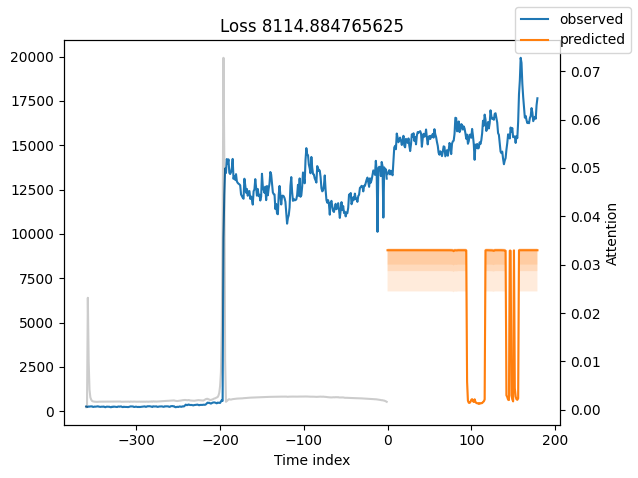

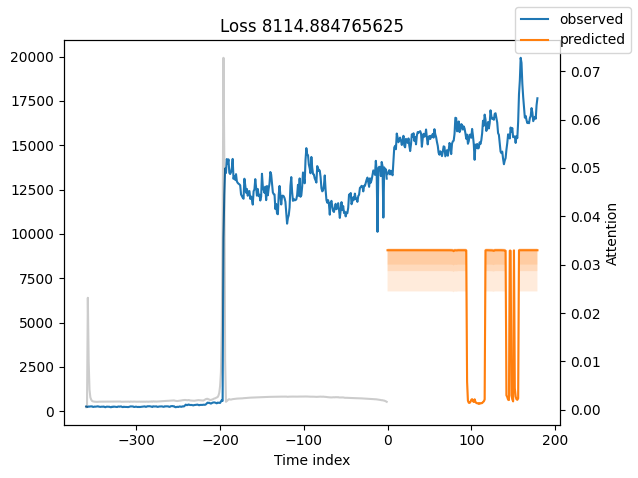

In [ ]:
raw_predictions12= best_tft12.predict(val_dataloader12, mode="raw", return_x=True)
best_tft12.plot_prediction(raw_predictions12.x, raw_predictions12.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


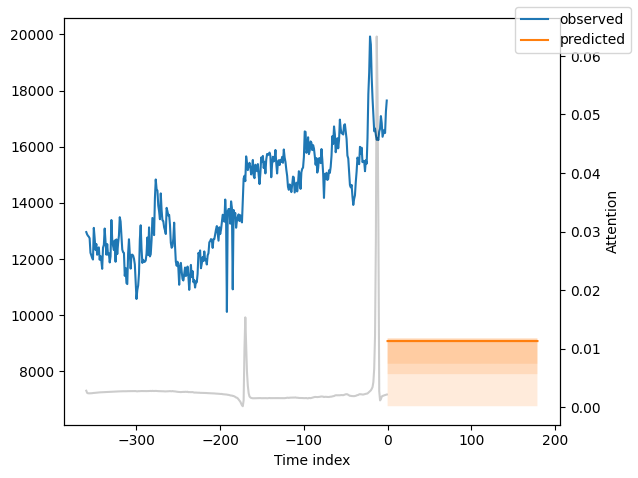

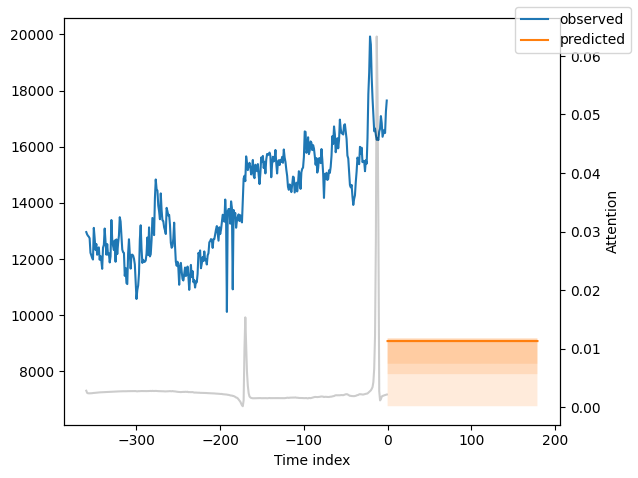

In [ ]:
new_raw_predictions12 = best_tft12.predict(test_dataloader12, mode="raw", return_x=True)
best_tft12.plot_prediction(new_raw_predictions12.x, new_raw_predictions12.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


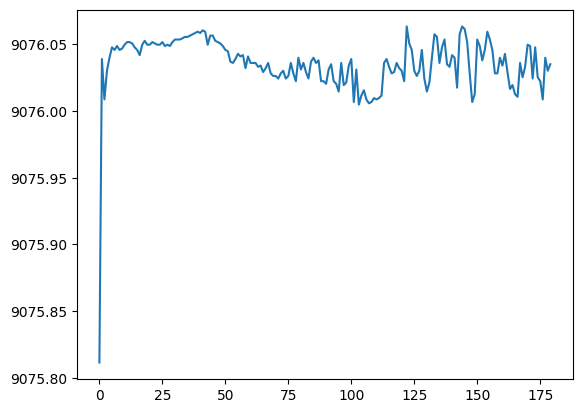

In [ ]:
new_raw_predictions12 = best_tft12.predict(test_dataloader12).to('cuda')
new_raw_predictions12 = new_raw_predictions12.cpu().numpy()
new_raw_predictions12 = new_raw_predictions12[0]
plt.plot(new_raw_predictions12)

In [ ]:
cluster12 = cluster[12][-180:].to_frame(name='original')
cluster12['prediction'] = new_raw_predictions12.tolist()
cluster12['MAPE'] = abs(cluster12.original-cluster12.prediction)/cluster12.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

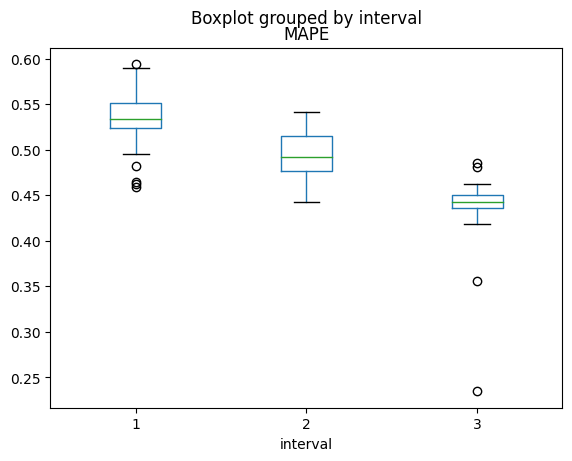

In [ ]:
cluster12['interval'] = cluster12.apply (lambda row: label_time(row), axis = 1)
cluster12.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape12 = cluster12['MAPE'].mean()
mape12

0.4895230357860089

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x525 with 1 Axes>,
 'decoder_variables': <Figure size 700x500 with 1 Axes>}

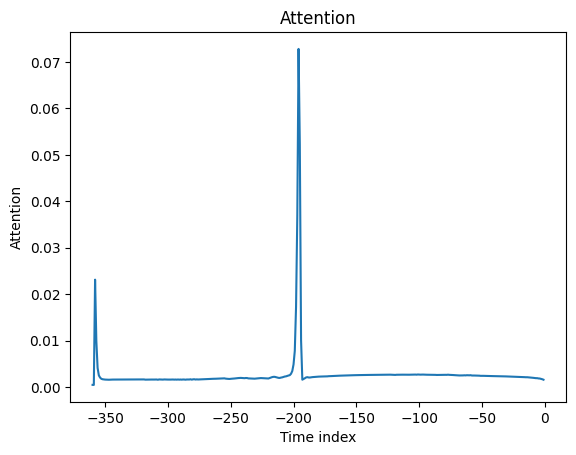

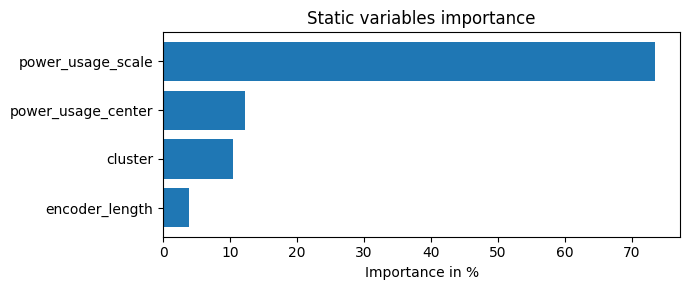

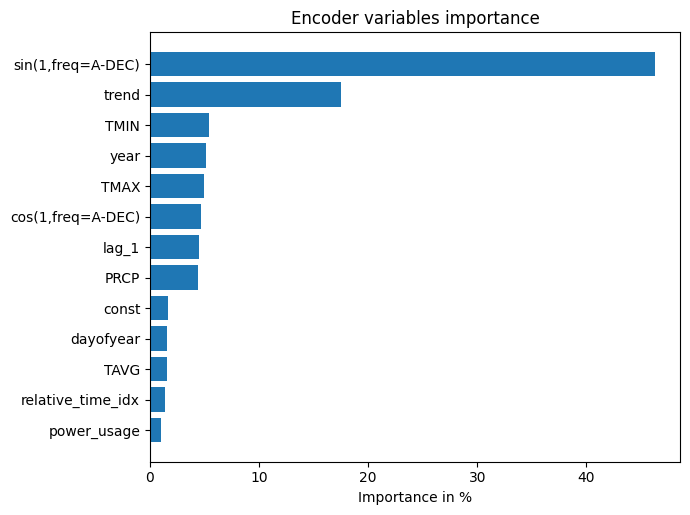

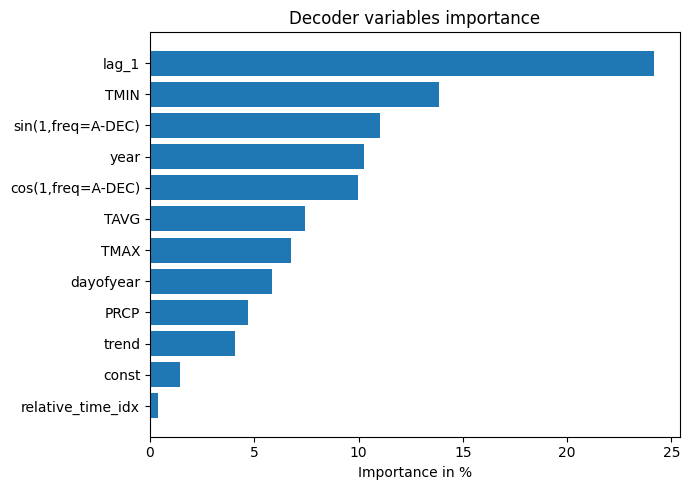

In [ ]:
interpretation12 = best_tft12.interpret_output(raw_predictions12.output, reduction="sum")
best_tft12.plot_interpretation(interpretation12)

## c11 TFT

In [ ]:
c11c = []
for i in c11.columns[1:-2]:
    c11c.append(i)
c11 = c11.fillna(0)
training11 = TimeSeriesDataSet(
    c11['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c11c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation11 = TimeSeriesDataSet.from_dataset(training11, c11[:-180], predict=True, stop_randomization=True)
test11 = TimeSeriesDataSet.from_dataset(validation11, c11, predict=True, stop_randomization=True)
train_dataloader11 = training11.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader11 = validation11.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader11 = test11.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals11 = torch.cat([y for x, (y, weight) in iter(val_dataloader11)]).to('cuda')
baseline_predictions11 = Baseline().predict(val_dataloader11).to('cuda')
((actuals11 - baseline_predictions11)/(actuals11)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.3501247763633728

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer11 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft11 = TemporalFusionTransformer.from_dataset(
    training11,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer11.fit(tft11,
    train_dataloaders=train_dataloader11,
    val_dataloaders=val_dataloader11)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 10.2 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.1 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.0 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 5238.659
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 5238.659


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.894 >= min_delta = 1. New best score: 5217.766
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.894 >= min_delta = 1. New best score: 5217.766


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.711 >= min_delta = 1. New best score: 5174.055
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.711 >= min_delta = 1. New best score: 5174.055


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 76.125 >= min_delta = 1. New best score: 5097.930
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 76.125 >= min_delta = 1. New best score: 5097.930


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 119.160 >= min_delta = 1. New best score: 4978.770
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 119.160 >= min_delta = 1. New best score: 4978.770


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 114.274 >= min_delta = 1. New best score: 4864.496
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 114.274 >= min_delta = 1. New best score: 4864.496


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 210.396 >= min_delta = 1. New best score: 4654.099
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 210.396 >= min_delta = 1. New best score: 4654.099


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 273.494 >= min_delta = 1. New best score: 4380.605
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 273.494 >= min_delta = 1. New best score: 4380.605


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 345.817 >= min_delta = 1. New best score: 4034.788
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 345.817 >= min_delta = 1. New best score: 4034.788


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 419.820 >= min_delta = 1. New best score: 3614.967
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 419.820 >= min_delta = 1. New best score: 3614.967


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 498.114 >= min_delta = 1. New best score: 3116.854
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 498.114 >= min_delta = 1. New best score: 3116.854


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 401.063 >= min_delta = 1. New best score: 2715.790
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 401.063 >= min_delta = 1. New best score: 2715.790


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 648.729 >= min_delta = 1. New best score: 2067.061
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 648.729 >= min_delta = 1. New best score: 2067.061


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 738.317 >= min_delta = 1. New best score: 1328.743
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 738.317 >= min_delta = 1. New best score: 1328.743


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 810.317 >= min_delta = 1. New best score: 518.426
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 810.317 >= min_delta = 1. New best score: 518.426


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 166.993 >= min_delta = 1. New best score: 351.434
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 166.993 >= min_delta = 1. New best score: 351.434


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 56.809 >= min_delta = 1. New best score: 294.625
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 56.809 >= min_delta = 1. New best score: 294.625


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 122.924 >= min_delta = 1. New best score: 171.701
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 122.924 >= min_delta = 1. New best score: 171.701


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 171.701. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 171.701. Signaling Trainer to stop.


In [ ]:
best_model_path11 = trainer11.checkpoint_callback.best_model_path
print(best_model_path11)
best_tft11= TemporalFusionTransformer.load_from_checkpoint(best_model_path11)
actuals11_p = torch.cat([y[0] for x, y in iter(val_dataloader11)]).to('cuda')
predictions11= best_tft11.predict(val_dataloader11).to('cuda')
((actuals11_p - predictions11)/(actuals11_p)).abs().mean().item()

lightning_logs/lightning_logs/version_3/checkpoints/epoch=30-step=589.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.08038961887359619

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


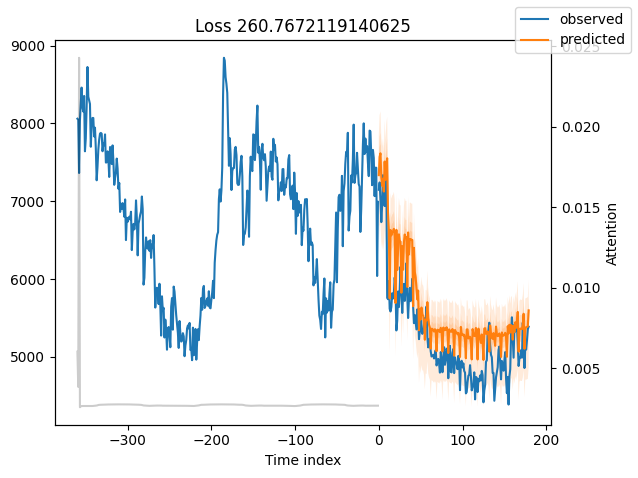

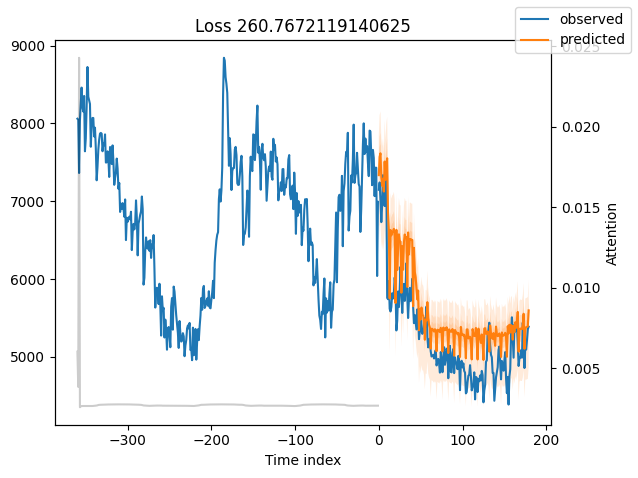

In [ ]:
raw_predictions11= best_tft11.predict(val_dataloader11, mode="raw", return_x=True)
best_tft11.plot_prediction(raw_predictions11.x, raw_predictions11.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


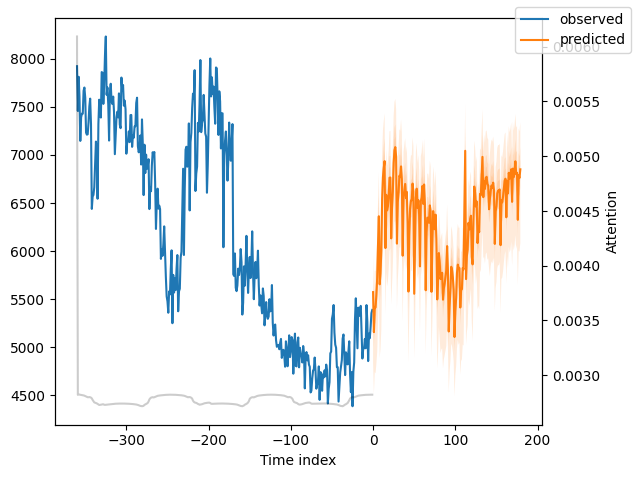

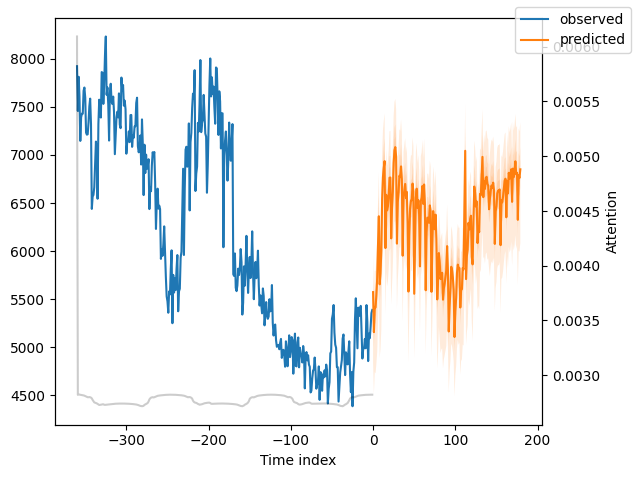

In [ ]:
new_raw_predictions11 = best_tft11.predict(test_dataloader11, mode="raw", return_x=True)
best_tft11.plot_prediction(new_raw_predictions11.x, new_raw_predictions11.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


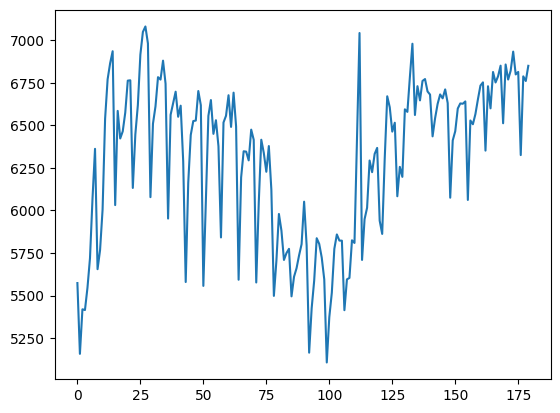

In [ ]:
new_raw_predictions11 = best_tft11.predict(test_dataloader11).to('cuda')
new_raw_predictions11 = new_raw_predictions11.cpu().numpy()
new_raw_predictions11 = new_raw_predictions11[0]
plt.plot(new_raw_predictions11)

In [ ]:
cluster11 = cluster[11][-180:].to_frame(name='original')
cluster11['prediction'] = new_raw_predictions11.tolist()
cluster11['MAPE'] = abs(cluster11.original-cluster11.prediction)/cluster11.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

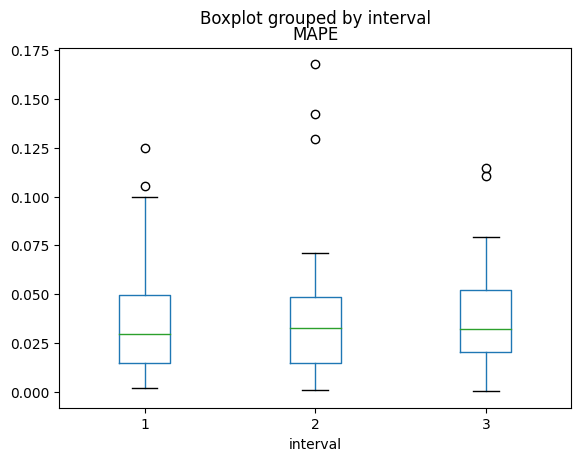

In [ ]:
cluster11['interval'] = cluster11.apply (lambda row: label_time(row), axis = 1)
cluster11.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape11 = cluster11['MAPE'].mean()
mape11

0.03705743559928562

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x925 with 1 Axes>,
 'decoder_variables': <Figure size 700x900 with 1 Axes>}

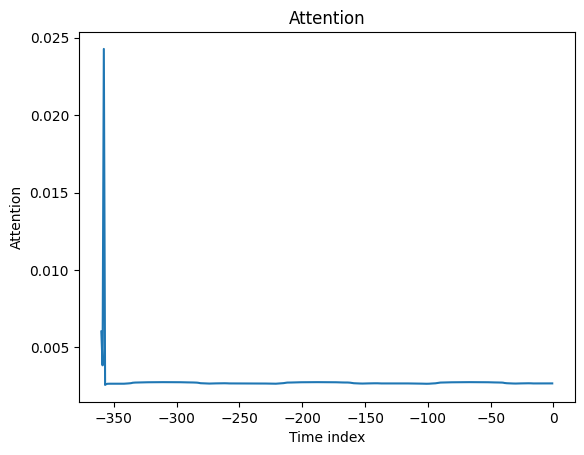

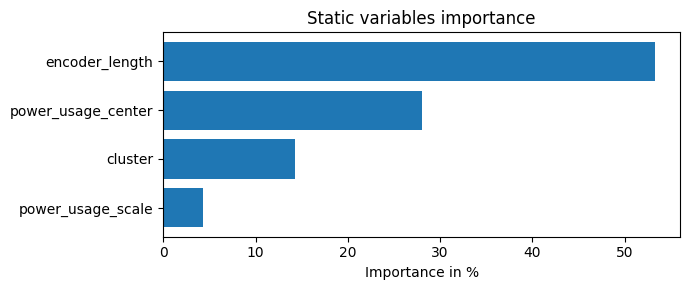

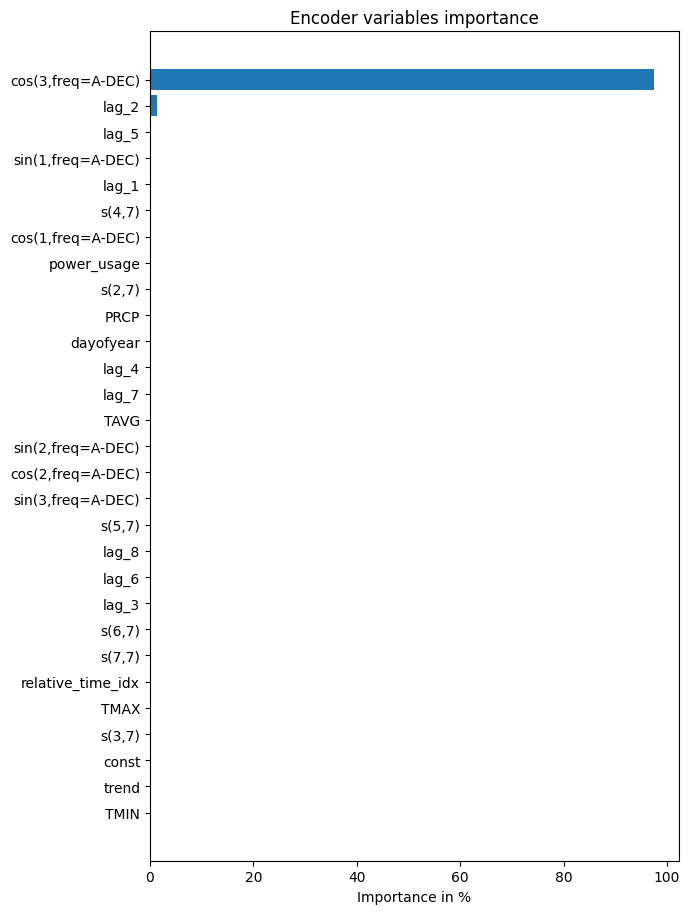

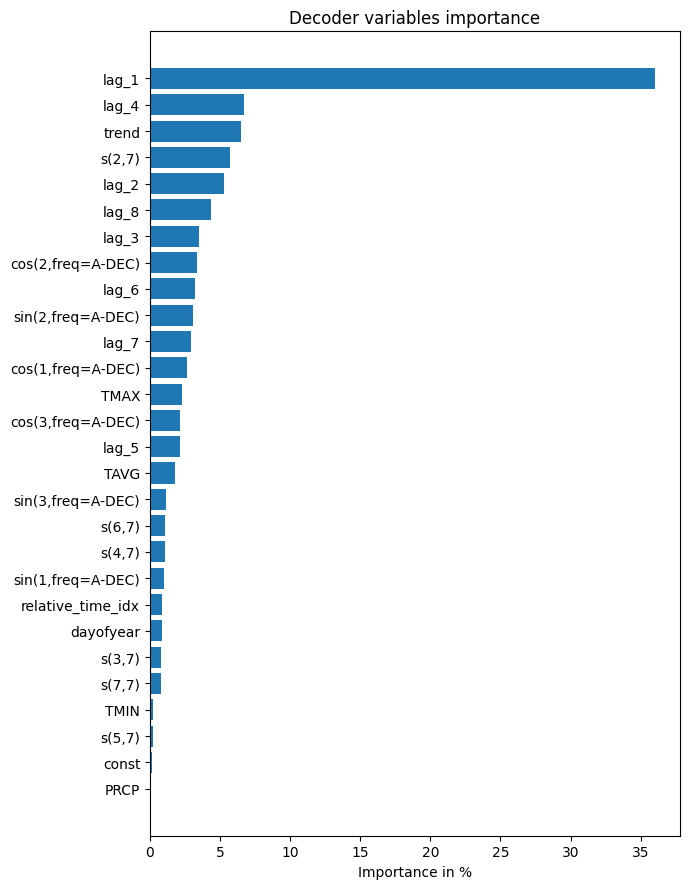

In [ ]:
interpretation11 = best_tft11.interpret_output(raw_predictions11.output, reduction="sum")
best_tft11.plot_interpretation(interpretation11)

## c10 TFT

In [ ]:
c10c = []
for i in c10.columns[1:-2]:
    c10c.append(i)
c10 = c10.fillna(0)
training10 = TimeSeriesDataSet(
    c10['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c10c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation10 = TimeSeriesDataSet.from_dataset(training10, c10[:-180], predict=True, stop_randomization=True)
test10 = TimeSeriesDataSet.from_dataset(validation10, c10, predict=True, stop_randomization=True)
train_dataloader10 = training10.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader10 = validation10.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader10 = test10.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals10 = torch.cat([y for x, (y, weight) in iter(val_dataloader10)]).to('cuda')
baseline_predictions10 = Baseline().predict(val_dataloader10).to('cuda')
((actuals10 - baseline_predictions10)/(actuals10)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.7169796824455261

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer10 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft10 = TemporalFusionTransformer.from_dataset(
    training10,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer10.fit(tft10,
    train_dataloaders=train_dataloader10,
    val_dataloaders=val_dataloader10)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 13.1 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 4.2 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 4.1 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 5600.014
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 5600.014


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 19.100 >= min_delta = 1. New best score: 5580.914
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 19.100 >= min_delta = 1. New best score: 5580.914


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 38.415 >= min_delta = 1. New best score: 5542.500
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 38.415 >= min_delta = 1. New best score: 5542.500


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 66.554 >= min_delta = 1. New best score: 5475.945
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 66.554 >= min_delta = 1. New best score: 5475.945


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.909 >= min_delta = 1. New best score: 5363.037
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.909 >= min_delta = 1. New best score: 5363.037


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 109.454 >= min_delta = 1. New best score: 5253.583
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 109.454 >= min_delta = 1. New best score: 5253.583


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 209.039 >= min_delta = 1. New best score: 5044.544
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 209.039 >= min_delta = 1. New best score: 5044.544


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 277.229 >= min_delta = 1. New best score: 4767.315
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 277.229 >= min_delta = 1. New best score: 4767.315


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 316.297 >= min_delta = 1. New best score: 4451.019
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 316.297 >= min_delta = 1. New best score: 4451.019


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 339.224 >= min_delta = 1. New best score: 4111.795
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 339.224 >= min_delta = 1. New best score: 4111.795


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 386.916 >= min_delta = 1. New best score: 3724.879
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 386.916 >= min_delta = 1. New best score: 3724.879


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 302.902 >= min_delta = 1. New best score: 3421.977
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 302.902 >= min_delta = 1. New best score: 3421.977


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 458.838 >= min_delta = 1. New best score: 2963.139
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 458.838 >= min_delta = 1. New best score: 2963.139


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 457.448 >= min_delta = 1. New best score: 2505.691
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 457.448 >= min_delta = 1. New best score: 2505.691


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 486.897 >= min_delta = 1. New best score: 2018.795
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 486.897 >= min_delta = 1. New best score: 2018.795


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 479.848 >= min_delta = 1. New best score: 1538.947
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 479.848 >= min_delta = 1. New best score: 1538.947


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 326.279 >= min_delta = 1. New best score: 1212.668
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 326.279 >= min_delta = 1. New best score: 1212.668


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.614 >= min_delta = 1. New best score: 1169.054
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.614 >= min_delta = 1. New best score: 1169.054


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 182.446 >= min_delta = 1. New best score: 986.608
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 182.446 >= min_delta = 1. New best score: 986.608


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 159.184 >= min_delta = 1. New best score: 827.423
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 159.184 >= min_delta = 1. New best score: 827.423


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 57.281 >= min_delta = 1. New best score: 770.142
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 57.281 >= min_delta = 1. New best score: 770.142


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 53.966 >= min_delta = 1. New best score: 716.176
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 53.966 >= min_delta = 1. New best score: 716.176


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 75.276 >= min_delta = 1. New best score: 640.900
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 75.276 >= min_delta = 1. New best score: 640.900


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 26.554 >= min_delta = 1. New best score: 614.346
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 26.554 >= min_delta = 1. New best score: 614.346


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 7.753 >= min_delta = 1. New best score: 606.594
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 7.753 >= min_delta = 1. New best score: 606.594


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 10.146 >= min_delta = 1. New best score: 596.448
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 10.146 >= min_delta = 1. New best score: 596.448


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 5.227 >= min_delta = 1. New best score: 591.221
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 5.227 >= min_delta = 1. New best score: 591.221


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 25.798 >= min_delta = 1. New best score: 565.423
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 25.798 >= min_delta = 1. New best score: 565.423


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3.004 >= min_delta = 1. New best score: 562.419
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3.004 >= min_delta = 1. New best score: 562.419


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 562.419. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 562.419. Signaling Trainer to stop.


In [ ]:
best_model_path10 = trainer10.checkpoint_callback.best_model_path
print(best_model_path10)
best_tft10= TemporalFusionTransformer.load_from_checkpoint(best_model_path10)
actuals10_p = torch.cat([y[0] for x, y in iter(val_dataloader10)]).to('cuda')
predictions10 = best_tft10.predict(val_dataloader10).to('cuda')
((actuals10_p - predictions10)/(actuals10_p)).abs().mean().item()

lightning_logs/lightning_logs/version_4/checkpoints/epoch=39-step=760.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.2335413098335266

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


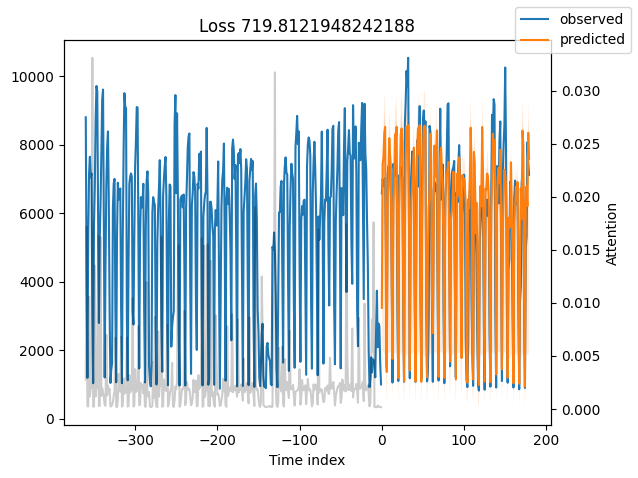

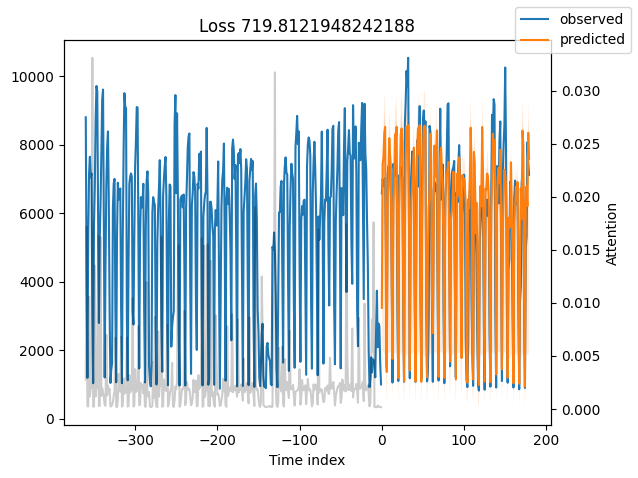

In [ ]:
raw_predictions10= best_tft10.predict(val_dataloader10, mode="raw", return_x=True)
best_tft10.plot_prediction(raw_predictions10.x, raw_predictions10.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


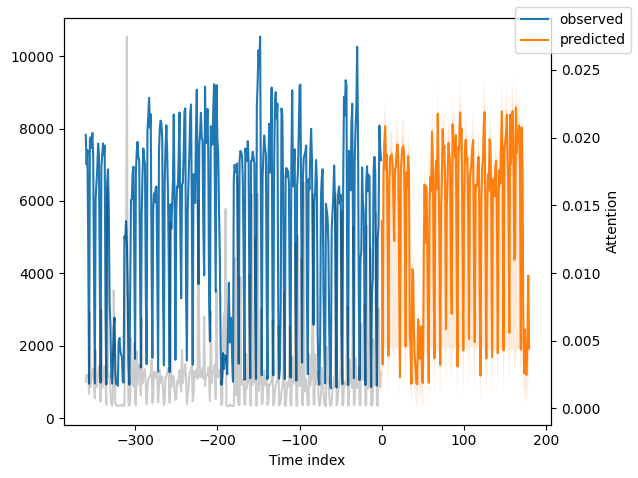

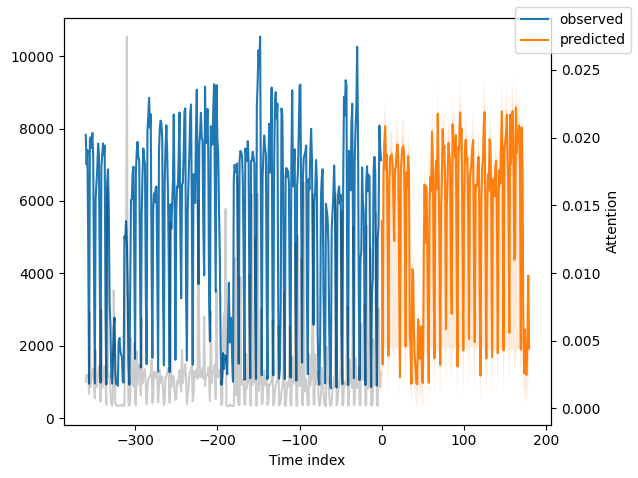

In [ ]:
new_raw_predictions10 = best_tft10.predict(test_dataloader10, mode="raw", return_x=True)
best_tft10.plot_prediction(new_raw_predictions10.x, new_raw_predictions10.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


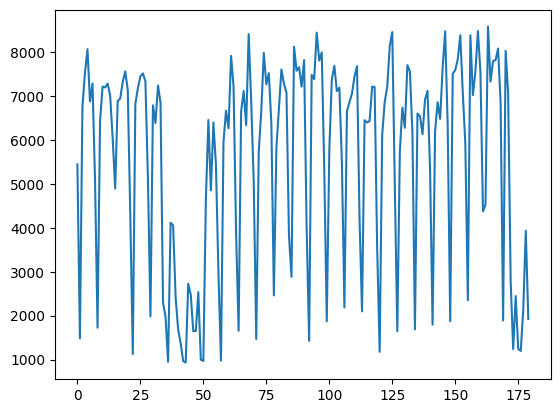

In [ ]:
new_raw_predictions10 = best_tft10.predict(test_dataloader10).to('cuda')
new_raw_predictions10 = new_raw_predictions10.cpu().numpy()
new_raw_predictions10 = new_raw_predictions10[0]
plt.plot(new_raw_predictions10)

In [ ]:
cluster10 = cluster[10][-180:].to_frame(name='original')
cluster10['prediction'] = new_raw_predictions10.tolist()
cluster10['MAPE'] = abs(cluster10.original-cluster10.prediction)/cluster10.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

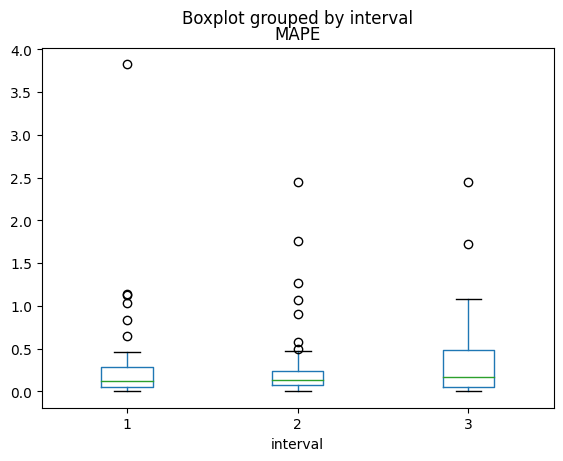

In [ ]:
cluster10['interval'] = cluster10.apply (lambda row: label_time(row), axis = 1)
cluster10.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape10 = cluster10['MAPE'].mean()
mape10

0.29921150156134046

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x1150 with 1 Axes>,
 'decoder_variables': <Figure size 700x1125 with 1 Axes>}

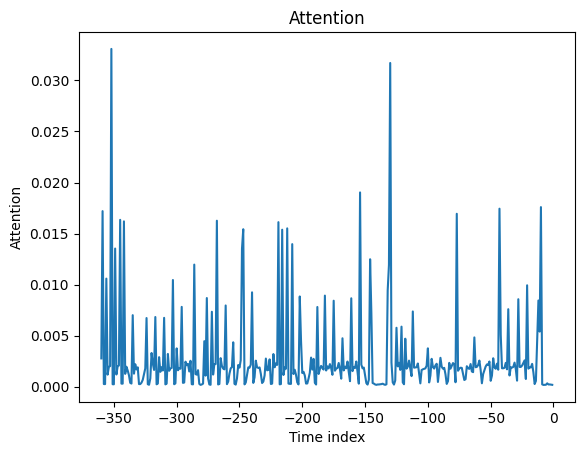

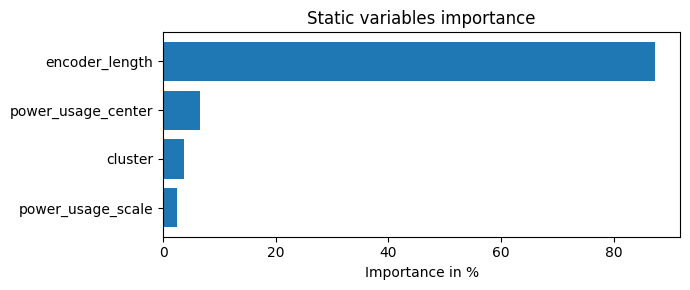

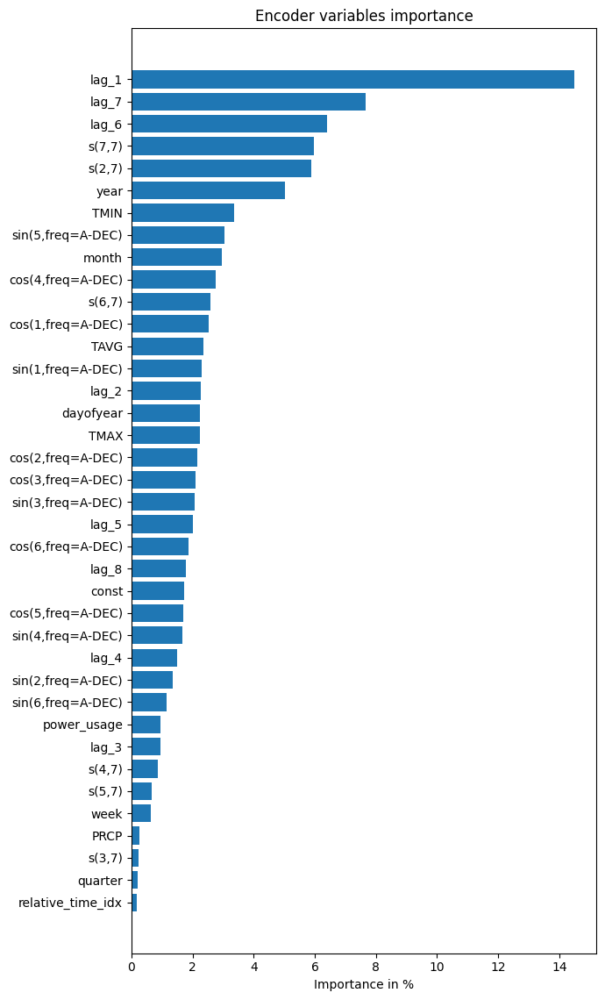

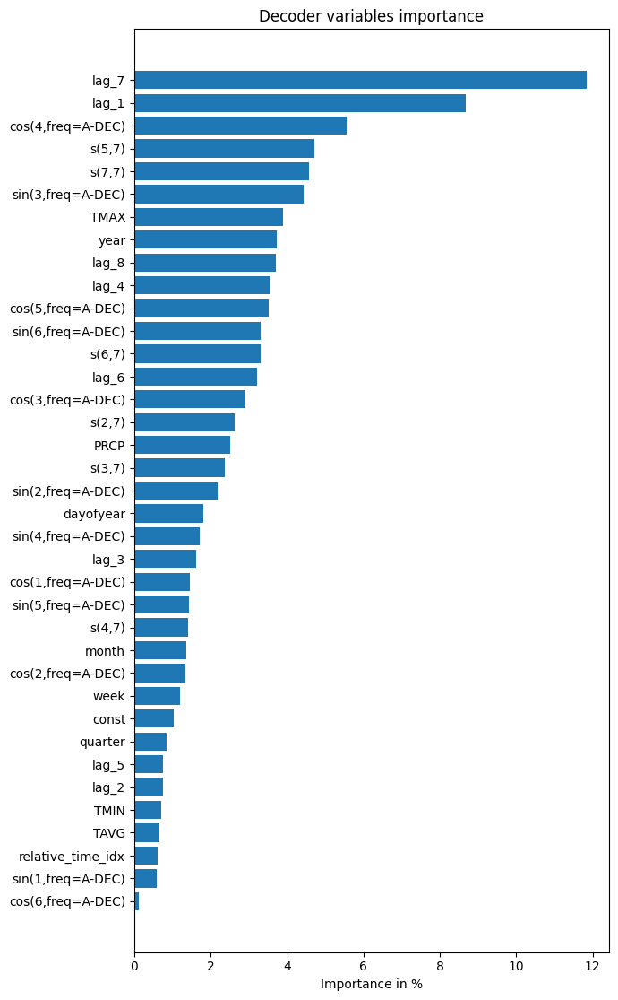

In [ ]:
interpretation10 = best_tft10.interpret_output(raw_predictions10.output, reduction="sum")
best_tft10.plot_interpretation(interpretation10)

## c9 TFT

In [ ]:
c9c = []
for i in c9.columns[1:-2]:
    c9c.append(i)
c9 = c9.fillna(0)
training9 = TimeSeriesDataSet(
    c9['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c9c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation9 = TimeSeriesDataSet.from_dataset(training9, c9[:-180], predict=True, stop_randomization=True)
test9 = TimeSeriesDataSet.from_dataset(validation9, c9, predict=True, stop_randomization=True)
train_dataloader9 = training9.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader9 = validation9.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader9 = test9.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals9 = torch.cat([y for x, (y, weight) in iter(val_dataloader9)]).to('cuda')
baseline_predictions9 = Baseline().predict(val_dataloader9).to('cuda')
((actuals9 - baseline_predictions9)/(actuals9)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.27545854449272156

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer9 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft9 = TemporalFusionTransformer.from_dataset(
    training9,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer9.fit(tft9,
    train_dataloaders=train_dataloader9,
    val_dataloaders=val_dataloader9)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 7.7 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 2.3 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.1 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 6591.539
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 6591.539


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 18.996 >= min_delta = 1. New best score: 6572.543
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 18.996 >= min_delta = 1. New best score: 6572.543


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 39.796 >= min_delta = 1. New best score: 6532.747
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 39.796 >= min_delta = 1. New best score: 6532.747


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 72.179 >= min_delta = 1. New best score: 6460.568
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 72.179 >= min_delta = 1. New best score: 6460.568


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 113.890 >= min_delta = 1. New best score: 6346.678
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 113.890 >= min_delta = 1. New best score: 6346.678


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 110.283 >= min_delta = 1. New best score: 6236.395
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 110.283 >= min_delta = 1. New best score: 6236.395


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 203.718 >= min_delta = 1. New best score: 6032.676
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 203.718 >= min_delta = 1. New best score: 6032.676


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 267.367 >= min_delta = 1. New best score: 5765.310
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 267.367 >= min_delta = 1. New best score: 5765.310


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 339.922 >= min_delta = 1. New best score: 5425.388
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 339.922 >= min_delta = 1. New best score: 5425.388


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 416.506 >= min_delta = 1. New best score: 5008.882
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 416.506 >= min_delta = 1. New best score: 5008.882


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 502.984 >= min_delta = 1. New best score: 4505.897
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 502.984 >= min_delta = 1. New best score: 4505.897


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 408.355 >= min_delta = 1. New best score: 4097.542
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 408.355 >= min_delta = 1. New best score: 4097.542


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 663.871 >= min_delta = 1. New best score: 3433.671
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 663.871 >= min_delta = 1. New best score: 3433.671


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 736.998 >= min_delta = 1. New best score: 2696.673
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 736.998 >= min_delta = 1. New best score: 2696.673


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 572.183 >= min_delta = 1. New best score: 2124.490
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 572.183 >= min_delta = 1. New best score: 2124.490


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 383.233 >= min_delta = 1. New best score: 1741.257
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 383.233 >= min_delta = 1. New best score: 1741.257


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 192.891 >= min_delta = 1. New best score: 1548.366
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 192.891 >= min_delta = 1. New best score: 1548.366


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 107.287 >= min_delta = 1. New best score: 1441.079
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 107.287 >= min_delta = 1. New best score: 1441.079


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 484.124 >= min_delta = 1. New best score: 956.955
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 484.124 >= min_delta = 1. New best score: 956.955


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 163.333 >= min_delta = 1. New best score: 793.621
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 163.333 >= min_delta = 1. New best score: 793.621


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 192.795 >= min_delta = 1. New best score: 600.826
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 192.795 >= min_delta = 1. New best score: 600.826


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.060 >= min_delta = 1. New best score: 580.766
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.060 >= min_delta = 1. New best score: 580.766


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 85.123 >= min_delta = 1. New best score: 495.643
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 85.123 >= min_delta = 1. New best score: 495.643


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 13.850 >= min_delta = 1. New best score: 481.792
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 13.850 >= min_delta = 1. New best score: 481.792


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 78.337 >= min_delta = 1. New best score: 403.455
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 78.337 >= min_delta = 1. New best score: 403.455


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 403.455. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 403.455. Signaling Trainer to stop.


In [ ]:
best_model_path9 = trainer9.checkpoint_callback.best_model_path
print(best_model_path9)
best_tft9= TemporalFusionTransformer.load_from_checkpoint(best_model_path9)
actuals9_p = torch.cat([y[0] for x, y in iter(val_dataloader9)]).to('cuda')
predictions9 = best_tft9.predict(val_dataloader9).to('cuda')
((actuals9_p - predictions9)/(actuals9_p)).abs().mean().item()

lightning_logs/lightning_logs/version_5/checkpoints/epoch=34-step=665.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.12814563512802124

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


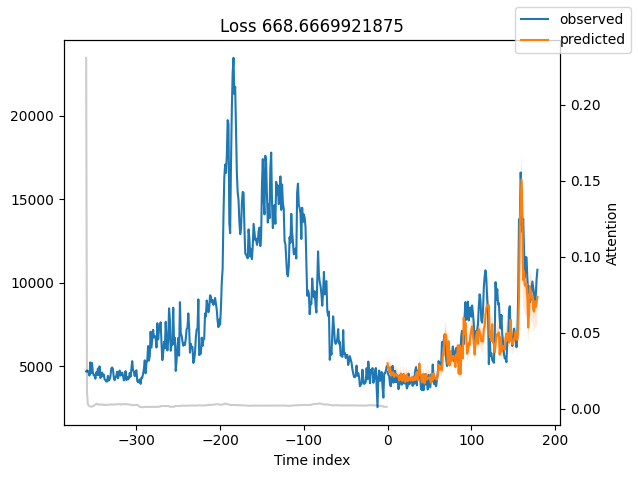

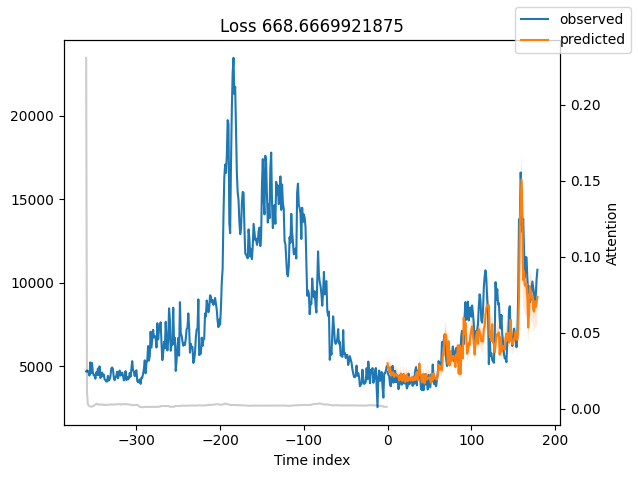

In [ ]:
raw_predictions9= best_tft9.predict(val_dataloader9, mode="raw", return_x=True)
best_tft9.plot_prediction(raw_predictions9.x, raw_predictions9.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


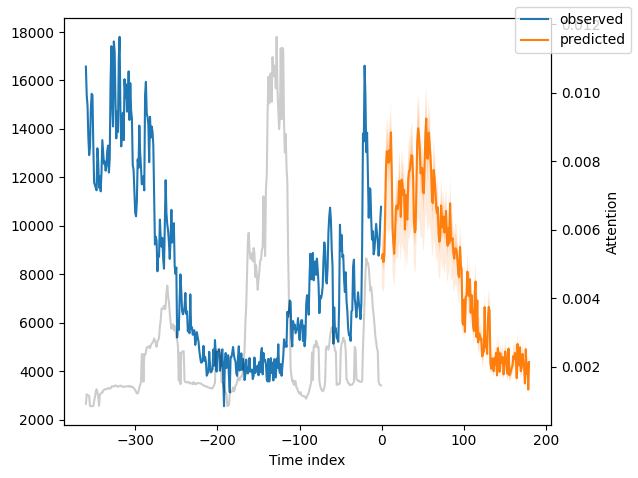

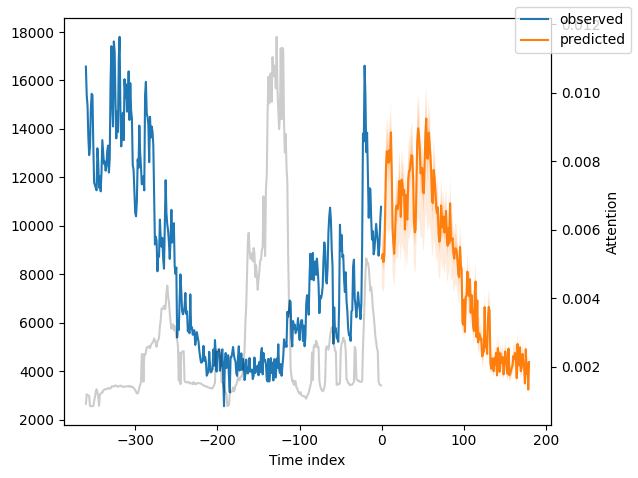

In [ ]:
new_raw_predictions9 = best_tft9.predict(test_dataloader9, mode="raw", return_x=True)
best_tft9.plot_prediction(new_raw_predictions9.x, new_raw_predictions9.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


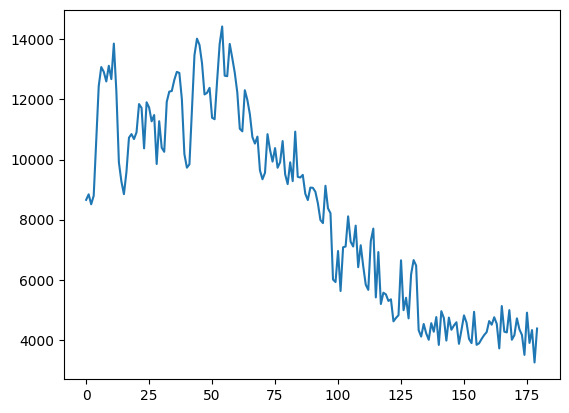

In [ ]:
new_raw_predictions9 = best_tft9.predict(test_dataloader9).to('cuda')
new_raw_predictions9 = new_raw_predictions9.cpu().numpy()
new_raw_predictions9 = new_raw_predictions9[0]
plt.plot(new_raw_predictions9)

In [ ]:
cluster9 = cluster[9][-180:].to_frame(name='original')
cluster9['prediction'] = new_raw_predictions9.tolist()
cluster9['MAPE'] = abs(cluster9.original-cluster9.prediction)/cluster9.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

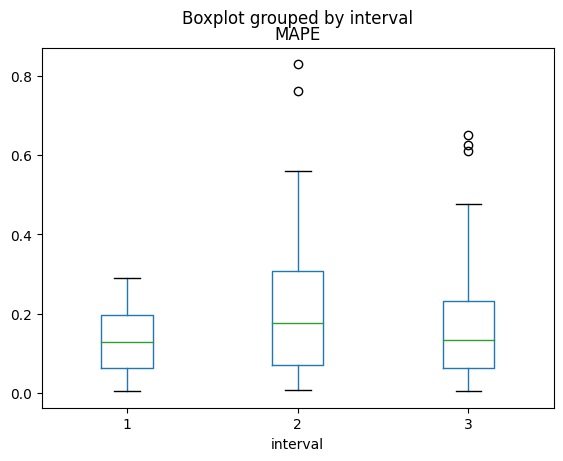

In [ ]:
cluster9['interval'] = cluster9.apply (lambda row: label_time(row), axis = 1)
cluster9.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape9 = cluster9['MAPE'].mean()
mape9

0.17367580039277464

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x725 with 1 Axes>,
 'decoder_variables': <Figure size 700x700 with 1 Axes>}

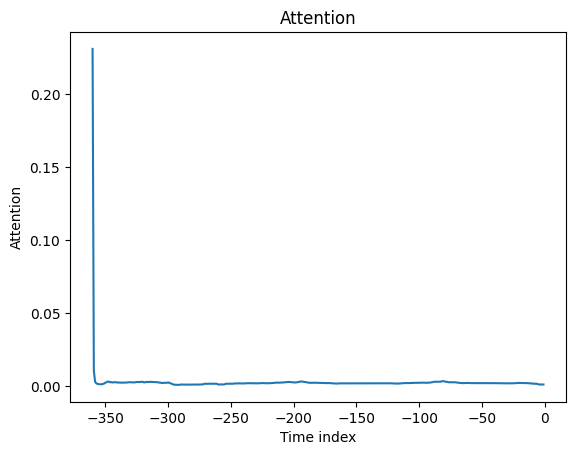

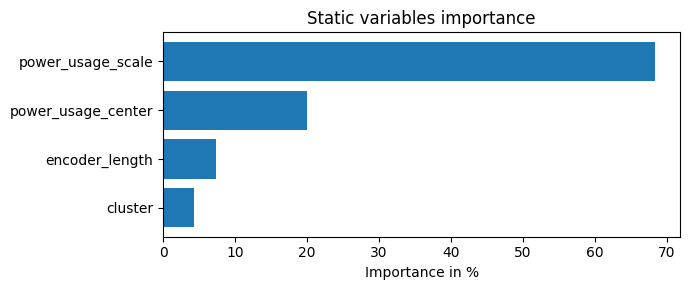

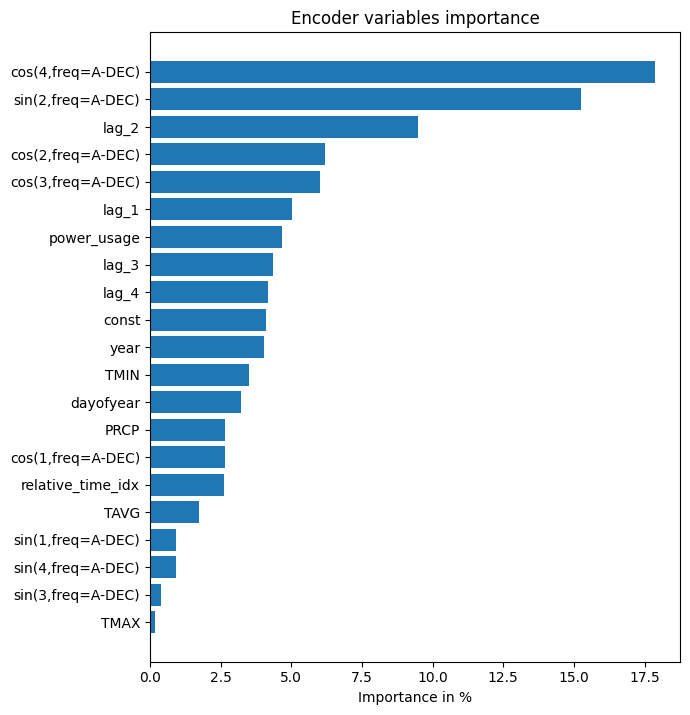

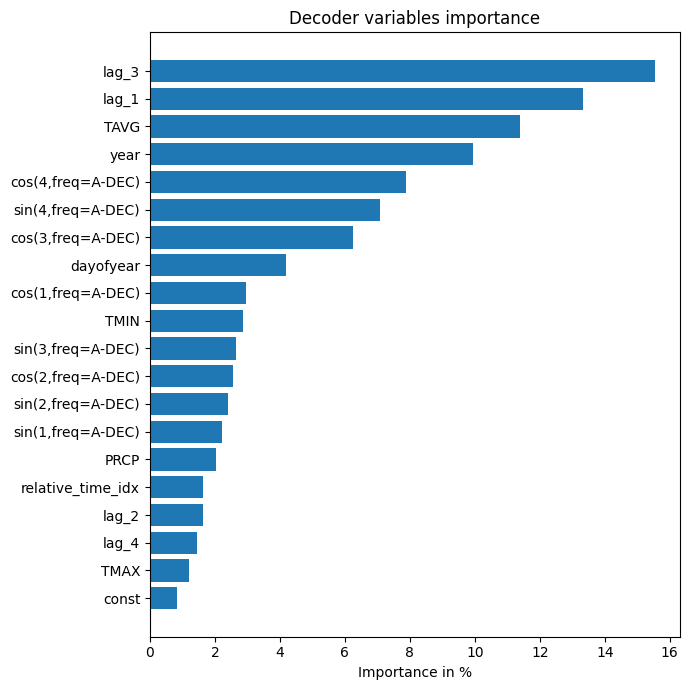

In [ ]:
interpretation9 = best_tft9.interpret_output(raw_predictions9.output, reduction="sum")
best_tft9.plot_interpretation(interpretation9)

## c8 TFT

In [ ]:
c8c = []
for i in c8.columns[1:-2]:
    c8c.append(i)
c8 = c8.fillna(0)
training8 = TimeSeriesDataSet(
    c8['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c8c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation8 = TimeSeriesDataSet.from_dataset(training8, c8[:-180], predict=True, stop_randomization=True)
test8 = TimeSeriesDataSet.from_dataset(validation8, c8, predict=True, stop_randomization=True)
train_dataloader8 = training8.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader8 = validation8.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader8 = test8.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals8 = torch.cat([y for x, (y, weight) in iter(val_dataloader8)]).to('cuda')
baseline_predictions8 = Baseline().predict(val_dataloader8).to('cuda')
((actuals8 - baseline_predictions8)/(actuals8)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.1524602174758911

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer8 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft8 = TemporalFusionTransformer.from_dataset(
    training8,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer8.fit(tft8,
    train_dataloaders=train_dataloader8,
    val_dataloaders=val_dataloader8)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 9.9 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.0 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.9 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 124077.664
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 124077.664


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.711 >= min_delta = 1. New best score: 124056.953
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.711 >= min_delta = 1. New best score: 124056.953


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 41.484 >= min_delta = 1. New best score: 124015.469
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 41.484 >= min_delta = 1. New best score: 124015.469


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 68.602 >= min_delta = 1. New best score: 123946.867
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 68.602 >= min_delta = 1. New best score: 123946.867


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 105.625 >= min_delta = 1. New best score: 123841.242
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 105.625 >= min_delta = 1. New best score: 123841.242


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 100.023 >= min_delta = 1. New best score: 123741.219
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 100.023 >= min_delta = 1. New best score: 123741.219


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 153.797 >= min_delta = 1. New best score: 123587.422
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 153.797 >= min_delta = 1. New best score: 123587.422


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 200.953 >= min_delta = 1. New best score: 123386.469
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 200.953 >= min_delta = 1. New best score: 123386.469


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 263.328 >= min_delta = 1. New best score: 123123.141
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 263.328 >= min_delta = 1. New best score: 123123.141


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 264.031 >= min_delta = 1. New best score: 122859.109
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 264.031 >= min_delta = 1. New best score: 122859.109


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 267.398 >= min_delta = 1. New best score: 122591.711
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 267.398 >= min_delta = 1. New best score: 122591.711


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 263.688 >= min_delta = 1. New best score: 122328.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 263.688 >= min_delta = 1. New best score: 122328.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 496.391 >= min_delta = 1. New best score: 121831.633
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 496.391 >= min_delta = 1. New best score: 121831.633


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 589.656 >= min_delta = 1. New best score: 121241.977
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 589.656 >= min_delta = 1. New best score: 121241.977


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 620.055 >= min_delta = 1. New best score: 120621.922
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 620.055 >= min_delta = 1. New best score: 120621.922


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 640.078 >= min_delta = 1. New best score: 119981.844
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 640.078 >= min_delta = 1. New best score: 119981.844


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 749.219 >= min_delta = 1. New best score: 119232.625
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 749.219 >= min_delta = 1. New best score: 119232.625


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 564.422 >= min_delta = 1. New best score: 118668.203
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 564.422 >= min_delta = 1. New best score: 118668.203


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 732.758 >= min_delta = 1. New best score: 117935.445
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 732.758 >= min_delta = 1. New best score: 117935.445


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 777.312 >= min_delta = 1. New best score: 117158.133
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 777.312 >= min_delta = 1. New best score: 117158.133


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 966.898 >= min_delta = 1. New best score: 116191.234
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 966.898 >= min_delta = 1. New best score: 116191.234


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1000.023 >= min_delta = 1. New best score: 115191.211
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1000.023 >= min_delta = 1. New best score: 115191.211


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1113.141 >= min_delta = 1. New best score: 114078.070
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1113.141 >= min_delta = 1. New best score: 114078.070


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 968.406 >= min_delta = 1. New best score: 113109.664
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 968.406 >= min_delta = 1. New best score: 113109.664


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1428.953 >= min_delta = 1. New best score: 111680.711
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1428.953 >= min_delta = 1. New best score: 111680.711


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1612.203 >= min_delta = 1. New best score: 110068.508
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1612.203 >= min_delta = 1. New best score: 110068.508


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1572.016 >= min_delta = 1. New best score: 108496.492
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1572.016 >= min_delta = 1. New best score: 108496.492


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1451.445 >= min_delta = 1. New best score: 107045.047
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1451.445 >= min_delta = 1. New best score: 107045.047


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1730.359 >= min_delta = 1. New best score: 105314.688
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1730.359 >= min_delta = 1. New best score: 105314.688


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1207.273 >= min_delta = 1. New best score: 104107.414
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1207.273 >= min_delta = 1. New best score: 104107.414


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1745.344 >= min_delta = 1. New best score: 102362.070
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1745.344 >= min_delta = 1. New best score: 102362.070


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1845.203 >= min_delta = 1. New best score: 100516.867
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1845.203 >= min_delta = 1. New best score: 100516.867


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1988.711 >= min_delta = 1. New best score: 98528.156
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1988.711 >= min_delta = 1. New best score: 98528.156


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2517.875 >= min_delta = 1. New best score: 96010.281
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2517.875 >= min_delta = 1. New best score: 96010.281


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2885.867 >= min_delta = 1. New best score: 93124.414
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2885.867 >= min_delta = 1. New best score: 93124.414


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1899.305 >= min_delta = 1. New best score: 91225.109
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1899.305 >= min_delta = 1. New best score: 91225.109


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2727.812 >= min_delta = 1. New best score: 88497.297
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2727.812 >= min_delta = 1. New best score: 88497.297


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3047.586 >= min_delta = 1. New best score: 85449.711
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3047.586 >= min_delta = 1. New best score: 85449.711


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2914.719 >= min_delta = 1. New best score: 82534.992
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2914.719 >= min_delta = 1. New best score: 82534.992


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2651.562 >= min_delta = 1. New best score: 79883.430
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2651.562 >= min_delta = 1. New best score: 79883.430


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2686.195 >= min_delta = 1. New best score: 77197.234
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2686.195 >= min_delta = 1. New best score: 77197.234


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2295.484 >= min_delta = 1. New best score: 74901.750
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2295.484 >= min_delta = 1. New best score: 74901.750


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3770.422 >= min_delta = 1. New best score: 71131.328
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3770.422 >= min_delta = 1. New best score: 71131.328


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3836.695 >= min_delta = 1. New best score: 67294.633
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3836.695 >= min_delta = 1. New best score: 67294.633


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3789.531 >= min_delta = 1. New best score: 63505.102
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3789.531 >= min_delta = 1. New best score: 63505.102


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3886.789 >= min_delta = 1. New best score: 59618.312
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3886.789 >= min_delta = 1. New best score: 59618.312


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4048.801 >= min_delta = 1. New best score: 55569.512
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4048.801 >= min_delta = 1. New best score: 55569.512


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2980.395 >= min_delta = 1. New best score: 52589.117
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2980.395 >= min_delta = 1. New best score: 52589.117


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4427.227 >= min_delta = 1. New best score: 48161.891
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4427.227 >= min_delta = 1. New best score: 48161.891


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4696.980 >= min_delta = 1. New best score: 43464.910
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4696.980 >= min_delta = 1. New best score: 43464.910


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4416.371 >= min_delta = 1. New best score: 39048.539
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4416.371 >= min_delta = 1. New best score: 39048.539


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4642.883 >= min_delta = 1. New best score: 34405.656
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4642.883 >= min_delta = 1. New best score: 34405.656


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4419.906 >= min_delta = 1. New best score: 29985.750
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4419.906 >= min_delta = 1. New best score: 29985.750


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3251.105 >= min_delta = 1. New best score: 26734.645
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3251.105 >= min_delta = 1. New best score: 26734.645


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4281.619 >= min_delta = 1. New best score: 22453.025
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4281.619 >= min_delta = 1. New best score: 22453.025


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3441.273 >= min_delta = 1. New best score: 19011.752
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3441.273 >= min_delta = 1. New best score: 19011.752


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3046.088 >= min_delta = 1. New best score: 15965.664
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3046.088 >= min_delta = 1. New best score: 15965.664


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2272.211 >= min_delta = 1. New best score: 13693.453
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2272.211 >= min_delta = 1. New best score: 13693.453


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1726.295 >= min_delta = 1. New best score: 11967.158
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1726.295 >= min_delta = 1. New best score: 11967.158


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1594.642 >= min_delta = 1. New best score: 10372.517
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1594.642 >= min_delta = 1. New best score: 10372.517


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 507.928 >= min_delta = 1. New best score: 9864.589
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 507.928 >= min_delta = 1. New best score: 9864.589


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1098.164 >= min_delta = 1. New best score: 8766.425
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1098.164 >= min_delta = 1. New best score: 8766.425


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1729.158 >= min_delta = 1. New best score: 7037.267
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1729.158 >= min_delta = 1. New best score: 7037.267


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 674.562 >= min_delta = 1. New best score: 6362.705
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 674.562 >= min_delta = 1. New best score: 6362.705


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 877.487 >= min_delta = 1. New best score: 5485.218
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 877.487 >= min_delta = 1. New best score: 5485.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 222.416 >= min_delta = 1. New best score: 5262.803
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 222.416 >= min_delta = 1. New best score: 5262.803


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 318.528 >= min_delta = 1. New best score: 4944.274
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 318.528 >= min_delta = 1. New best score: 4944.274


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 103.926 >= min_delta = 1. New best score: 4840.349
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 103.926 >= min_delta = 1. New best score: 4840.349


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 62.297 >= min_delta = 1. New best score: 4778.052
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 62.297 >= min_delta = 1. New best score: 4778.052


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 4778.052. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 4778.052. Signaling Trainer to stop.


In [ ]:
best_model_path8 = trainer8.checkpoint_callback.best_model_path
print(best_model_path8)
best_tft8= TemporalFusionTransformer.load_from_checkpoint(best_model_path8)
actuals8_p = torch.cat([y[0] for x, y in iter(val_dataloader8)]).to('cuda')
predictions8 = best_tft8.predict(val_dataloader8).to('cuda')
((actuals8_p - predictions8)/(actuals8_p)).abs().mean().item()

lightning_logs/lightning_logs/version_6/checkpoints/epoch=81-step=1558.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.07576242089271545

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


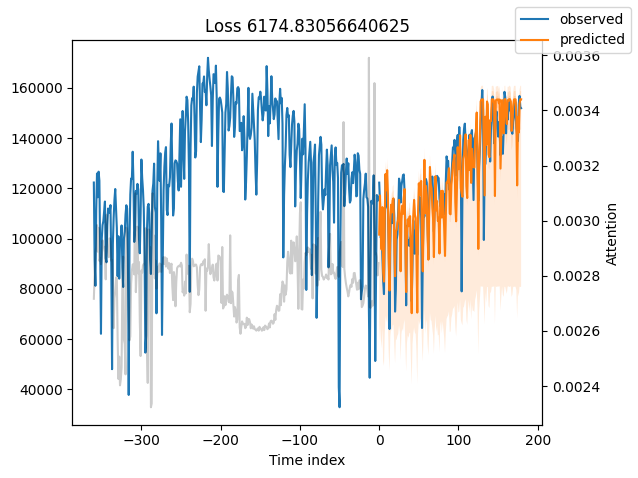

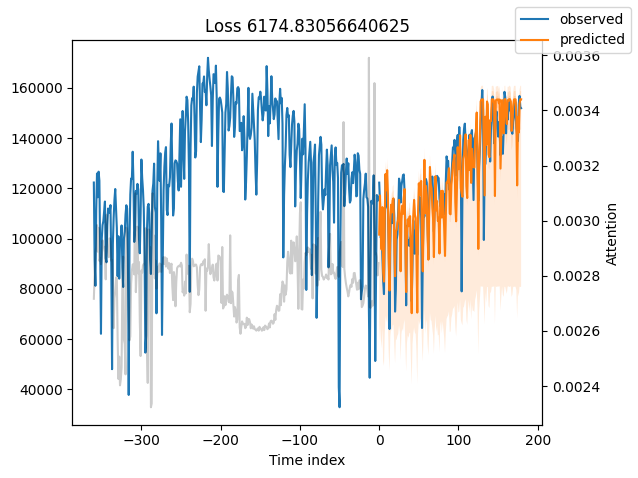

In [ ]:
raw_predictions8= best_tft8.predict(val_dataloader8, mode="raw", return_x=True)
best_tft8.plot_prediction(raw_predictions8.x, raw_predictions8.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


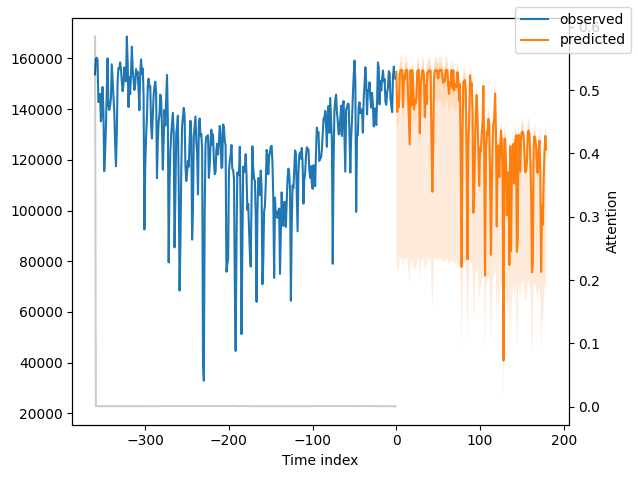

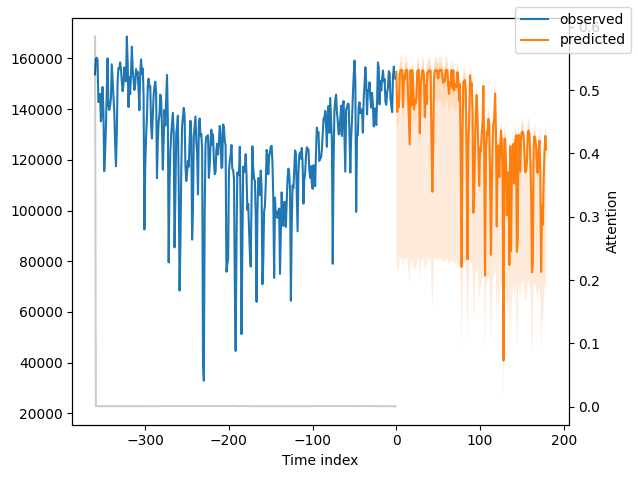

In [ ]:
new_raw_predictions8 = best_tft8.predict(test_dataloader8, mode="raw", return_x=True)
best_tft8.plot_prediction(new_raw_predictions8.x, new_raw_predictions8.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


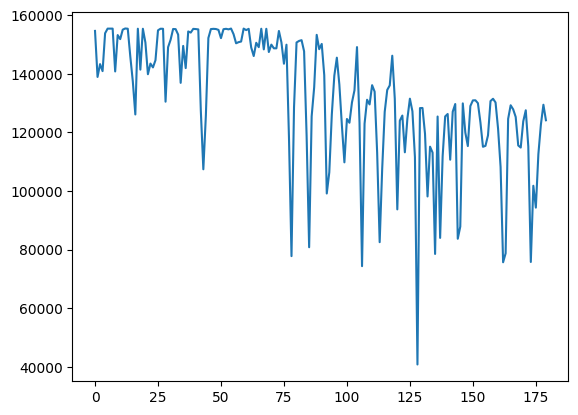

In [ ]:
new_raw_predictions8 = best_tft8.predict(test_dataloader8).to('cuda')
new_raw_predictions8 = new_raw_predictions8.cpu().numpy()
new_raw_predictions8 = new_raw_predictions8[0]
plt.plot(new_raw_predictions8)

In [ ]:
cluster8 = cluster[8][-180:].to_frame(name='original')
cluster8['prediction'] = new_raw_predictions8.tolist()
cluster8['MAPE'] = abs(cluster8.original-cluster8.prediction)/cluster8.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

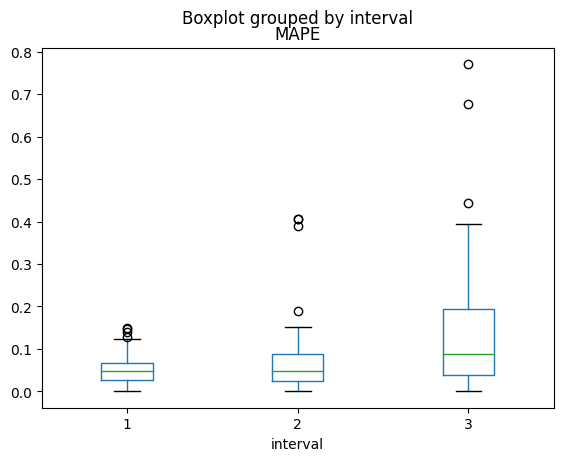

In [ ]:
cluster8['interval'] = cluster8.apply (lambda row: label_time(row), axis = 1)
cluster8.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape8 = cluster8['MAPE'].mean()
mape8

0.08797849269769158

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x900 with 1 Axes>,
 'decoder_variables': <Figure size 700x875 with 1 Axes>}

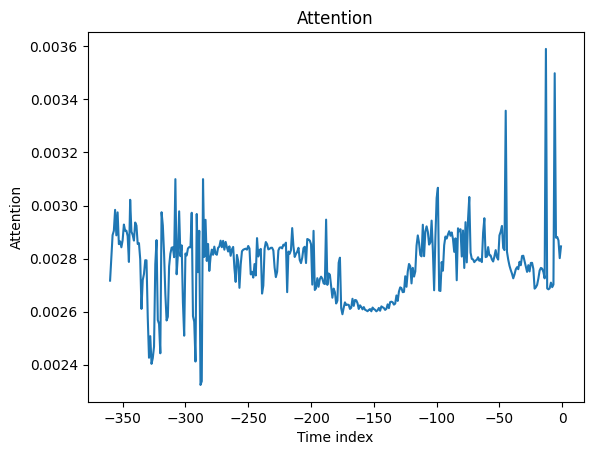

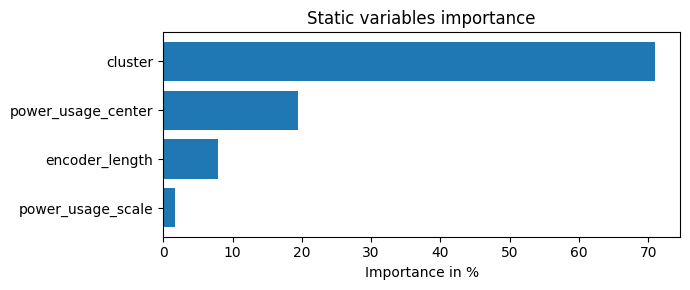

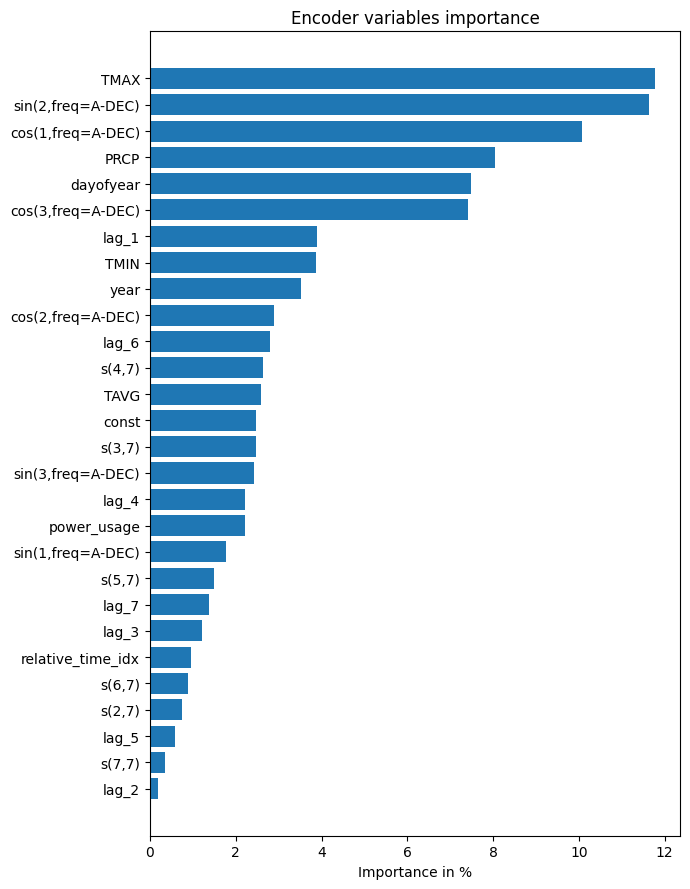

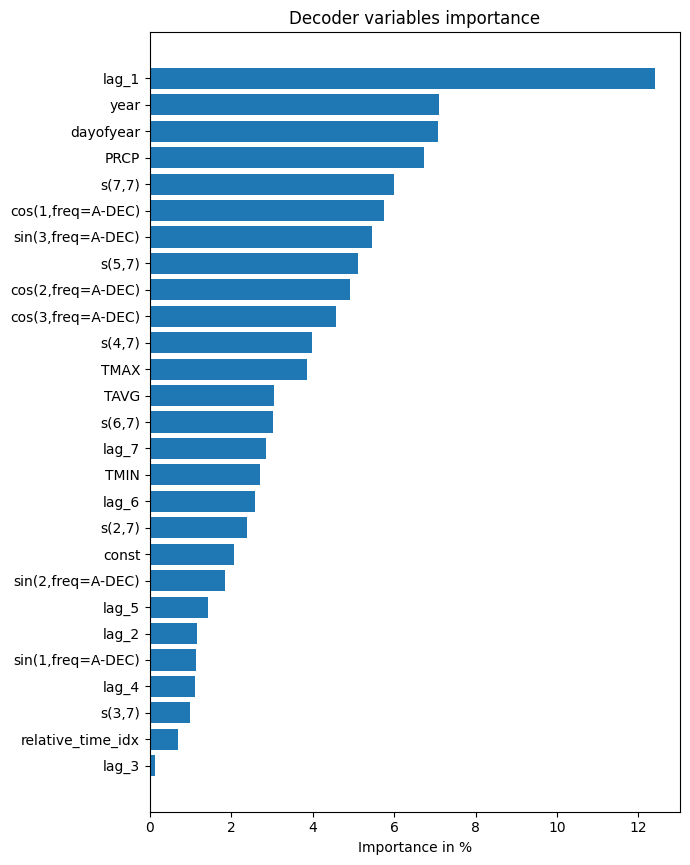

In [ ]:
interpretation8 = best_tft8.interpret_output(raw_predictions8.output, reduction="sum")
best_tft8.plot_interpretation(interpretation8)

## c7 TFT

In [ ]:
c7c = []
for i in c7.columns[1:-2]:
    c7c.append(i)
c7 = c7.fillna(0)
training7 = TimeSeriesDataSet(
    c7['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c7c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation7 = TimeSeriesDataSet.from_dataset(training7, c7[:-180], predict=True, stop_randomization=True)
test7 = TimeSeriesDataSet.from_dataset(validation7, c7, predict=True, stop_randomization=True)
train_dataloader7 = training7.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader7 = validation7.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader7 = test7.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals7 = torch.cat([y for x, (y, weight) in iter(val_dataloader7)]).to('cuda')
baseline_predictions7 = Baseline().predict(val_dataloader7).to('cuda')
((actuals7 - baseline_predictions7)/(actuals7)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.25894853472709656

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer7 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft7 = TemporalFusionTransformer.from_dataset(
    training7,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer7.fit(tft7,
    train_dataloaders=train_dataloader7,
    val_dataloaders=val_dataloader7)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 12.8 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 4.1 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.9 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 7508.531
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 7508.531


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.943 >= min_delta = 1. New best score: 7487.587
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.943 >= min_delta = 1. New best score: 7487.587


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.365 >= min_delta = 1. New best score: 7444.222
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.365 >= min_delta = 1. New best score: 7444.222


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 75.389 >= min_delta = 1. New best score: 7368.833
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 75.389 >= min_delta = 1. New best score: 7368.833


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 117.021 >= min_delta = 1. New best score: 7251.812
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 117.021 >= min_delta = 1. New best score: 7251.812


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.654 >= min_delta = 1. New best score: 7139.158
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.654 >= min_delta = 1. New best score: 7139.158


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 208.394 >= min_delta = 1. New best score: 6930.765
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 208.394 >= min_delta = 1. New best score: 6930.765


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 272.702 >= min_delta = 1. New best score: 6658.062
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 272.702 >= min_delta = 1. New best score: 6658.062


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 344.363 >= min_delta = 1. New best score: 6313.699
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 344.363 >= min_delta = 1. New best score: 6313.699


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 422.845 >= min_delta = 1. New best score: 5890.854
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 422.845 >= min_delta = 1. New best score: 5890.854


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 507.524 >= min_delta = 1. New best score: 5383.330
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 507.524 >= min_delta = 1. New best score: 5383.330


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 410.095 >= min_delta = 1. New best score: 4973.235
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 410.095 >= min_delta = 1. New best score: 4973.235


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 664.336 >= min_delta = 1. New best score: 4308.899
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 664.336 >= min_delta = 1. New best score: 4308.899


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 762.201 >= min_delta = 1. New best score: 3546.699
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 762.201 >= min_delta = 1. New best score: 3546.699


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 861.827 >= min_delta = 1. New best score: 2684.872
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 861.827 >= min_delta = 1. New best score: 2684.872


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 938.703 >= min_delta = 1. New best score: 1746.168
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 938.703 >= min_delta = 1. New best score: 1746.168


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 872.216 >= min_delta = 1. New best score: 873.953
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 872.216 >= min_delta = 1. New best score: 873.953


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 411.571 >= min_delta = 1. New best score: 462.381
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 411.571 >= min_delta = 1. New best score: 462.381


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 70.907 >= min_delta = 1. New best score: 391.474
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 70.907 >= min_delta = 1. New best score: 391.474


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 17.564 >= min_delta = 1. New best score: 373.910
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 17.564 >= min_delta = 1. New best score: 373.910


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 68.281 >= min_delta = 1. New best score: 305.630
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 68.281 >= min_delta = 1. New best score: 305.630


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.772 >= min_delta = 1. New best score: 261.858
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.772 >= min_delta = 1. New best score: 261.858


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 261.858. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 261.858. Signaling Trainer to stop.


In [ ]:
best_model_path7 = trainer7.checkpoint_callback.best_model_path
print(best_model_path7)
best_tft7= TemporalFusionTransformer.load_from_checkpoint(best_model_path7)
actuals7_p = torch.cat([y[0] for x, y in iter(val_dataloader7)]).to('cuda')
predictions7 = best_tft7.predict(val_dataloader7).to('cuda')
((actuals7_p - predictions7)/(actuals7_p)).abs().mean().item()

lightning_logs/lightning_logs/version_7/checkpoints/epoch=33-step=646.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.06946354359388351

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


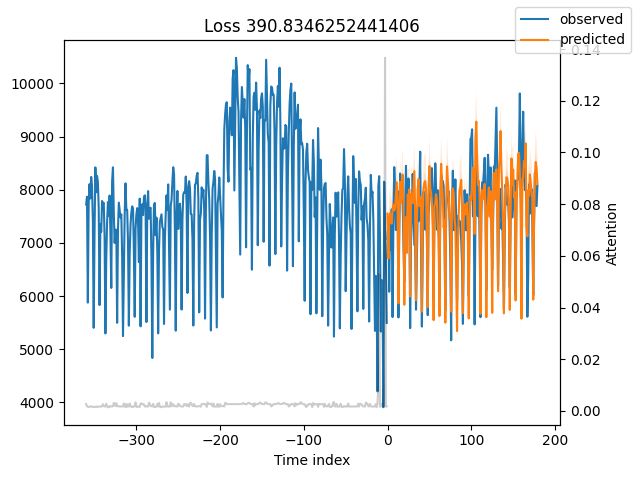

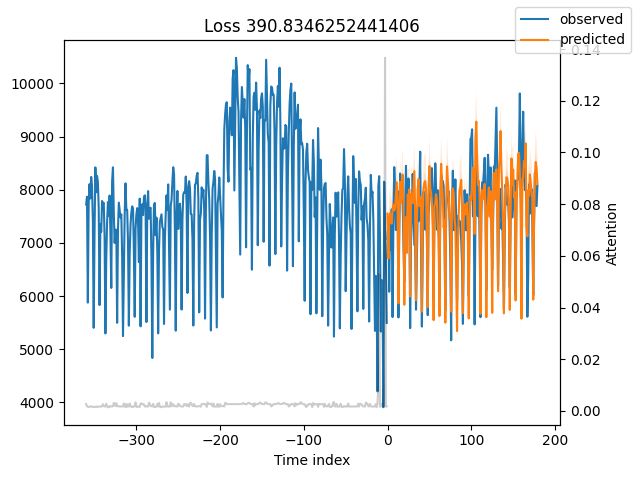

In [ ]:
raw_predictions7= best_tft7.predict(val_dataloader7, mode="raw", return_x=True)
best_tft7.plot_prediction(raw_predictions7.x, raw_predictions7.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


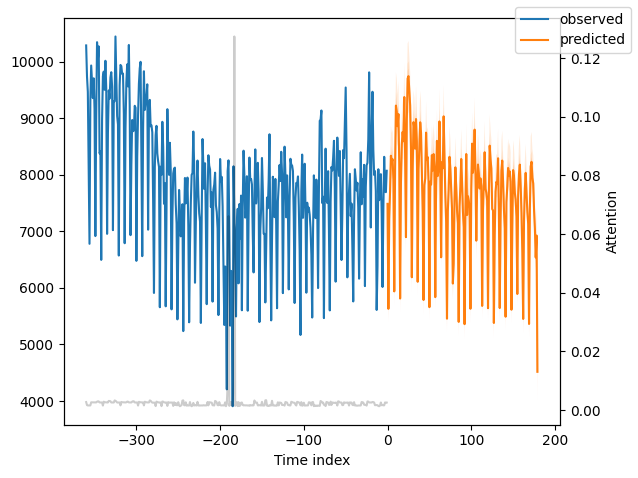

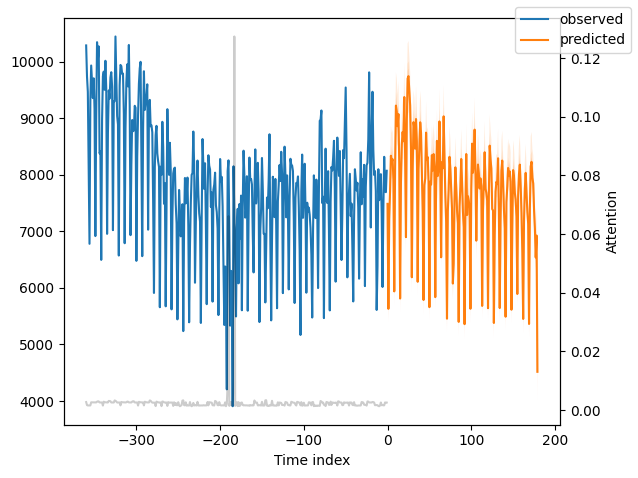

In [ ]:
new_raw_predictions7 = best_tft7.predict(test_dataloader7, mode="raw", return_x=True)
best_tft7.plot_prediction(new_raw_predictions7.x, new_raw_predictions7.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


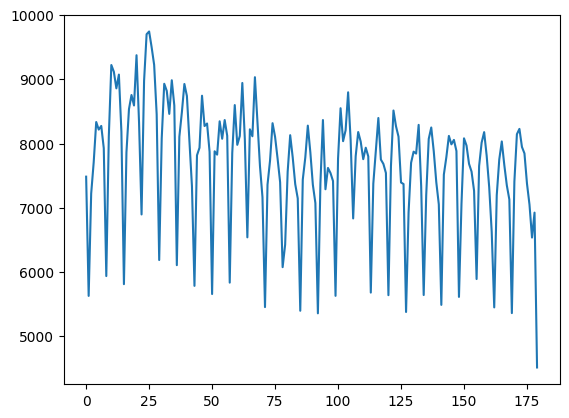

In [ ]:
new_raw_predictions7 = best_tft7.predict(test_dataloader7).to('cuda')
new_raw_predictions7 = new_raw_predictions7.cpu().numpy()
new_raw_predictions7 = new_raw_predictions7[0]
plt.plot(new_raw_predictions7)

In [ ]:
cluster7 = cluster[7][-180:].to_frame(name='original')
cluster7['prediction'] = new_raw_predictions7.tolist()
cluster7['MAPE'] = abs(cluster7.original-cluster7.prediction)/cluster7.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

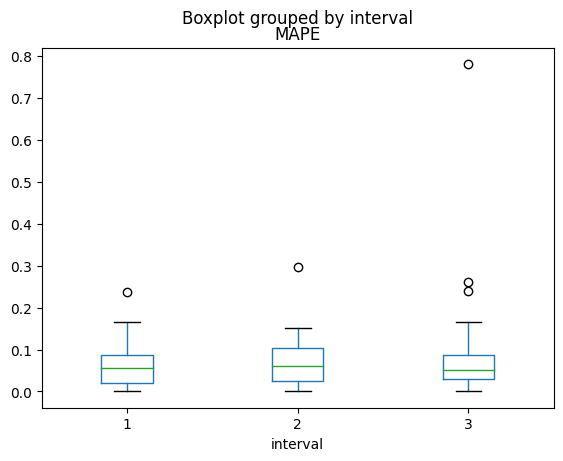

In [ ]:
cluster7['interval'] = cluster7.apply (lambda row: label_time(row), axis = 1)
cluster7.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape7 = cluster7['MAPE'].mean()
mape7

0.06867113527879429

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x1125 with 1 Axes>,
 'decoder_variables': <Figure size 700x1100 with 1 Axes>}

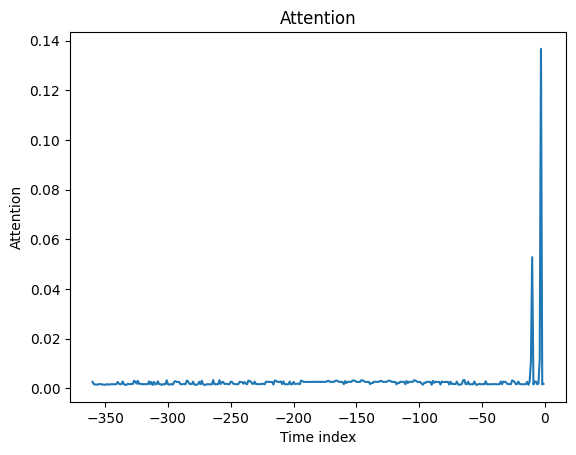

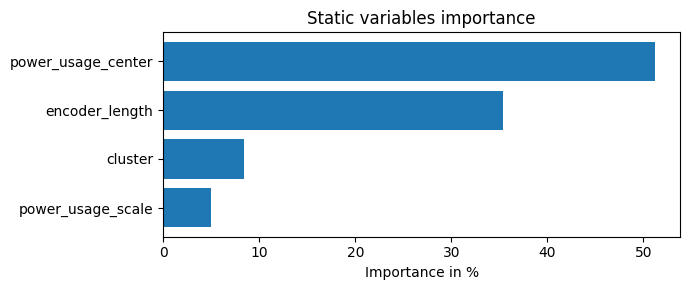

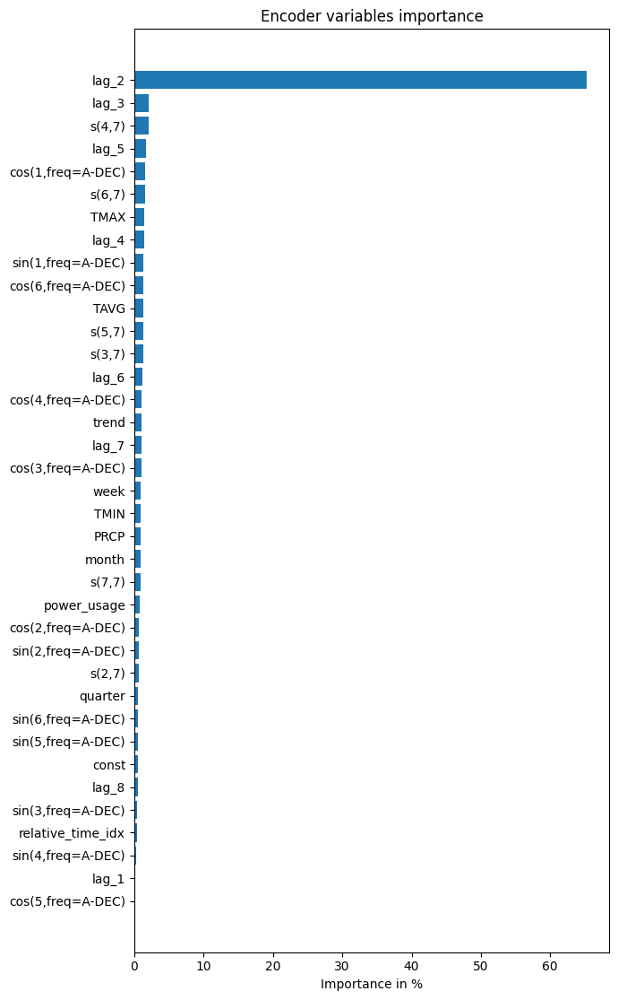

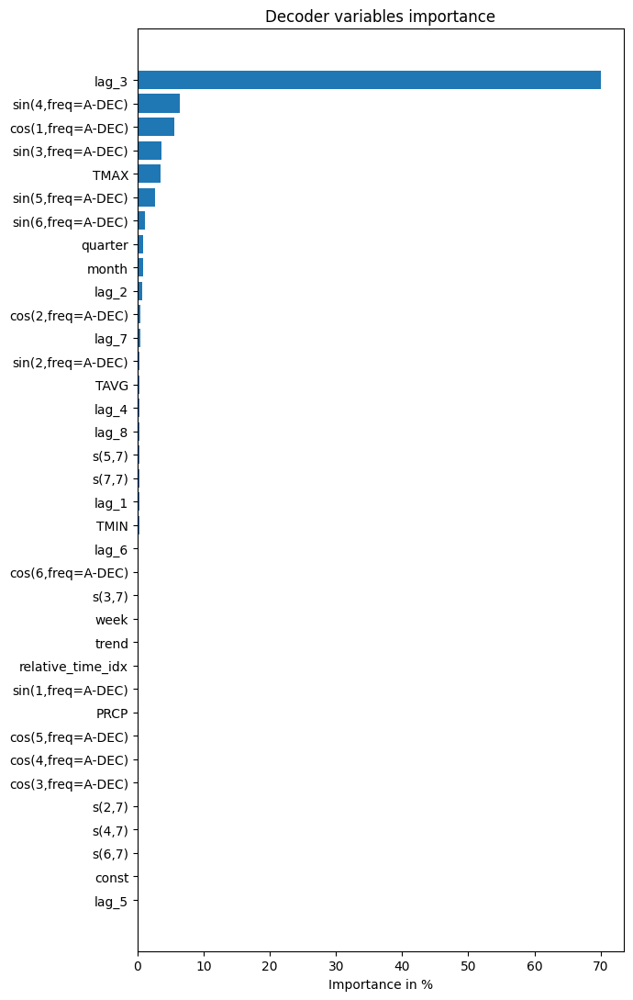

In [ ]:
interpretation7 = best_tft7.interpret_output(raw_predictions7.output, reduction="sum")
best_tft7.plot_interpretation(interpretation7)

## c6 TFT

In [ ]:
c6c = []
for i in c6.columns[1:-2]:
    c6c.append(i)
c6 = c6.fillna(0)
training6 = TimeSeriesDataSet(
    c6['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c6c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation6 = TimeSeriesDataSet.from_dataset(training6, c6[:-180], predict=True, stop_randomization=True)
test6 = TimeSeriesDataSet.from_dataset(validation6, c6, predict=True, stop_randomization=True)
train_dataloader6 = training6.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader6 = validation6.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader6 = test6.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals6 = torch.cat([y for x, (y, weight) in iter(val_dataloader6)]).to('cuda')
baseline_predictions6 = Baseline().predict(val_dataloader6).to('cuda')
((actuals6 - baseline_predictions6)/(actuals6)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.4571908116340637

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer6 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft6 = TemporalFusionTransformer.from_dataset(
    training6,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer6.fit(tft6,
    train_dataloaders=train_dataloader6,
    val_dataloaders=val_dataloader6)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 10.2 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.1 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.0 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 14209.402
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 14209.402


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.853 >= min_delta = 1. New best score: 14188.550
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.853 >= min_delta = 1. New best score: 14188.550


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 43.478 >= min_delta = 1. New best score: 14145.072
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 43.478 >= min_delta = 1. New best score: 14145.072


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 75.812 >= min_delta = 1. New best score: 14069.260
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 75.812 >= min_delta = 1. New best score: 14069.260


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 118.026 >= min_delta = 1. New best score: 13951.233
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 118.026 >= min_delta = 1. New best score: 13951.233


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 113.809 >= min_delta = 1. New best score: 13837.425
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 113.809 >= min_delta = 1. New best score: 13837.425


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 210.740 >= min_delta = 1. New best score: 13626.685
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 210.740 >= min_delta = 1. New best score: 13626.685


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 275.865 >= min_delta = 1. New best score: 13350.819
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 275.865 >= min_delta = 1. New best score: 13350.819


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 348.292 >= min_delta = 1. New best score: 13002.527
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 348.292 >= min_delta = 1. New best score: 13002.527


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 427.475 >= min_delta = 1. New best score: 12575.053
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 427.475 >= min_delta = 1. New best score: 12575.053


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 512.958 >= min_delta = 1. New best score: 12062.095
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 512.958 >= min_delta = 1. New best score: 12062.095


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 414.464 >= min_delta = 1. New best score: 11647.631
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 414.464 >= min_delta = 1. New best score: 11647.631


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 671.409 >= min_delta = 1. New best score: 10976.222
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 671.409 >= min_delta = 1. New best score: 10976.222


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 771.980 >= min_delta = 1. New best score: 10204.241
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 771.980 >= min_delta = 1. New best score: 10204.241


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 878.031 >= min_delta = 1. New best score: 9326.210
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 878.031 >= min_delta = 1. New best score: 9326.210


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 955.454 >= min_delta = 1. New best score: 8370.756
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 955.454 >= min_delta = 1. New best score: 8370.756


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 867.854 >= min_delta = 1. New best score: 7502.901
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 867.854 >= min_delta = 1. New best score: 7502.901


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 520.418 >= min_delta = 1. New best score: 6982.483
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 520.418 >= min_delta = 1. New best score: 6982.483


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 750.616 >= min_delta = 1. New best score: 6231.867
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 750.616 >= min_delta = 1. New best score: 6231.867


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 824.543 >= min_delta = 1. New best score: 5407.324
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 824.543 >= min_delta = 1. New best score: 5407.324


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 914.416 >= min_delta = 1. New best score: 4492.908
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 914.416 >= min_delta = 1. New best score: 4492.908


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 973.797 >= min_delta = 1. New best score: 3519.112
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 973.797 >= min_delta = 1. New best score: 3519.112


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1230.671 >= min_delta = 1. New best score: 2288.440
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1230.671 >= min_delta = 1. New best score: 2288.440


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 427.806 >= min_delta = 1. New best score: 1860.635
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 427.806 >= min_delta = 1. New best score: 1860.635


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 455.746 >= min_delta = 1. New best score: 1404.888
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 455.746 >= min_delta = 1. New best score: 1404.888


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 343.973 >= min_delta = 1. New best score: 1060.916
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 343.973 >= min_delta = 1. New best score: 1060.916


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 251.600 >= min_delta = 1. New best score: 809.316
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 251.600 >= min_delta = 1. New best score: 809.316


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 154.314 >= min_delta = 1. New best score: 655.002
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 154.314 >= min_delta = 1. New best score: 655.002


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 17.502 >= min_delta = 1. New best score: 637.500
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 17.502 >= min_delta = 1. New best score: 637.500


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 72.215 >= min_delta = 1. New best score: 565.286
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 72.215 >= min_delta = 1. New best score: 565.286


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4.169 >= min_delta = 1. New best score: 561.117
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4.169 >= min_delta = 1. New best score: 561.117


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 66.321 >= min_delta = 1. New best score: 494.795
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 66.321 >= min_delta = 1. New best score: 494.795


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 13.806 >= min_delta = 1. New best score: 480.989
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 13.806 >= min_delta = 1. New best score: 480.989


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 39.359 >= min_delta = 1. New best score: 441.630
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 39.359 >= min_delta = 1. New best score: 441.630


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 441.630. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 441.630. Signaling Trainer to stop.


In [ ]:
best_model_path6 = trainer6.checkpoint_callback.best_model_path
print(best_model_path6)
best_tft6= TemporalFusionTransformer.load_from_checkpoint(best_model_path6)
actuals6_p = torch.cat([y[0] for x, y in iter(val_dataloader6)]).to('cuda')
predictions6 = best_tft6.predict(val_dataloader6).to('cuda')
((actuals6_p - predictions6)/(actuals6_p)).abs().mean().item()

lightning_logs/lightning_logs/version_8/checkpoints/epoch=48-step=931.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.07367929816246033

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


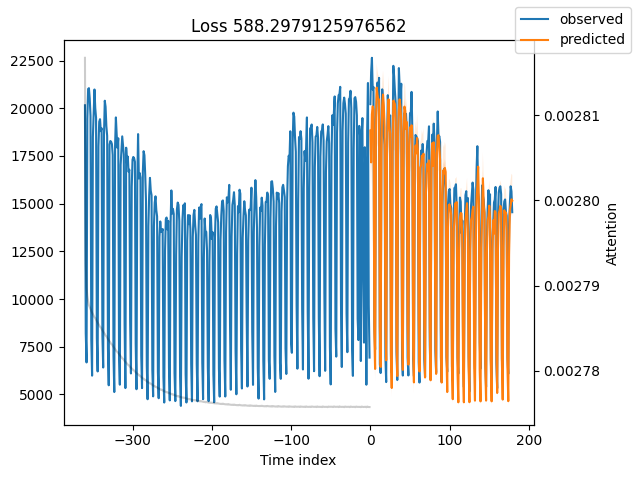

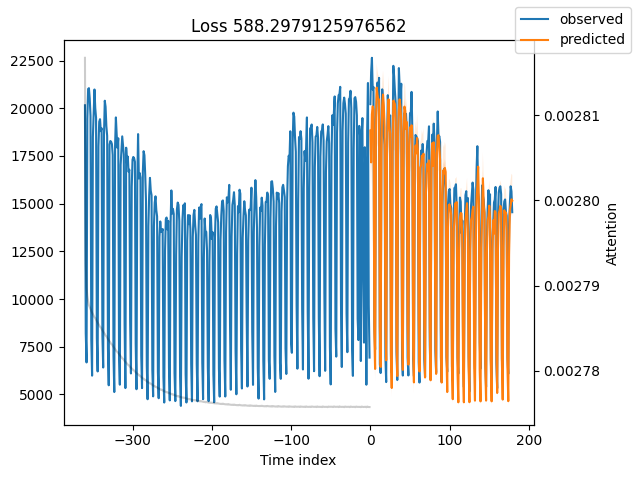

In [ ]:
raw_predictions6= best_tft6.predict(val_dataloader6, mode="raw", return_x=True)
best_tft6.plot_prediction(raw_predictions6.x, raw_predictions6.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


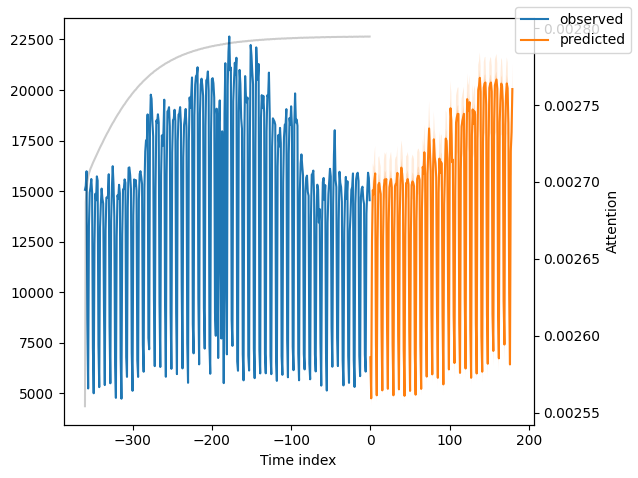

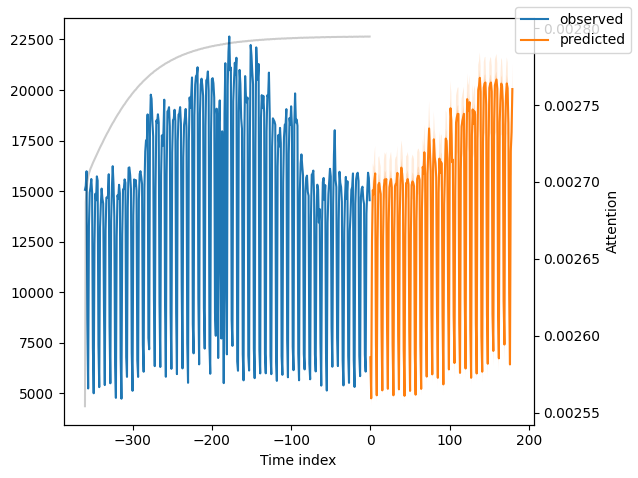

In [ ]:
new_raw_predictions6 = best_tft6.predict(test_dataloader6, mode="raw", return_x=True)
best_tft6.plot_prediction(new_raw_predictions6.x, new_raw_predictions6.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


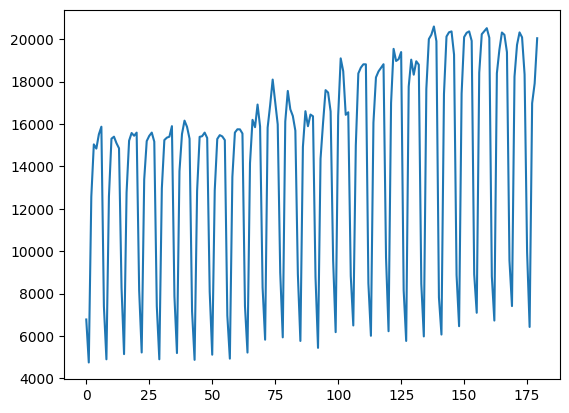

In [ ]:
new_raw_predictions6 = best_tft6.predict(test_dataloader6).to('cuda')
new_raw_predictions6 = new_raw_predictions6.cpu().numpy()
new_raw_predictions6 = new_raw_predictions6[0]
plt.plot(new_raw_predictions6)

In [ ]:
cluster6 = cluster[6][-180:].to_frame(name='original')
cluster6['prediction'] = new_raw_predictions6.tolist()
cluster6['MAPE'] = abs(cluster6.original-cluster6.prediction)/cluster6.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

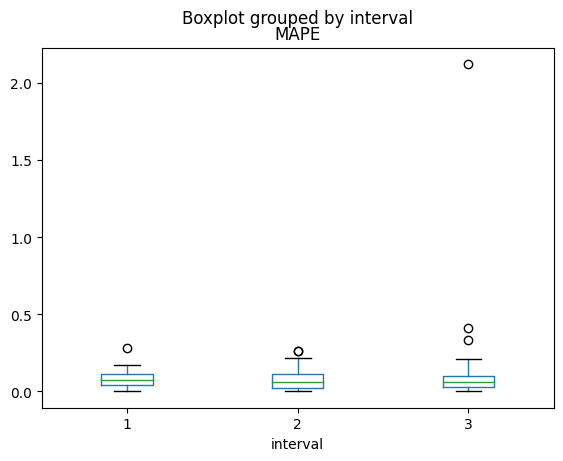

In [ ]:
cluster6['interval'] = cluster6.apply (lambda row: label_time(row), axis = 1)
cluster6.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape6 = cluster6['MAPE'].mean()
mape6

0.08886557675078194

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x925 with 1 Axes>,
 'decoder_variables': <Figure size 700x900 with 1 Axes>}

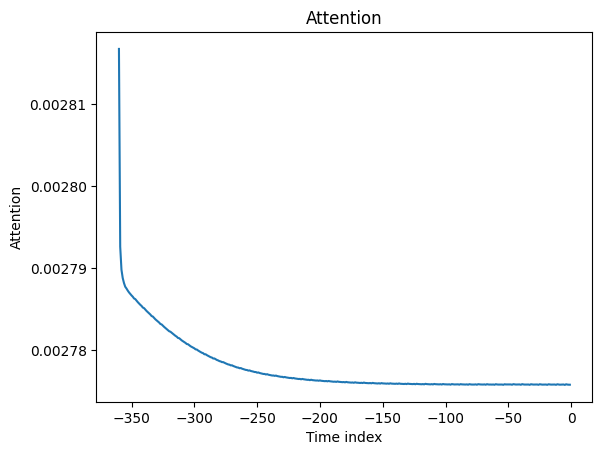

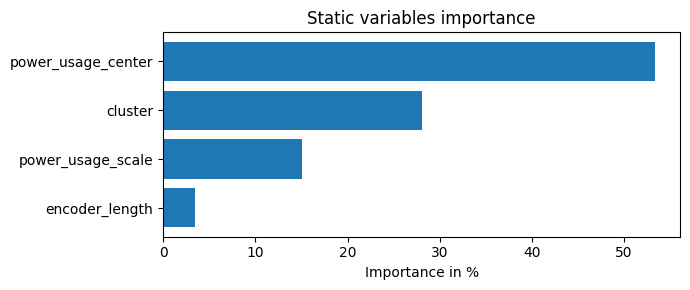

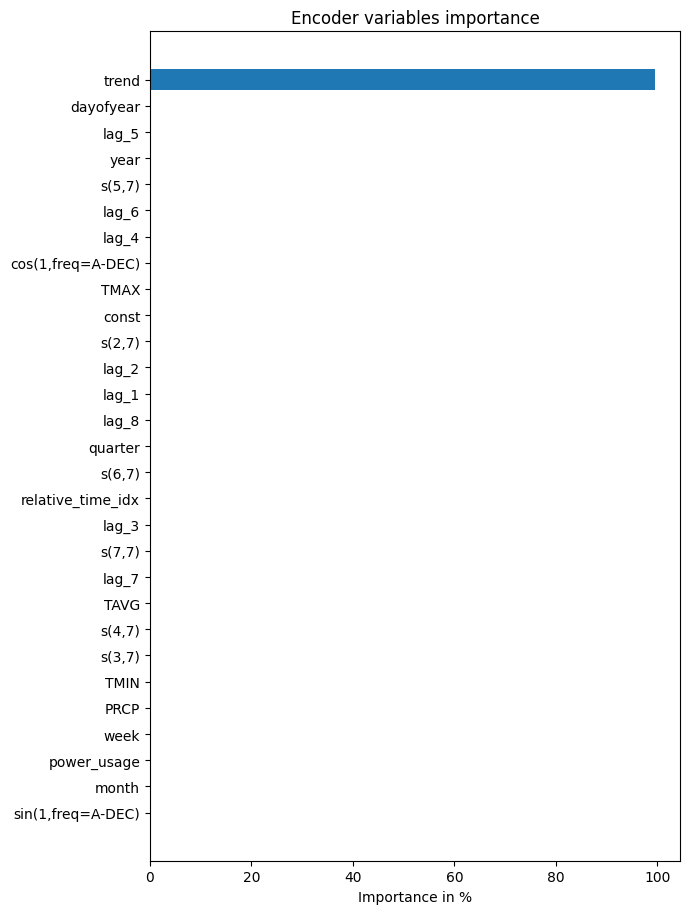

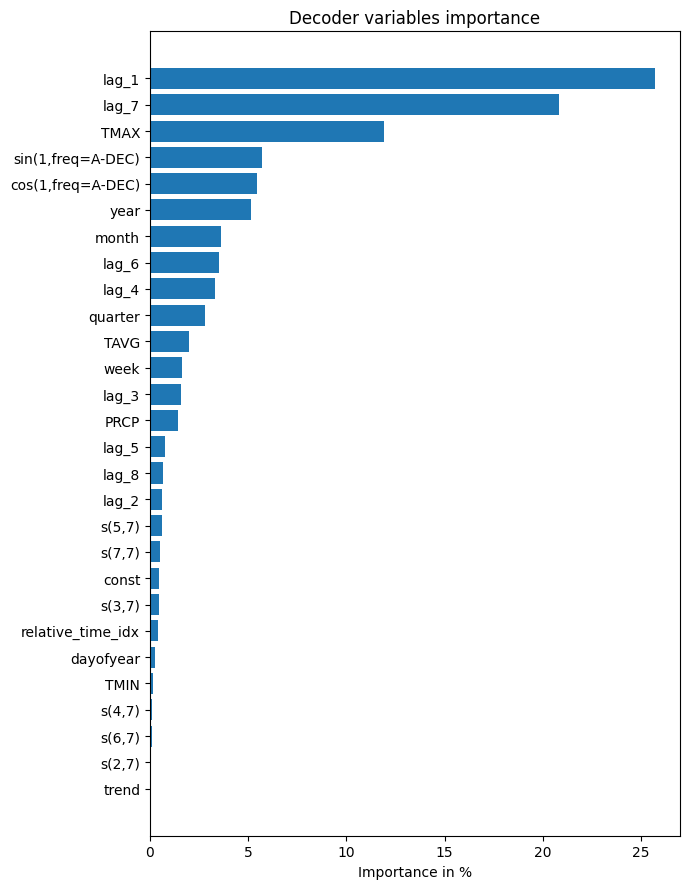

In [ ]:
interpretation6 = best_tft6.interpret_output(raw_predictions6.output, reduction="sum")
best_tft6.plot_interpretation(interpretation6)

## c5 TFT

In [ ]:
c5c = []
for i in c5.columns[1:-2]:
    c5c.append(i)
c5 = c5.fillna(0)
training5 = TimeSeriesDataSet(
    c5['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c5c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation5 = TimeSeriesDataSet.from_dataset(training5, c5[:-180], predict=True, stop_randomization=True)
test5 = TimeSeriesDataSet.from_dataset(validation5, c5, predict=True, stop_randomization=True)
train_dataloader5 = training5.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader5 = validation5.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader5 = test5.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals5 = torch.cat([y for x, (y, weight) in iter(val_dataloader5)]).to('cuda')
baseline_predictions5 = Baseline().predict(val_dataloader5).to('cuda')
((actuals5 - baseline_predictions5)/(actuals5)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.10071036964654922

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer5 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft5 = TemporalFusionTransformer.from_dataset(
    training5,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer5.fit(tft5,
    train_dataloaders=train_dataloader5,
    val_dataloaders=val_dataloader5)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 5.4 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 1.5 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 1.4 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 56997.035
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 56997.035


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.270 >= min_delta = 1. New best score: 56976.766
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.270 >= min_delta = 1. New best score: 56976.766


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 41.625 >= min_delta = 1. New best score: 56935.141
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 41.625 >= min_delta = 1. New best score: 56935.141


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 72.598 >= min_delta = 1. New best score: 56862.543
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 72.598 >= min_delta = 1. New best score: 56862.543


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.848 >= min_delta = 1. New best score: 56749.695
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.848 >= min_delta = 1. New best score: 56749.695


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 109.672 >= min_delta = 1. New best score: 56640.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 109.672 >= min_delta = 1. New best score: 56640.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 204.355 >= min_delta = 1. New best score: 56435.668
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 204.355 >= min_delta = 1. New best score: 56435.668


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 269.824 >= min_delta = 1. New best score: 56165.844
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 269.824 >= min_delta = 1. New best score: 56165.844


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 342.820 >= min_delta = 1. New best score: 55823.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 342.820 >= min_delta = 1. New best score: 55823.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 426.211 >= min_delta = 1. New best score: 55396.812
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 426.211 >= min_delta = 1. New best score: 55396.812


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 510.457 >= min_delta = 1. New best score: 54886.355
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 510.457 >= min_delta = 1. New best score: 54886.355


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 410.102 >= min_delta = 1. New best score: 54476.254
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 410.102 >= min_delta = 1. New best score: 54476.254


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 672.395 >= min_delta = 1. New best score: 53803.859
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 672.395 >= min_delta = 1. New best score: 53803.859


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 771.699 >= min_delta = 1. New best score: 53032.160
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 771.699 >= min_delta = 1. New best score: 53032.160


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 555.422 >= min_delta = 1. New best score: 52476.738
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 555.422 >= min_delta = 1. New best score: 52476.738


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 847.117 >= min_delta = 1. New best score: 51629.621
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 847.117 >= min_delta = 1. New best score: 51629.621


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 955.289 >= min_delta = 1. New best score: 50674.332
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 955.289 >= min_delta = 1. New best score: 50674.332


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 812.137 >= min_delta = 1. New best score: 49862.195
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 812.137 >= min_delta = 1. New best score: 49862.195


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1298.738 >= min_delta = 1. New best score: 48563.457
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1298.738 >= min_delta = 1. New best score: 48563.457


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1449.523 >= min_delta = 1. New best score: 47113.934
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1449.523 >= min_delta = 1. New best score: 47113.934


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1593.344 >= min_delta = 1. New best score: 45520.590
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1593.344 >= min_delta = 1. New best score: 45520.590


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1733.941 >= min_delta = 1. New best score: 43786.648
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1733.941 >= min_delta = 1. New best score: 43786.648


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1884.219 >= min_delta = 1. New best score: 41902.430
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1884.219 >= min_delta = 1. New best score: 41902.430


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1398.500 >= min_delta = 1. New best score: 40503.930
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1398.500 >= min_delta = 1. New best score: 40503.930


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2134.809 >= min_delta = 1. New best score: 38369.121
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2134.809 >= min_delta = 1. New best score: 38369.121


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2280.559 >= min_delta = 1. New best score: 36088.562
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2280.559 >= min_delta = 1. New best score: 36088.562


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2435.875 >= min_delta = 1. New best score: 33652.688
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2435.875 >= min_delta = 1. New best score: 33652.688


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2612.596 >= min_delta = 1. New best score: 31040.092
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2612.596 >= min_delta = 1. New best score: 31040.092


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2766.623 >= min_delta = 1. New best score: 28273.469
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2766.623 >= min_delta = 1. New best score: 28273.469


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2051.254 >= min_delta = 1. New best score: 26222.215
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2051.254 >= min_delta = 1. New best score: 26222.215


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3083.521 >= min_delta = 1. New best score: 23138.693
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3083.521 >= min_delta = 1. New best score: 23138.693


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3230.924 >= min_delta = 1. New best score: 19907.770
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3230.924 >= min_delta = 1. New best score: 19907.770


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3429.893 >= min_delta = 1. New best score: 16477.877
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3429.893 >= min_delta = 1. New best score: 16477.877


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3640.246 >= min_delta = 1. New best score: 12837.631
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3640.246 >= min_delta = 1. New best score: 12837.631


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3840.617 >= min_delta = 1. New best score: 8997.014
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3840.617 >= min_delta = 1. New best score: 8997.014


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2160.545 >= min_delta = 1. New best score: 6836.468
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2160.545 >= min_delta = 1. New best score: 6836.468


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1514.177 >= min_delta = 1. New best score: 5322.291
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1514.177 >= min_delta = 1. New best score: 5322.291


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 402.361 >= min_delta = 1. New best score: 4919.930
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 402.361 >= min_delta = 1. New best score: 4919.930


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 348.684 >= min_delta = 1. New best score: 4571.247
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 348.684 >= min_delta = 1. New best score: 4571.247


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1118.863 >= min_delta = 1. New best score: 3452.383
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1118.863 >= min_delta = 1. New best score: 3452.383


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 574.724 >= min_delta = 1. New best score: 2877.660
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 574.724 >= min_delta = 1. New best score: 2877.660


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 546.284 >= min_delta = 1. New best score: 2331.375
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 546.284 >= min_delta = 1. New best score: 2331.375


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 630.905 >= min_delta = 1. New best score: 1700.470
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 630.905 >= min_delta = 1. New best score: 1700.470


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 122.770 >= min_delta = 1. New best score: 1577.701
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 122.770 >= min_delta = 1. New best score: 1577.701


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 105.631 >= min_delta = 1. New best score: 1472.070
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 105.631 >= min_delta = 1. New best score: 1472.070


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 1472.070. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 1472.070. Signaling Trainer to stop.


In [ ]:
best_model_path5 = trainer5.checkpoint_callback.best_model_path
print(best_model_path5)
best_tft5= TemporalFusionTransformer.load_from_checkpoint(best_model_path5)
actuals5_p = torch.cat([y[0] for x, y in iter(val_dataloader5)]).to('cuda')
predictions5 = best_tft5.predict(val_dataloader5).to('cuda')
((actuals5_p - predictions5)/(actuals5_p)).abs().mean().item()

lightning_logs/lightning_logs/version_9/checkpoints/epoch=54-step=1045.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.043364476412534714

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


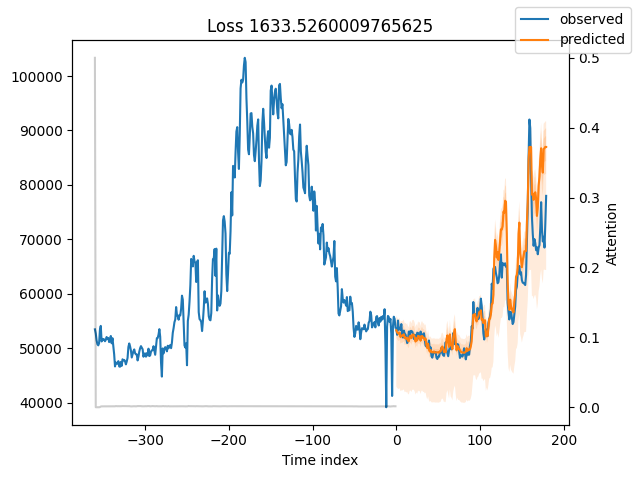

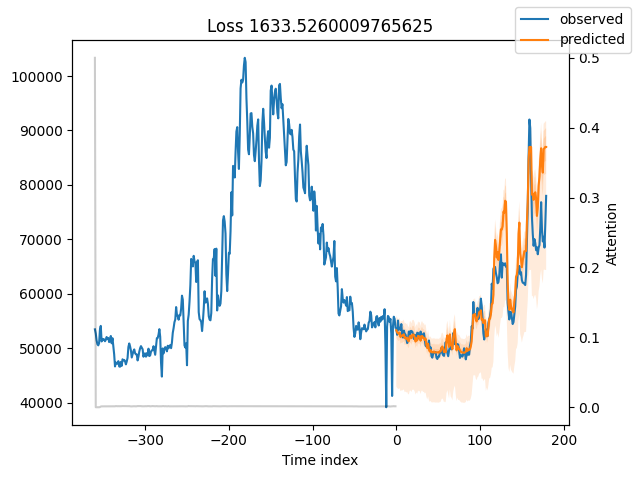

In [ ]:
raw_predictions5= best_tft5.predict(val_dataloader5, mode="raw", return_x=True)
best_tft5.plot_prediction(raw_predictions5.x, raw_predictions5.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


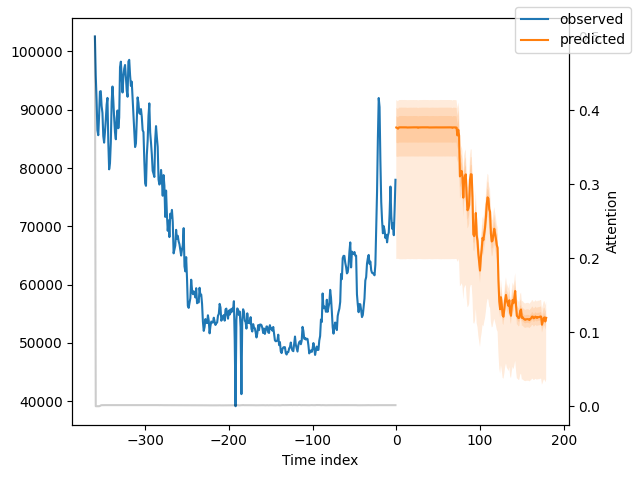

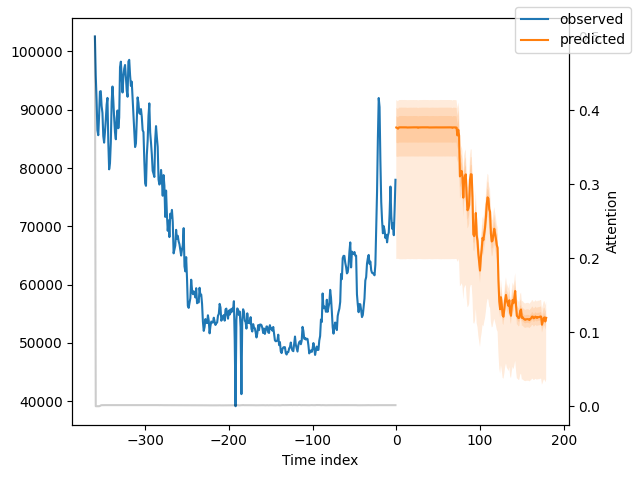

In [ ]:
new_raw_predictions5 = best_tft5.predict(test_dataloader5, mode="raw", return_x=True)
best_tft5.plot_prediction(new_raw_predictions5.x, new_raw_predictions5.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


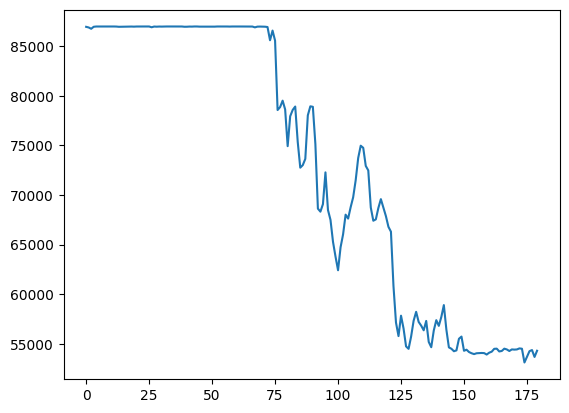

In [ ]:
new_raw_predictions5 = best_tft5.predict(test_dataloader5).to('cuda')
new_raw_predictions5 = new_raw_predictions5.cpu().numpy()
new_raw_predictions5 = new_raw_predictions5[0]
plt.plot(new_raw_predictions5)

In [ ]:
cluster5 = cluster[5][-180:].to_frame(name='original')
cluster5['prediction'] = new_raw_predictions5.tolist()
cluster5['MAPE'] = abs(cluster5.original-cluster5.prediction)/cluster5.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

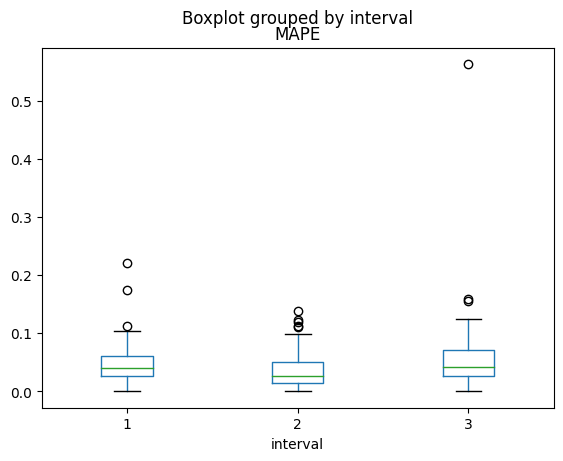

In [ ]:
cluster5['interval'] = cluster5.apply (lambda row: label_time(row), axis = 1)
cluster5.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape5 = cluster5['MAPE'].mean()
mape5

0.04827830841834586

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x550 with 1 Axes>,
 'decoder_variables': <Figure size 700x525 with 1 Axes>}

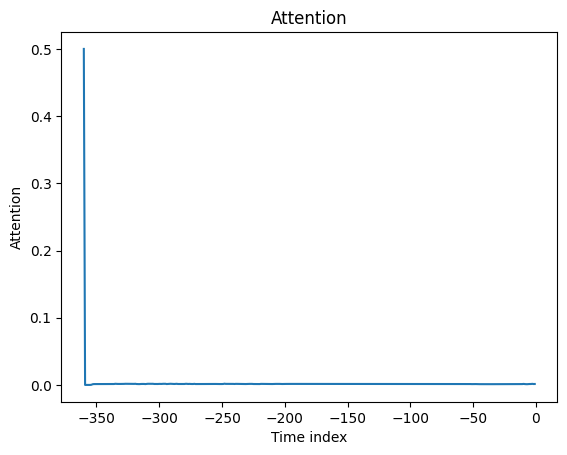

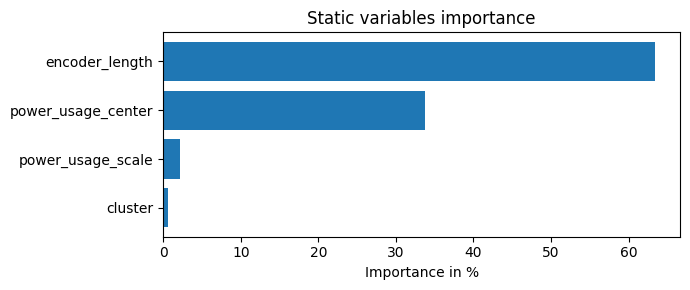

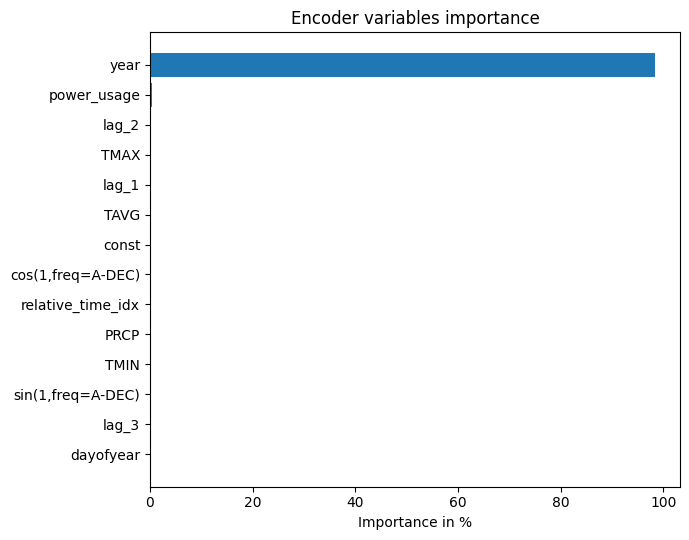

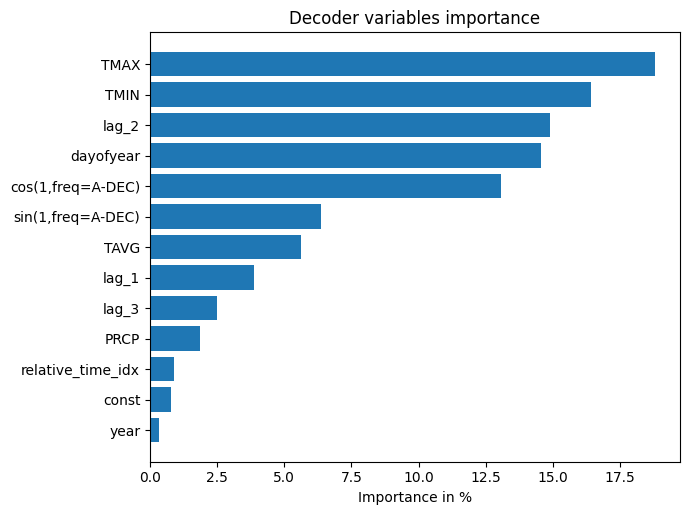

In [ ]:
interpretation5 = best_tft5.interpret_output(raw_predictions5.output, reduction="sum")
best_tft5.plot_interpretation(interpretation5)

##c4 TFT

In [ ]:
c4c = []
for i in c4.columns[1:-2]:
    c4c.append(i)
c4 = c4.fillna(0)
training4 = TimeSeriesDataSet(
    c4['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c4c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [ ]:
validation4 = TimeSeriesDataSet.from_dataset(training4, c4[:-180], predict=True, stop_randomization=True)
test4 = TimeSeriesDataSet.from_dataset(validation4, c4, predict=True, stop_randomization=True)
train_dataloader4 = training4.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader4 = validation4.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader4 = test4.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [ ]:
actuals4 = torch.cat([y for x, (y, weight) in iter(val_dataloader4)]).to('cuda')
baseline_predictions4 = Baseline().predict(val_dataloader4).to('cuda')
((actuals4 - baseline_predictions4)/(actuals4)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.0896955281496048

In [ ]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer4 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft4 = TemporalFusionTransformer.from_dataset(
    training4,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
trainer4.fit(tft4,
    train_dataloaders=train_dataloader4,
    val_dataloaders=val_dataloader4)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 8.6 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 2.6 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.5 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 57872.609
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 57872.609


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 21.414 >= min_delta = 1. New best score: 57851.195
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 21.414 >= min_delta = 1. New best score: 57851.195


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 45.375 >= min_delta = 1. New best score: 57805.820
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 45.375 >= min_delta = 1. New best score: 57805.820


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 78.953 >= min_delta = 1. New best score: 57726.867
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 78.953 >= min_delta = 1. New best score: 57726.867


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 121.805 >= min_delta = 1. New best score: 57605.062
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 121.805 >= min_delta = 1. New best score: 57605.062


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 116.285 >= min_delta = 1. New best score: 57488.777
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 116.285 >= min_delta = 1. New best score: 57488.777


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 213.438 >= min_delta = 1. New best score: 57275.340
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 213.438 >= min_delta = 1. New best score: 57275.340


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 276.855 >= min_delta = 1. New best score: 56998.484
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 276.855 >= min_delta = 1. New best score: 56998.484


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 347.020 >= min_delta = 1. New best score: 56651.465
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 347.020 >= min_delta = 1. New best score: 56651.465


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 423.633 >= min_delta = 1. New best score: 56227.832
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 423.633 >= min_delta = 1. New best score: 56227.832


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 506.488 >= min_delta = 1. New best score: 55721.344
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 506.488 >= min_delta = 1. New best score: 55721.344


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 408.699 >= min_delta = 1. New best score: 55312.645
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 408.699 >= min_delta = 1. New best score: 55312.645


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 661.859 >= min_delta = 1. New best score: 54650.785
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 661.859 >= min_delta = 1. New best score: 54650.785


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 760.812 >= min_delta = 1. New best score: 53889.973
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 760.812 >= min_delta = 1. New best score: 53889.973


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 865.984 >= min_delta = 1. New best score: 53023.988
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 865.984 >= min_delta = 1. New best score: 53023.988


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 976.945 >= min_delta = 1. New best score: 52047.043
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 976.945 >= min_delta = 1. New best score: 52047.043


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1093.898 >= min_delta = 1. New best score: 50953.145
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1093.898 >= min_delta = 1. New best score: 50953.145


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 841.023 >= min_delta = 1. New best score: 50112.121
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 841.023 >= min_delta = 1. New best score: 50112.121


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1307.699 >= min_delta = 1. New best score: 48804.422
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1307.699 >= min_delta = 1. New best score: 48804.422


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1441.551 >= min_delta = 1. New best score: 47362.871
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1441.551 >= min_delta = 1. New best score: 47362.871


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1582.039 >= min_delta = 1. New best score: 45780.832
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1582.039 >= min_delta = 1. New best score: 45780.832


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1728.492 >= min_delta = 1. New best score: 44052.340
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1728.492 >= min_delta = 1. New best score: 44052.340


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1881.500 >= min_delta = 1. New best score: 42170.840
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1881.500 >= min_delta = 1. New best score: 42170.840


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1415.152 >= min_delta = 1. New best score: 40755.688
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1415.152 >= min_delta = 1. New best score: 40755.688


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2158.652 >= min_delta = 1. New best score: 38597.035
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2158.652 >= min_delta = 1. New best score: 38597.035


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2330.258 >= min_delta = 1. New best score: 36266.777
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2330.258 >= min_delta = 1. New best score: 36266.777


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2509.371 >= min_delta = 1. New best score: 33757.406
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2509.371 >= min_delta = 1. New best score: 33757.406


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2694.879 >= min_delta = 1. New best score: 31062.527
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2694.879 >= min_delta = 1. New best score: 31062.527


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2887.127 >= min_delta = 1. New best score: 28175.400
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2887.127 >= min_delta = 1. New best score: 28175.400


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2143.557 >= min_delta = 1. New best score: 26031.844
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2143.557 >= min_delta = 1. New best score: 26031.844


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3231.330 >= min_delta = 1. New best score: 22800.514
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3231.330 >= min_delta = 1. New best score: 22800.514


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3442.146 >= min_delta = 1. New best score: 19358.367
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3442.146 >= min_delta = 1. New best score: 19358.367


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3660.390 >= min_delta = 1. New best score: 15697.978
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3660.390 >= min_delta = 1. New best score: 15697.978


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 3884.734 >= min_delta = 1. New best score: 11813.243
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 3884.734 >= min_delta = 1. New best score: 11813.243


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 4116.323 >= min_delta = 1. New best score: 7696.920
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 4116.323 >= min_delta = 1. New best score: 7696.920


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2879.625 >= min_delta = 1. New best score: 4817.294
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2879.625 >= min_delta = 1. New best score: 4817.294


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2367.273 >= min_delta = 1. New best score: 2450.021
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2367.273 >= min_delta = 1. New best score: 2450.021


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 327.859 >= min_delta = 1. New best score: 2122.162
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 327.859 >= min_delta = 1. New best score: 2122.162


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 665.309 >= min_delta = 1. New best score: 1456.853
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 665.309 >= min_delta = 1. New best score: 1456.853


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 277.714 >= min_delta = 1. New best score: 1179.139
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 277.714 >= min_delta = 1. New best score: 1179.139


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 301.772 >= min_delta = 1. New best score: 877.368
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 301.772 >= min_delta = 1. New best score: 877.368


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 11.475 >= min_delta = 1. New best score: 865.893
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 11.475 >= min_delta = 1. New best score: 865.893


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 147.790 >= min_delta = 1. New best score: 718.103
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 147.790 >= min_delta = 1. New best score: 718.103


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 17.085 >= min_delta = 1. New best score: 701.017
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 17.085 >= min_delta = 1. New best score: 701.017


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 701.017. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 701.017. Signaling Trainer to stop.


In [ ]:
best_model_path4 = trainer4.checkpoint_callback.best_model_path
print(best_model_path4)
best_tft4= TemporalFusionTransformer.load_from_checkpoint(best_model_path4)
actuals4_p = torch.cat([y[0] for x, y in iter(val_dataloader4)]).to('cuda')
predictions4 = best_tft4.predict(val_dataloader4).to('cuda')
((actuals4_p - predictions4)/(actuals4_p)).abs().mean().item()

lightning_logs/lightning_logs/version_10/checkpoints/epoch=55-step=1064.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.02431771531701088

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


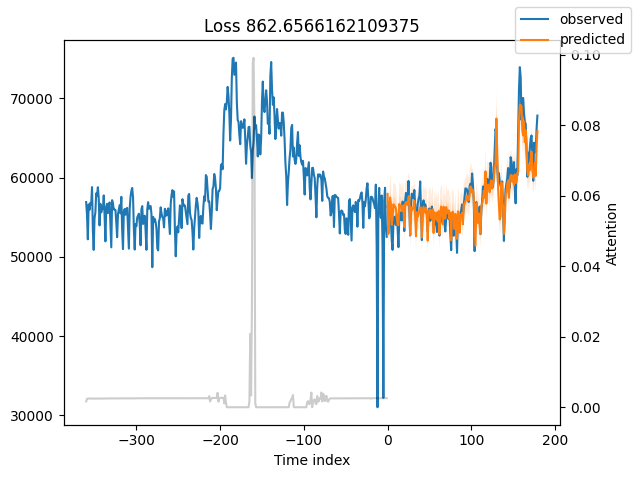

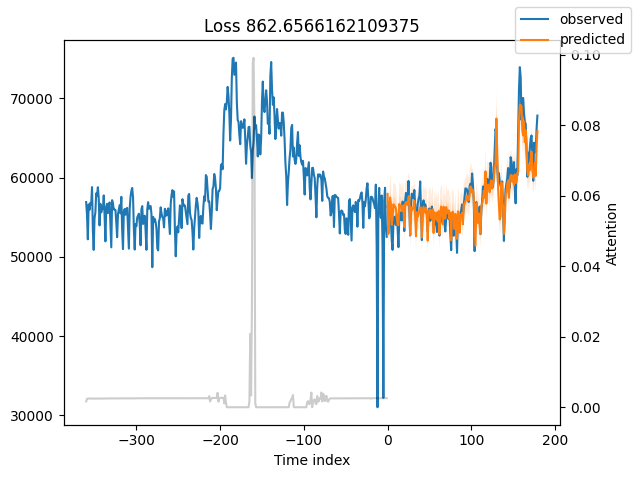

In [ ]:
raw_predictions4= best_tft4.predict(val_dataloader4, mode="raw", return_x=True)
best_tft4.plot_prediction(raw_predictions4.x, raw_predictions4.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


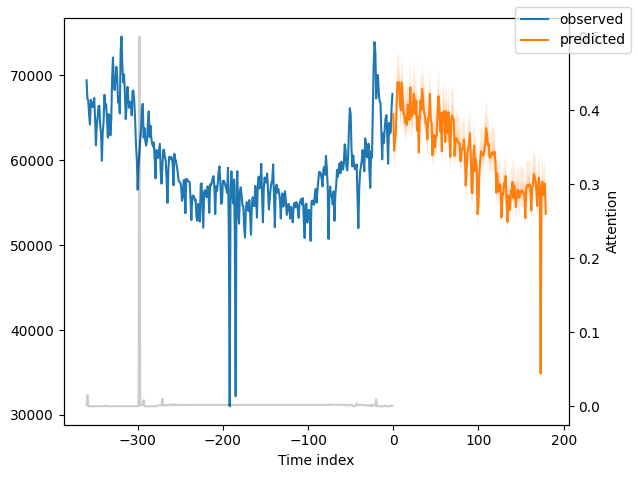

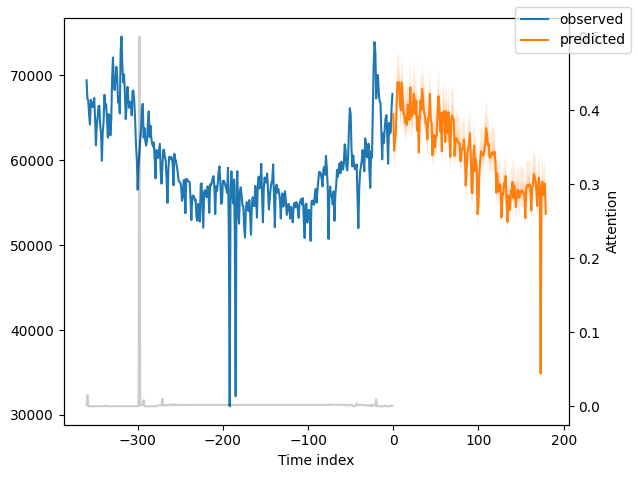

In [ ]:
new_raw_predictions4 = best_tft4.predict(test_dataloader4, mode="raw", return_x=True)
best_tft4.plot_prediction(new_raw_predictions4.x, new_raw_predictions4.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


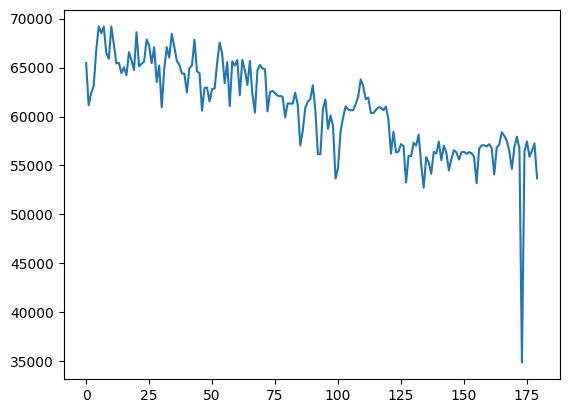

In [ ]:
new_raw_predictions4 = best_tft4.predict(test_dataloader4).to('cuda')
new_raw_predictions4 = new_raw_predictions4.cpu().numpy()
new_raw_predictions4 = new_raw_predictions4[0]
plt.plot(new_raw_predictions4)

In [ ]:
cluster4 = cluster[4][-180:].to_frame(name='original')
cluster4['prediction'] = new_raw_predictions4.tolist()
cluster4['MAPE'] = abs(cluster4.original-cluster4.prediction)/cluster4.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

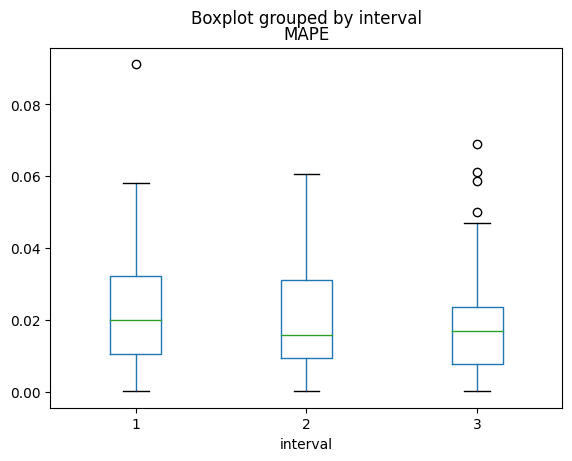

In [ ]:
cluster4['interval'] = cluster4.apply (lambda row: label_time(row), axis = 1)
cluster4.boxplot(by ='interval', column =['MAPE'], grid = False)

In [ ]:
mape4 = cluster4['MAPE'].mean()
mape4

0.020823766543378343

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x800 with 1 Axes>,
 'decoder_variables': <Figure size 700x775 with 1 Axes>}

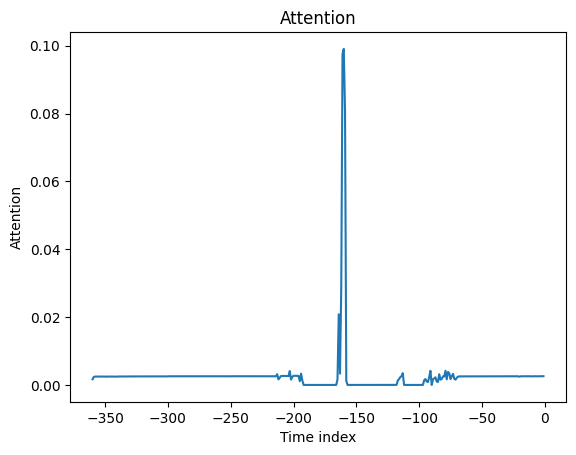

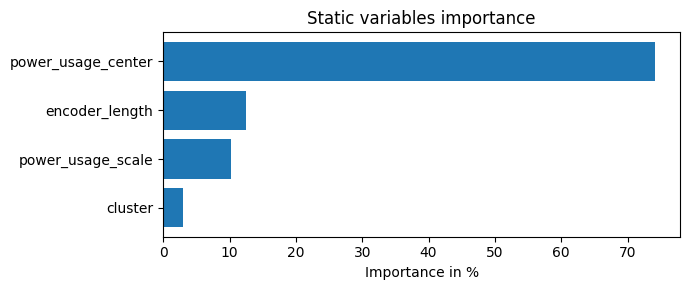

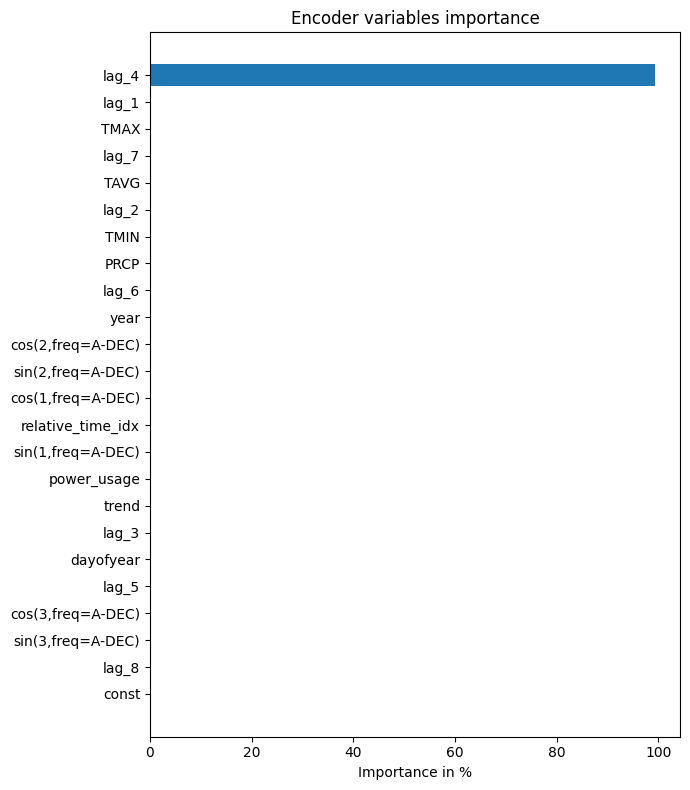

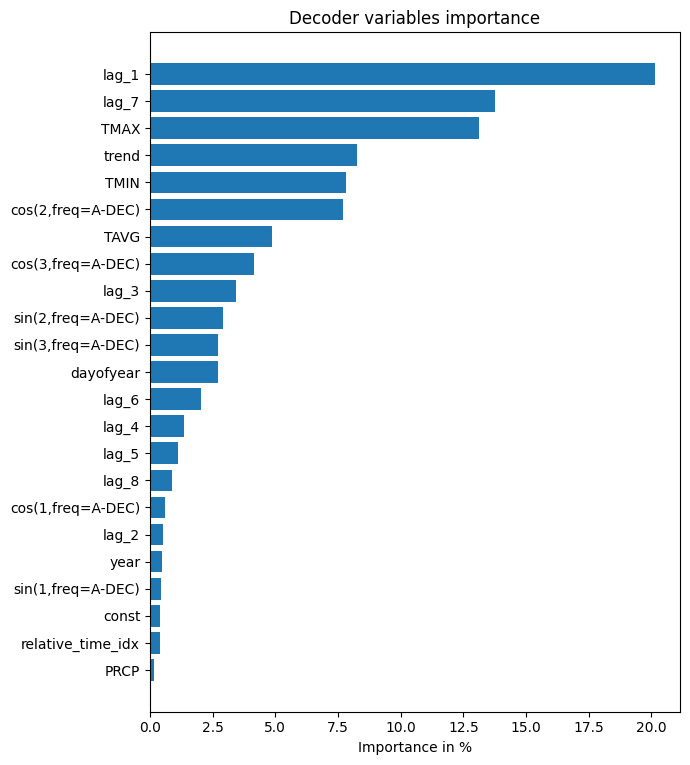

In [ ]:
interpretation4 = best_tft4.interpret_output(raw_predictions4.output, reduction="sum")
best_tft4.plot_interpretation(interpretation4)

##c3 TFT

In [163]:
c3c = []
for i in c3.columns[1:-2]:
    c3c.append(i)
c3 = c3.fillna(0)
training3 = TimeSeriesDataSet(
    c3['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c3c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [164]:
validation3 = TimeSeriesDataSet.from_dataset(training3, c3[:-180], predict=True, stop_randomization=True)
test3 = TimeSeriesDataSet.from_dataset(validation3, c3, predict=True, stop_randomization=True)
train_dataloader3 = training3.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader3 = validation3.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader3 = test3.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [165]:
actuals3 = torch.cat([y for x, (y, weight) in iter(val_dataloader3)]).to('cuda')
baseline_predictions3 = Baseline().predict(val_dataloader3).to('cuda')
((actuals3 - baseline_predictions3)/(actuals3)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.04628966748714447

In [166]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer3 = pl.Trainer(
    max_epochs=150,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft3 = TemporalFusionTransformer.from_dataset(
    training3,
    learning_rate=0.05,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [167]:
trainer3.fit(tft3,
    train_dataloaders=train_dataloader3,
    val_dataloaders=val_dataloader3)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 8.0 K 
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 2.4 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 2.3 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 67222.055
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 67222.055


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 8.680 >= min_delta = 1. New best score: 67213.375
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 8.680 >= min_delta = 1. New best score: 67213.375


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 15.930 >= min_delta = 1. New best score: 67197.445
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 15.930 >= min_delta = 1. New best score: 67197.445


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 25.375 >= min_delta = 1. New best score: 67172.070
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 25.375 >= min_delta = 1. New best score: 67172.070


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 37.312 >= min_delta = 1. New best score: 67134.758
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 37.312 >= min_delta = 1. New best score: 67134.758


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 34.922 >= min_delta = 1. New best score: 67099.836
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 34.922 >= min_delta = 1. New best score: 67099.836


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 63.266 >= min_delta = 1. New best score: 67036.570
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 63.266 >= min_delta = 1. New best score: 67036.570


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 81.438 >= min_delta = 1. New best score: 66955.133
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 81.438 >= min_delta = 1. New best score: 66955.133


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 101.602 >= min_delta = 1. New best score: 66853.531
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 101.602 >= min_delta = 1. New best score: 66853.531


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 123.641 >= min_delta = 1. New best score: 66729.891
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 123.641 >= min_delta = 1. New best score: 66729.891


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 147.383 >= min_delta = 1. New best score: 66582.508
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 147.383 >= min_delta = 1. New best score: 66582.508


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 118.539 >= min_delta = 1. New best score: 66463.969
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 118.539 >= min_delta = 1. New best score: 66463.969


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 191.461 >= min_delta = 1. New best score: 66272.508
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 191.461 >= min_delta = 1. New best score: 66272.508


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 219.219 >= min_delta = 1. New best score: 66053.289
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 219.219 >= min_delta = 1. New best score: 66053.289


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 248.297 >= min_delta = 1. New best score: 65804.992
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 248.297 >= min_delta = 1. New best score: 65804.992


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 278.660 >= min_delta = 1. New best score: 65526.332
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 278.660 >= min_delta = 1. New best score: 65526.332


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 310.230 >= min_delta = 1. New best score: 65216.102
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 310.230 >= min_delta = 1. New best score: 65216.102


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 237.078 >= min_delta = 1. New best score: 64979.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 237.078 >= min_delta = 1. New best score: 64979.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 366.891 >= min_delta = 1. New best score: 64612.133
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 366.891 >= min_delta = 1. New best score: 64612.133


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 401.715 >= min_delta = 1. New best score: 64210.418
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 401.715 >= min_delta = 1. New best score: 64210.418


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 437.797 >= min_delta = 1. New best score: 63772.621
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 437.797 >= min_delta = 1. New best score: 63772.621


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 475.043 >= min_delta = 1. New best score: 63297.578
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 475.043 >= min_delta = 1. New best score: 63297.578


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 513.543 >= min_delta = 1. New best score: 62784.035
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 513.543 >= min_delta = 1. New best score: 62784.035


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 383.715 >= min_delta = 1. New best score: 62400.320
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 383.715 >= min_delta = 1. New best score: 62400.320


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 582.094 >= min_delta = 1. New best score: 61818.227
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 582.094 >= min_delta = 1. New best score: 61818.227


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 624.004 >= min_delta = 1. New best score: 61194.223
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 624.004 >= min_delta = 1. New best score: 61194.223


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 667.293 >= min_delta = 1. New best score: 60526.930
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 667.293 >= min_delta = 1. New best score: 60526.930


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 711.719 >= min_delta = 1. New best score: 59815.211
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 711.719 >= min_delta = 1. New best score: 59815.211


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 757.410 >= min_delta = 1. New best score: 59057.801
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 757.410 >= min_delta = 1. New best score: 59057.801


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 559.066 >= min_delta = 1. New best score: 58498.734
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 559.066 >= min_delta = 1. New best score: 58498.734


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 838.734 >= min_delta = 1. New best score: 57660.000
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 838.734 >= min_delta = 1. New best score: 57660.000


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 888.289 >= min_delta = 1. New best score: 56771.711
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 888.289 >= min_delta = 1. New best score: 56771.711


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 939.465 >= min_delta = 1. New best score: 55832.246
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 939.465 >= min_delta = 1. New best score: 55832.246


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 991.824 >= min_delta = 1. New best score: 54840.422
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 991.824 >= min_delta = 1. New best score: 54840.422


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1045.398 >= min_delta = 1. New best score: 53795.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1045.398 >= min_delta = 1. New best score: 53795.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 766.000 >= min_delta = 1. New best score: 53029.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 766.000 >= min_delta = 1. New best score: 53029.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1141.328 >= min_delta = 1. New best score: 51887.695
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1141.328 >= min_delta = 1. New best score: 51887.695


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1199.484 >= min_delta = 1. New best score: 50688.211
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1199.484 >= min_delta = 1. New best score: 50688.211


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1259.457 >= min_delta = 1. New best score: 49428.754
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1259.457 >= min_delta = 1. New best score: 49428.754


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1320.715 >= min_delta = 1. New best score: 48108.039
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1320.715 >= min_delta = 1. New best score: 48108.039


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1383.648 >= min_delta = 1. New best score: 46724.391
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1383.648 >= min_delta = 1. New best score: 46724.391


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1008.586 >= min_delta = 1. New best score: 45715.805
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1008.586 >= min_delta = 1. New best score: 45715.805


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1495.512 >= min_delta = 1. New best score: 44220.293
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1495.512 >= min_delta = 1. New best score: 44220.293


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1563.645 >= min_delta = 1. New best score: 42656.648
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1563.645 >= min_delta = 1. New best score: 42656.648


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1633.625 >= min_delta = 1. New best score: 41023.023
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1633.625 >= min_delta = 1. New best score: 41023.023


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1704.758 >= min_delta = 1. New best score: 39318.266
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1704.758 >= min_delta = 1. New best score: 39318.266


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1777.645 >= min_delta = 1. New best score: 37540.621
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1777.645 >= min_delta = 1. New best score: 37540.621


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1290.828 >= min_delta = 1. New best score: 36249.793
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1290.828 >= min_delta = 1. New best score: 36249.793


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1907.422 >= min_delta = 1. New best score: 34342.371
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1907.422 >= min_delta = 1. New best score: 34342.371


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1985.922 >= min_delta = 1. New best score: 32356.449
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1985.922 >= min_delta = 1. New best score: 32356.449


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2066.660 >= min_delta = 1. New best score: 30289.789
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2066.660 >= min_delta = 1. New best score: 30289.789


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2148.500 >= min_delta = 1. New best score: 28141.289
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2148.500 >= min_delta = 1. New best score: 28141.289


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2231.506 >= min_delta = 1. New best score: 25909.783
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2231.506 >= min_delta = 1. New best score: 25909.783


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1614.650 >= min_delta = 1. New best score: 24295.133
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1614.650 >= min_delta = 1. New best score: 24295.133


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2377.699 >= min_delta = 1. New best score: 21917.434
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2377.699 >= min_delta = 1. New best score: 21917.434


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2465.879 >= min_delta = 1. New best score: 19451.555
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2465.879 >= min_delta = 1. New best score: 19451.555


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2556.758 >= min_delta = 1. New best score: 16894.797
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2556.758 >= min_delta = 1. New best score: 16894.797


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2648.491 >= min_delta = 1. New best score: 14246.306
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2648.491 >= min_delta = 1. New best score: 14246.306


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2741.892 >= min_delta = 1. New best score: 11504.414
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2741.892 >= min_delta = 1. New best score: 11504.414


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1978.874 >= min_delta = 1. New best score: 9525.540
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1978.874 >= min_delta = 1. New best score: 9525.540


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2906.211 >= min_delta = 1. New best score: 6619.329
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2906.211 >= min_delta = 1. New best score: 6619.329


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2751.844 >= min_delta = 1. New best score: 3867.485
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2751.844 >= min_delta = 1. New best score: 3867.485


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1271.700 >= min_delta = 1. New best score: 2595.785
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1271.700 >= min_delta = 1. New best score: 2595.785


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 931.989 >= min_delta = 1. New best score: 1663.797
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 931.989 >= min_delta = 1. New best score: 1663.797


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 269.166 >= min_delta = 1. New best score: 1394.630
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 269.166 >= min_delta = 1. New best score: 1394.630


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 212.973 >= min_delta = 1. New best score: 1181.657
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 212.973 >= min_delta = 1. New best score: 1181.657


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 177.144 >= min_delta = 1. New best score: 1004.513
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 177.144 >= min_delta = 1. New best score: 1004.513


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 173.195 >= min_delta = 1. New best score: 831.318
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 173.195 >= min_delta = 1. New best score: 831.318


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 135.018 >= min_delta = 1. New best score: 696.300
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 135.018 >= min_delta = 1. New best score: 696.300


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 30.840 >= min_delta = 1. New best score: 665.459
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 30.840 >= min_delta = 1. New best score: 665.459


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 38.293 >= min_delta = 1. New best score: 627.166
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 38.293 >= min_delta = 1. New best score: 627.166


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 627.166. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 627.166. Signaling Trainer to stop.


In [168]:
best_model_path3 = trainer3.checkpoint_callback.best_model_path
print(best_model_path3)
best_tft3= TemporalFusionTransformer.load_from_checkpoint(best_model_path3)
actuals3_p = torch.cat([y[0] for x, y in iter(val_dataloader3)]).to('cuda')
predictions3 = best_tft3.predict(val_dataloader3).to('cuda')
((actuals3_p - predictions3)/(actuals3_p)).abs().mean().item()

lightning_logs/lightning_logs/version_0/checkpoints/epoch=89-step=1710.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.017101706936955452

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


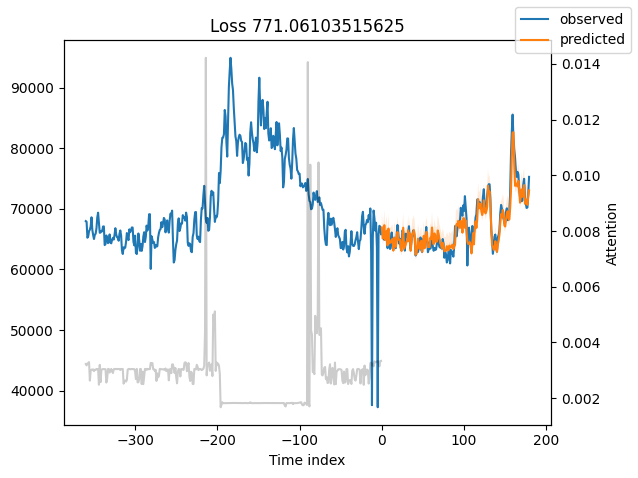

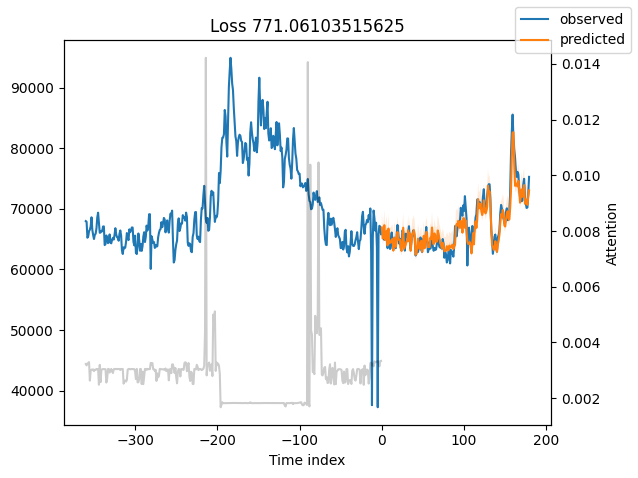

In [169]:
raw_predictions3= best_tft3.predict(val_dataloader3, mode="raw", return_x=True)
best_tft3.plot_prediction(raw_predictions3.x, raw_predictions3.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


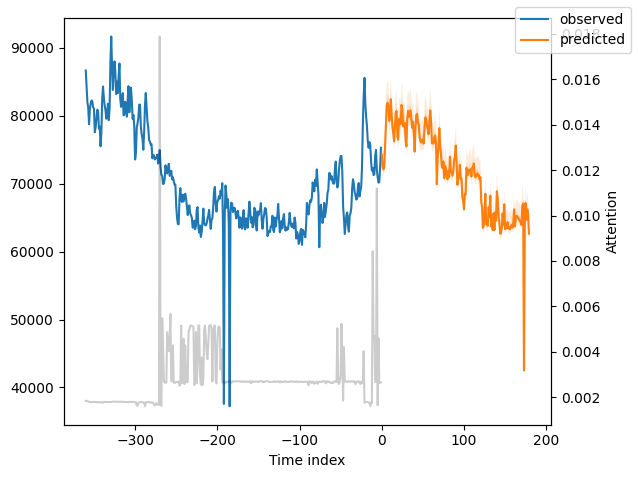

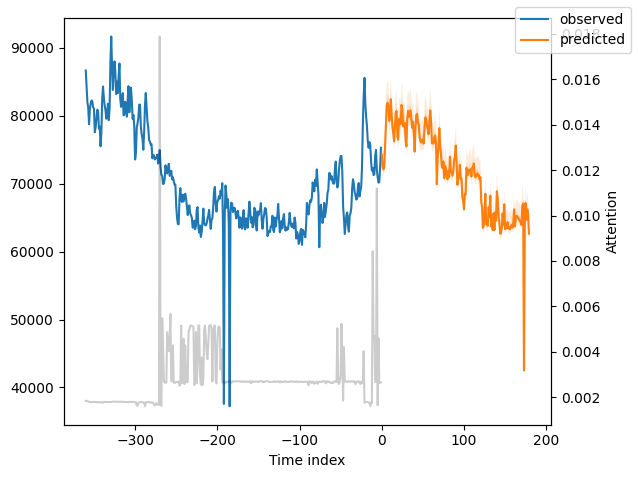

In [170]:
new_raw_predictions3= best_tft3.predict(test_dataloader3, mode="raw", return_x=True)
best_tft3.plot_prediction(new_raw_predictions3.x, new_raw_predictions3.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


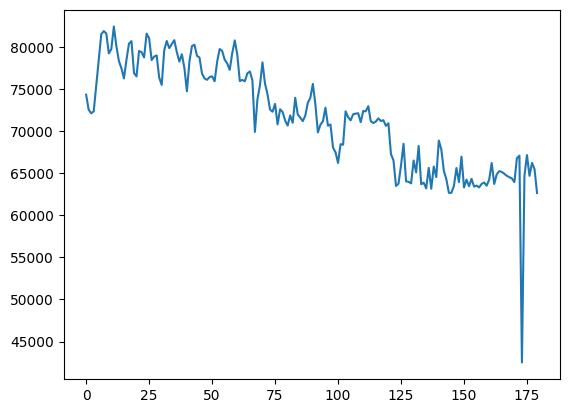

In [171]:
new_raw_predictions3 = best_tft3.predict(test_dataloader3).to('cuda')
new_raw_predictions3 = new_raw_predictions3.cpu().numpy()
new_raw_predictions3 = new_raw_predictions3[0]
plt.plot(new_raw_predictions3)

In [172]:
cluster3 = cluster[3][-180:].to_frame(name='original')
cluster3['prediction'] = new_raw_predictions3.tolist()
cluster3['MAPE'] = abs(cluster3.original-cluster3.prediction)/cluster3.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

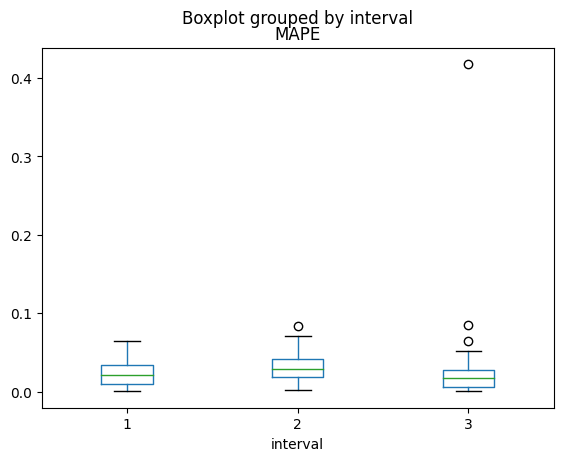

In [174]:
cluster3['interval'] = cluster3.apply (lambda row: label_time(row), axis = 1)
cluster3.boxplot(by ='interval', column =['MAPE'], grid = False)

In [175]:
mape3 = cluster3['MAPE'].mean()
mape3

0.02656861857559958

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x750 with 1 Axes>,
 'decoder_variables': <Figure size 700x725 with 1 Axes>}

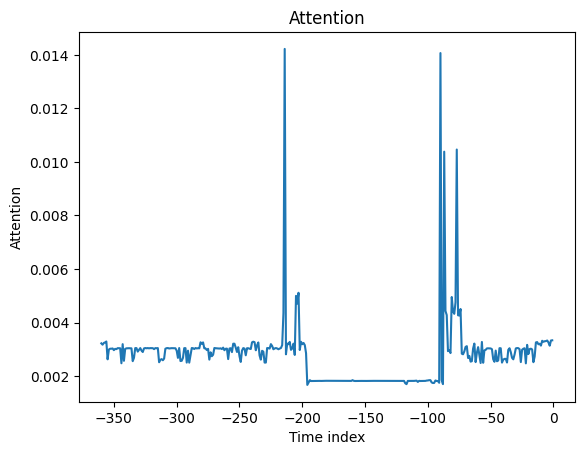

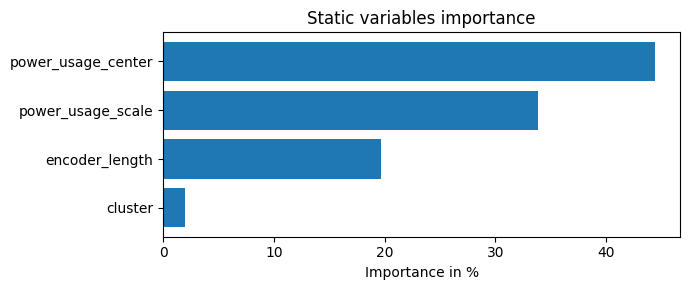

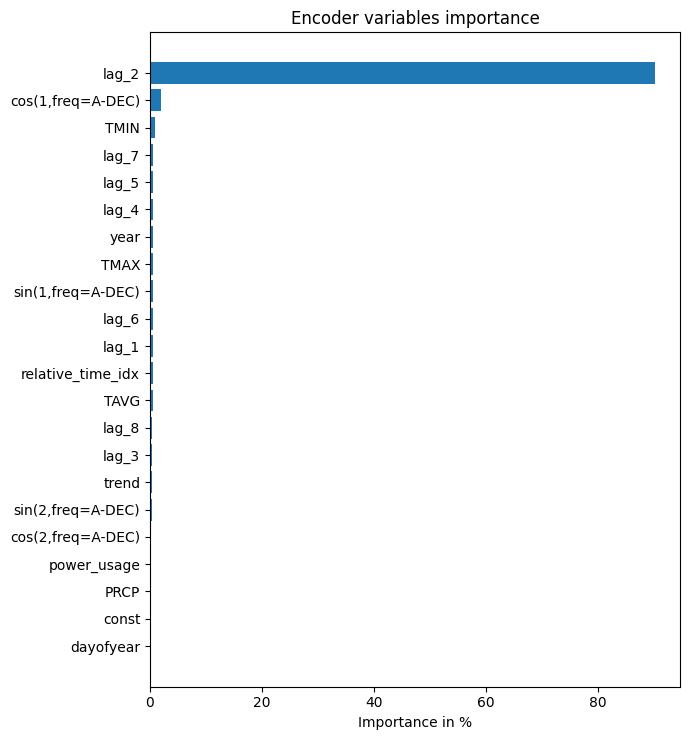

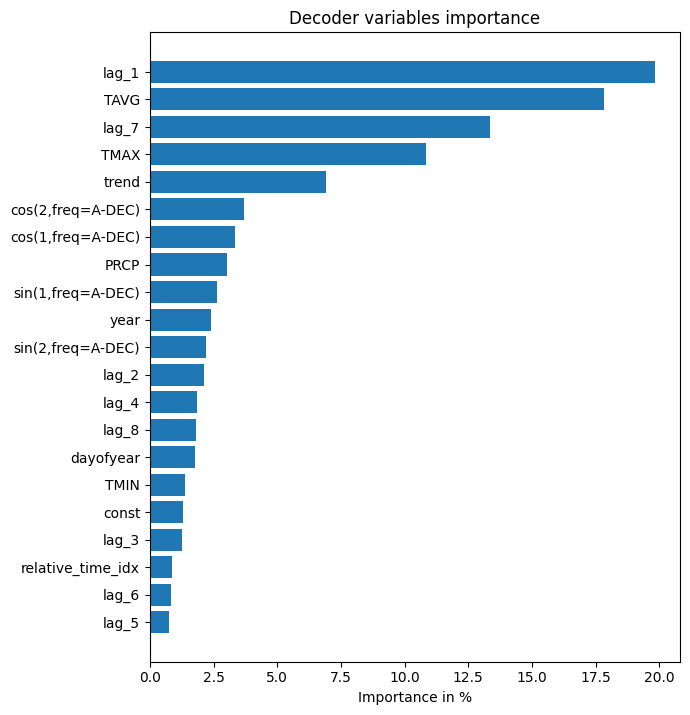

In [176]:
interpretation3 = best_tft3.interpret_output(raw_predictions3.output, reduction="sum")
best_tft3.plot_interpretation(interpretation3)

##c2 TFT

In [162]:
c2c = []
for i in c2.columns[1:-2]:
    c2c.append(i)
c2 = c2.fillna(0)
training2 = TimeSeriesDataSet(
    c2['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c2c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [163]:
validation2 = TimeSeriesDataSet.from_dataset(training2, c2[:-180], predict=True, stop_randomization=True)
test2 = TimeSeriesDataSet.from_dataset(validation2, c2, predict=True, stop_randomization=True)
train_dataloader2 = training2.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader2 = validation2.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader2 = test2.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [164]:
actuals2 = torch.cat([y for x, (y, weight) in iter(val_dataloader2)]).to('cuda')
baseline_predictions2 = Baseline().predict(val_dataloader2).to('cuda')
((actuals2 - baseline_predictions2)/(actuals2)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.6881226301193237

In [165]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer2 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft2 = TemporalFusionTransformer.from_dataset(
    training2,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [166]:
trainer2.fit(tft2,
    train_dataloaders=train_dataloader2,
    val_dataloaders=val_dataloader2)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 12.2 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.8 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.7 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 4716.713
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 4716.713


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.483 >= min_delta = 1. New best score: 4696.230
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.483 >= min_delta = 1. New best score: 4696.230


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 42.678 >= min_delta = 1. New best score: 4653.552
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 42.678 >= min_delta = 1. New best score: 4653.552


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 74.701 >= min_delta = 1. New best score: 4578.851
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 74.701 >= min_delta = 1. New best score: 4578.851


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 116.559 >= min_delta = 1. New best score: 4462.292
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 116.559 >= min_delta = 1. New best score: 4462.292


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 112.577 >= min_delta = 1. New best score: 4349.715
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 112.577 >= min_delta = 1. New best score: 4349.715


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 208.710 >= min_delta = 1. New best score: 4141.004
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 208.710 >= min_delta = 1. New best score: 4141.004


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 273.633 >= min_delta = 1. New best score: 3867.372
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 273.633 >= min_delta = 1. New best score: 3867.372


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 345.718 >= min_delta = 1. New best score: 3521.654
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 345.718 >= min_delta = 1. New best score: 3521.654


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 424.246 >= min_delta = 1. New best score: 3097.408
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 424.246 >= min_delta = 1. New best score: 3097.408


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 508.569 >= min_delta = 1. New best score: 2588.839
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 508.569 >= min_delta = 1. New best score: 2588.839


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 387.341 >= min_delta = 1. New best score: 2201.497
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 387.341 >= min_delta = 1. New best score: 2201.497


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 532.146 >= min_delta = 1. New best score: 1669.351
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 532.146 >= min_delta = 1. New best score: 1669.351


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 430.437 >= min_delta = 1. New best score: 1238.914
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 430.437 >= min_delta = 1. New best score: 1238.914


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 269.974 >= min_delta = 1. New best score: 968.940
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 269.974 >= min_delta = 1. New best score: 968.940


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 183.418 >= min_delta = 1. New best score: 785.521
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 183.418 >= min_delta = 1. New best score: 785.521


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 113.493 >= min_delta = 1. New best score: 672.028
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 113.493 >= min_delta = 1. New best score: 672.028


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 69.875 >= min_delta = 1. New best score: 602.153
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 69.875 >= min_delta = 1. New best score: 602.153


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 26.486 >= min_delta = 1. New best score: 575.667
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 26.486 >= min_delta = 1. New best score: 575.667


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 575.667. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 575.667. Signaling Trainer to stop.


In [167]:
best_model_path2 = trainer2.checkpoint_callback.best_model_path
print(best_model_path2)
best_tft2= TemporalFusionTransformer.load_from_checkpoint(best_model_path2)
actuals2_p = torch.cat([y[0] for x, y in iter(val_dataloader2)]).to('cuda')
predictions2 = best_tft2.predict(val_dataloader2).to('cuda')
((actuals2_p - predictions2)/(actuals2_p)).abs().mean().item()

lightning_logs/lightning_logs/version_0/checkpoints/epoch=29-step=570.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.21293815970420837

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


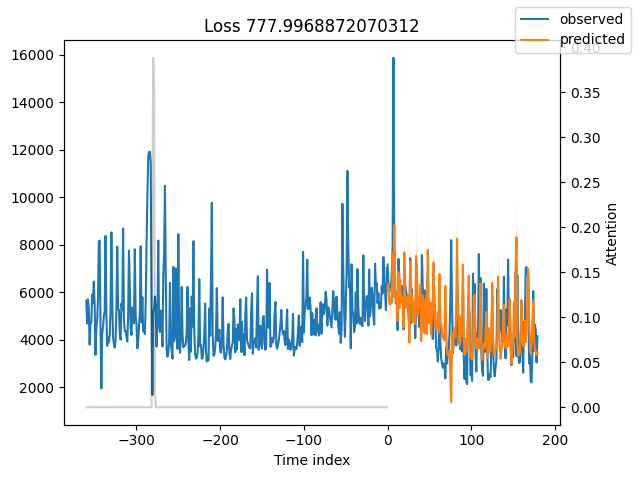

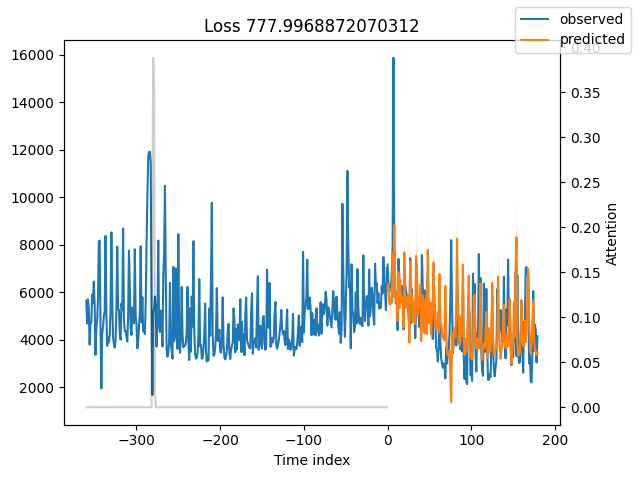

In [168]:
raw_predictions2= best_tft2.predict(val_dataloader2, mode="raw", return_x=True)
best_tft2.plot_prediction(raw_predictions2.x, raw_predictions2.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


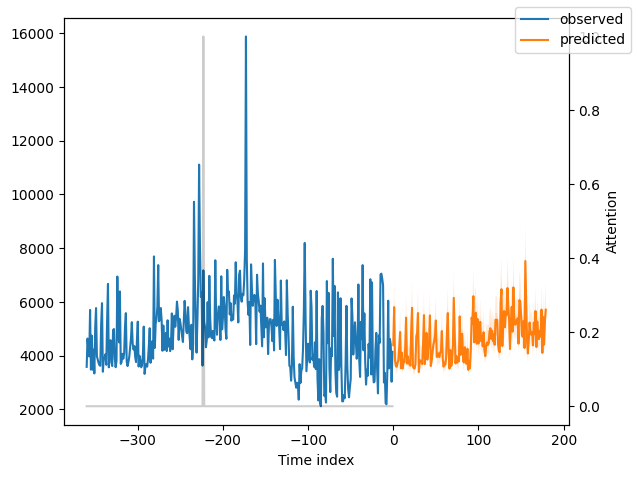

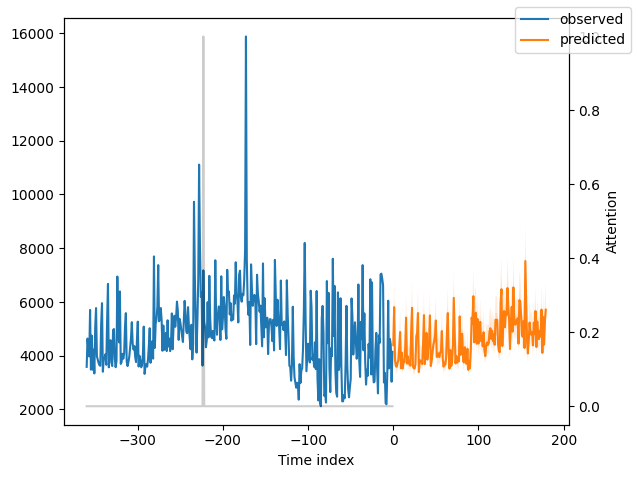

In [169]:
new_raw_predictions2 = best_tft2.predict(test_dataloader2, mode="raw", return_x=True)
best_tft2.plot_prediction(new_raw_predictions2.x, new_raw_predictions2.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


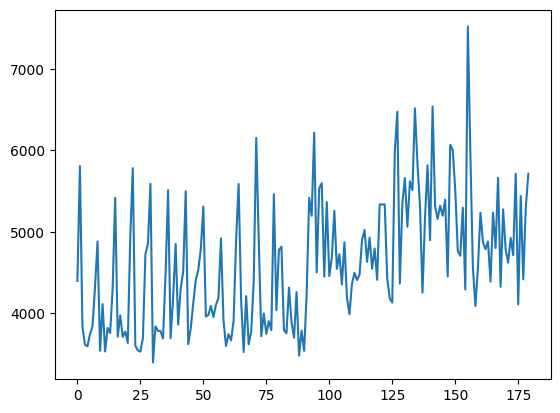

In [170]:
new_raw_predictions2 = best_tft2.predict(test_dataloader2).to('cuda')
new_raw_predictions2 = new_raw_predictions2.cpu().numpy()
new_raw_predictions2 = new_raw_predictions2[0]
plt.plot(new_raw_predictions2)

In [171]:
cluster2 = cluster[2][-180:].to_frame(name='original')
cluster2['prediction'] = new_raw_predictions2.tolist()
cluster2['MAPE'] = abs(cluster2.original-cluster2.prediction)/cluster2.original

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

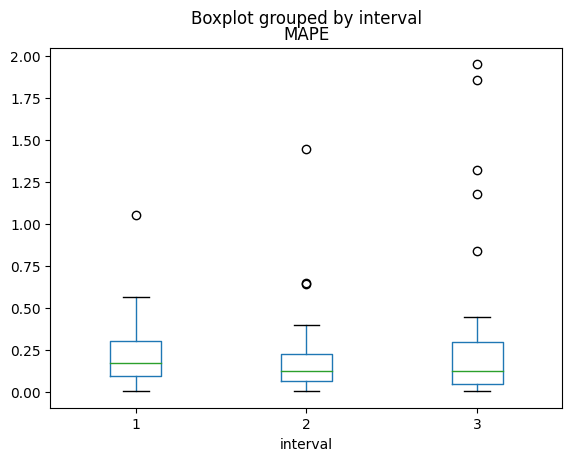

In [173]:
cluster2['interval'] = cluster2.apply (lambda row: label_time(row), axis = 1)
cluster2.boxplot(by ='interval', column =['MAPE'], grid = False)

In [174]:
mape2 = cluster2['MAPE'].mean()
mape2

0.21110438996978884

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x1075 with 1 Axes>,
 'decoder_variables': <Figure size 700x1050 with 1 Axes>}

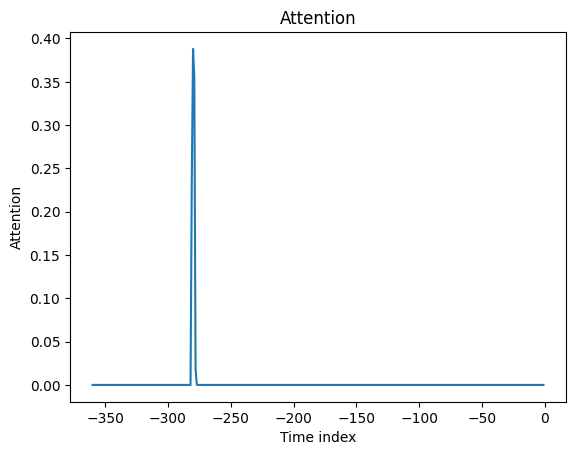

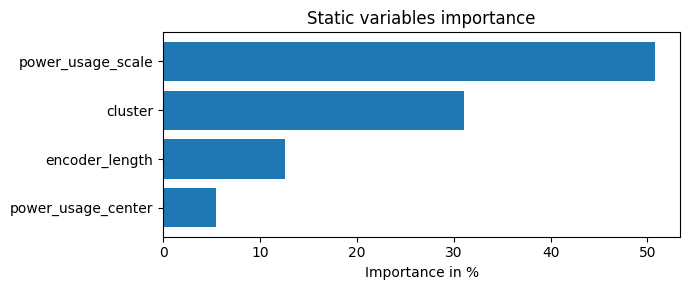

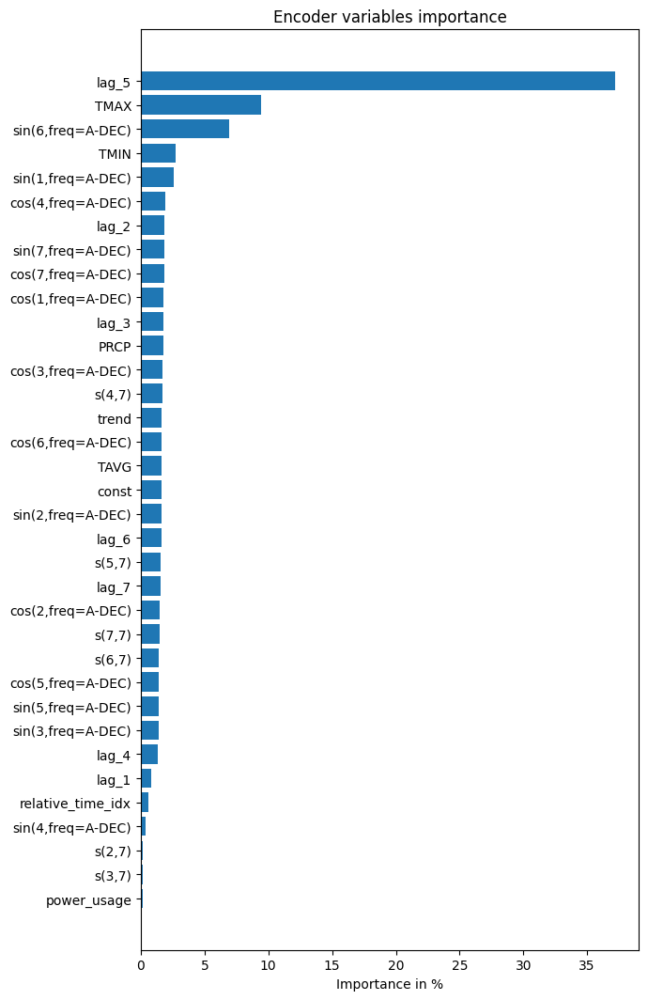

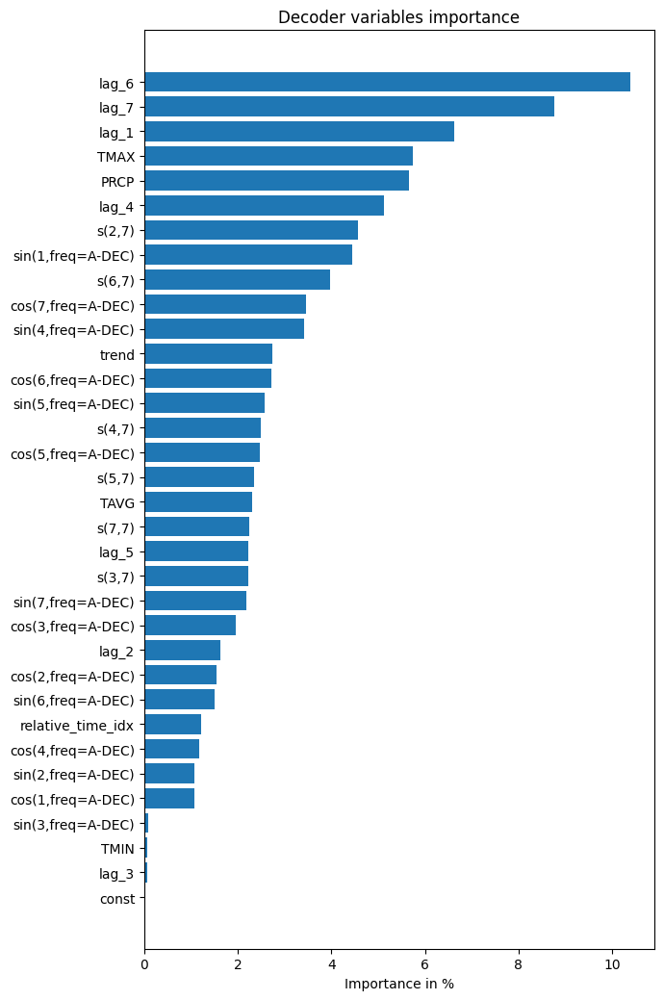

In [175]:
interpretation2 = best_tft2.interpret_output(raw_predictions2.output, reduction="sum")
best_tft2.plot_interpretation(interpretation2)

##c1 TFT

In [178]:
c1c = []
for i in c1.columns[1:-2]:
    c1c.append(i)
c1 = c1.fillna(0)
training1 = TimeSeriesDataSet(
    c1['2011-01-01':'2014-01-01'],
    time_idx="days_from_start",
    target="power_usage",
    group_ids=["cluster"],
    min_encoder_length=max_encoder_length // 2,
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["cluster"],
    time_varying_known_reals=c1c,
    time_varying_unknown_reals=['power_usage'],
    target_normalizer= None,
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

In [179]:
validation1 = TimeSeriesDataSet.from_dataset(training1, c1[:-180], predict=True, stop_randomization=True)
test1 = TimeSeriesDataSet.from_dataset(validation1, c1, predict=True, stop_randomization=True)
train_dataloader1 = training1.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader1 = validation1.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)
test_dataloader1 = test1.to_dataloader(train=False, batch_size=batch_size * 3, num_workers=0)

In [180]:
actuals1 = torch.cat([y for x, (y, weight) in iter(val_dataloader1)]).to('cuda')
baseline_predictions1 = Baseline().predict(val_dataloader1).to('cuda')
((actuals1 - baseline_predictions1)/(actuals1)).abs().mean().item()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.07389553636312485

In [181]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1, patience=10, verbose=True, mode="min")
lr_logger = LearningRateMonitor()
logger = TensorBoardLogger("lightning_logs")
trainer1 = pl.Trainer(
    max_epochs=100,
    accelerator='gpu',
    devices=1,
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[lr_logger, early_stop_callback],
    logger=logger)
tft1 = TemporalFusionTransformer.from_dataset(
    training1,
    learning_rate=0.1,
    hidden_size=160,
    attention_head_size=4,
    dropout=0.1,
    hidden_continuous_size=160,
    output_size=7,  # there are 7 quantiles by default: [0.02, 0.1, 0.25, 0.5, 0.75, 0.9, 0.98]
    loss=QuantileLoss(),
    log_interval=10,
    reduce_on_plateau_patience=4)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [182]:
trainer1.fit(tft1,
    train_dataloaders=train_dataloader1,
    val_dataloaders=val_dataloader1)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 1     
3  | prescalers                         | ModuleDict                      | 10.2 K
4  | static_variable_selection          | VariableSelectionNetwork        | 313 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 3.1 M 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 3.0 M 
7  | static_context_variable_selection  | GatedResidualNetwork            | 103 K 
8  | static_context_initia

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved. New best score: 35593.703
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 35593.703


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 20.164 >= min_delta = 1. New best score: 35573.539
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 20.164 >= min_delta = 1. New best score: 35573.539


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 41.746 >= min_delta = 1. New best score: 35531.793
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 41.746 >= min_delta = 1. New best score: 35531.793


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 73.039 >= min_delta = 1. New best score: 35458.754
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 73.039 >= min_delta = 1. New best score: 35458.754


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 114.250 >= min_delta = 1. New best score: 35344.504
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 114.250 >= min_delta = 1. New best score: 35344.504


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 110.633 >= min_delta = 1. New best score: 35233.871
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 110.633 >= min_delta = 1. New best score: 35233.871


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 205.609 >= min_delta = 1. New best score: 35028.262
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 205.609 >= min_delta = 1. New best score: 35028.262


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 270.297 >= min_delta = 1. New best score: 34757.965
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 270.297 >= min_delta = 1. New best score: 34757.965


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 342.648 >= min_delta = 1. New best score: 34415.316
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 342.648 >= min_delta = 1. New best score: 34415.316


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 422.176 >= min_delta = 1. New best score: 33993.141
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 422.176 >= min_delta = 1. New best score: 33993.141


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 508.469 >= min_delta = 1. New best score: 33484.672
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 508.469 >= min_delta = 1. New best score: 33484.672


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 411.875 >= min_delta = 1. New best score: 33072.797
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 411.875 >= min_delta = 1. New best score: 33072.797


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 669.314 >= min_delta = 1. New best score: 32403.482
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 669.314 >= min_delta = 1. New best score: 32403.482


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 772.600 >= min_delta = 1. New best score: 31630.883
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 772.600 >= min_delta = 1. New best score: 31630.883


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 881.562 >= min_delta = 1. New best score: 30749.320
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 881.562 >= min_delta = 1. New best score: 30749.320


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 995.582 >= min_delta = 1. New best score: 29753.738
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 995.582 >= min_delta = 1. New best score: 29753.738


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1114.455 >= min_delta = 1. New best score: 28639.283
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1114.455 >= min_delta = 1. New best score: 28639.283


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 853.867 >= min_delta = 1. New best score: 27785.416
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 853.867 >= min_delta = 1. New best score: 27785.416


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1325.258 >= min_delta = 1. New best score: 26460.158
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1325.258 >= min_delta = 1. New best score: 26460.158


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1460.053 >= min_delta = 1. New best score: 25000.105
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1460.053 >= min_delta = 1. New best score: 25000.105


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1598.947 >= min_delta = 1. New best score: 23401.158
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1598.947 >= min_delta = 1. New best score: 23401.158


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1741.691 >= min_delta = 1. New best score: 21659.467
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1741.691 >= min_delta = 1. New best score: 21659.467


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1888.268 >= min_delta = 1. New best score: 19771.199
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1888.268 >= min_delta = 1. New best score: 19771.199


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1413.438 >= min_delta = 1. New best score: 18357.762
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1413.438 >= min_delta = 1. New best score: 18357.762


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2147.626 >= min_delta = 1. New best score: 16210.136
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2147.626 >= min_delta = 1. New best score: 16210.136


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2305.083 >= min_delta = 1. New best score: 13905.053
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2305.083 >= min_delta = 1. New best score: 13905.053


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2467.616 >= min_delta = 1. New best score: 11437.437
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2467.616 >= min_delta = 1. New best score: 11437.437


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2634.698 >= min_delta = 1. New best score: 8802.738
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2634.698 >= min_delta = 1. New best score: 8802.738


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2805.335 >= min_delta = 1. New best score: 5997.403
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2805.335 >= min_delta = 1. New best score: 5997.403


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 1985.000 >= min_delta = 1. New best score: 4012.403
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 1985.000 >= min_delta = 1. New best score: 4012.403


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 2207.610 >= min_delta = 1. New best score: 1804.793
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 2207.610 >= min_delta = 1. New best score: 1804.793


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 173.103 >= min_delta = 1. New best score: 1631.690
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 173.103 >= min_delta = 1. New best score: 1631.690


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 228.853 >= min_delta = 1. New best score: 1402.837
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 228.853 >= min_delta = 1. New best score: 1402.837


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 19.362 >= min_delta = 1. New best score: 1383.475
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 19.362 >= min_delta = 1. New best score: 1383.475


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 334.305 >= min_delta = 1. New best score: 1049.170
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 334.305 >= min_delta = 1. New best score: 1049.170


Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 126.783 >= min_delta = 1. New best score: 922.387
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 126.783 >= min_delta = 1. New best score: 922.387


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Metric val_loss improved by 184.092 >= min_delta = 1. New best score: 738.295
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 184.092 >= min_delta = 1. New best score: 738.295


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: Monitored metric val_loss did not improve in the last 10 records. Best score: 738.295. Signaling Trainer to stop.
INFO:lightning.pytorch.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 738.295. Signaling Trainer to stop.


In [183]:
best_model_path1 = trainer1.checkpoint_callback.best_model_path
print(best_model_path1)
best_tft1 = TemporalFusionTransformer.load_from_checkpoint(best_model_path1)
actuals1_p = torch.cat([y[0] for x, y in iter(val_dataloader1)]).to('cuda')
predictions1 = best_tft1.predict(val_dataloader1).to('cuda')
((actuals1_p - predictions1)/(actuals1_p)).abs().mean().item()

lightning_logs/lightning_logs/version_1/checkpoints/epoch=50-step=969.ckpt


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


0.05415383726358414

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


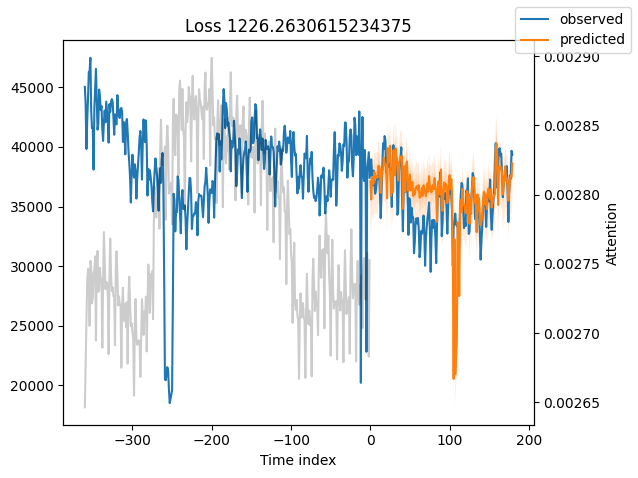

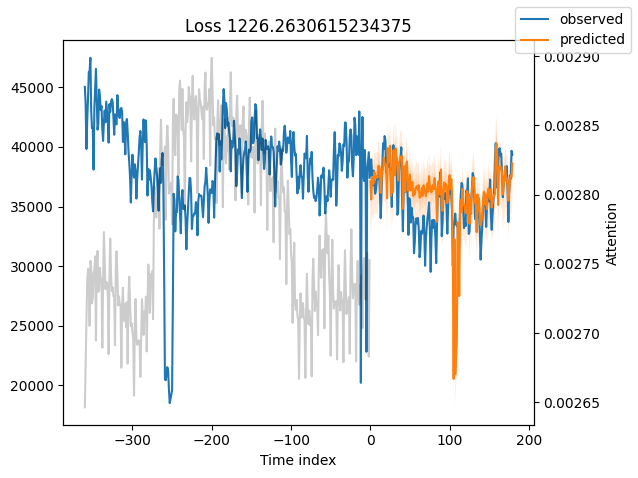

In [184]:
raw_predictions1= best_tft1.predict(val_dataloader1, mode="raw", return_x=True)
best_tft1.plot_prediction(raw_predictions1.x, raw_predictions1.output, idx=0, add_loss_to_title=True)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


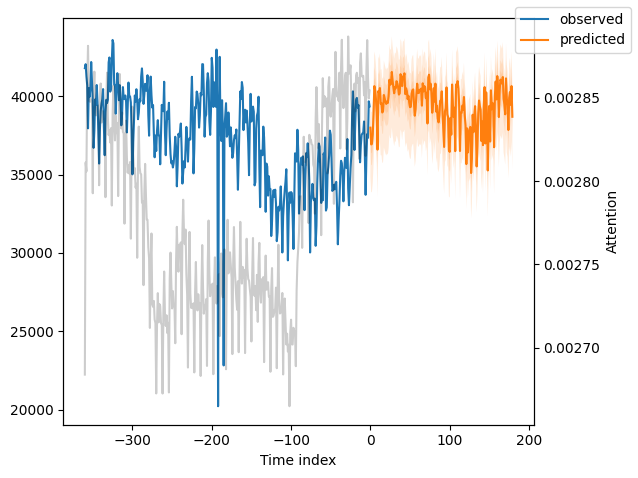

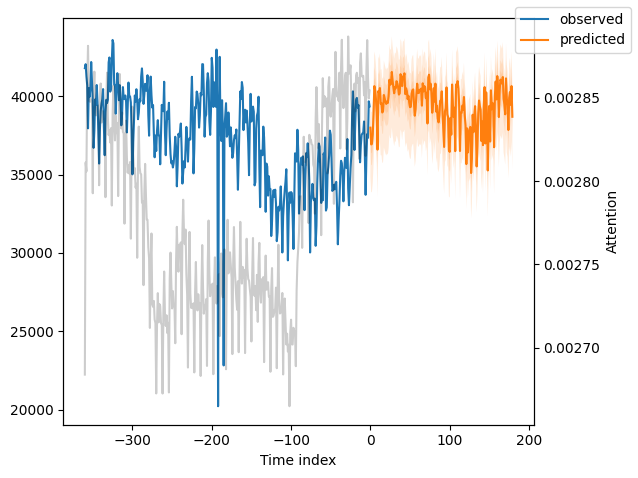

In [185]:
new_raw_predictions1 = best_tft1.predict(test_dataloader1, mode="raw", return_x=True)
best_tft1.plot_prediction(new_raw_predictions1.x, new_raw_predictions1.output, idx=0, show_future_observed=False)

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


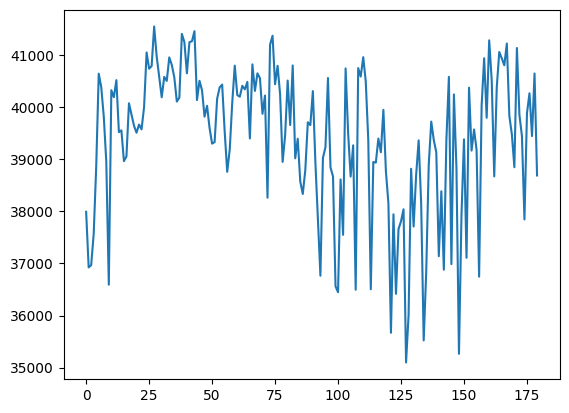

In [186]:
new_raw_predictions1 = best_tft1.predict(test_dataloader1).to('cuda')
new_raw_predictions1 = new_raw_predictions1.cpu().numpy()
new_raw_predictions1 = new_raw_predictions1[0]
plt.plot(new_raw_predictions1)

In [187]:
cluster1 = cluster[1][-180:].to_frame(name='original')
cluster1['prediction'] = new_raw_predictions1.tolist()
cluster1['MAPE'] = abs(cluster1.original-cluster1.prediction)/cluster1.original

In [188]:
def label_time (row):
    if (row.name - cluster1.index.min()).days < 60:
      return 1
    elif (row.name- cluster1.index.min()).days < 120:
      return 2
    else:
      return 3

<Axes: title={'center': 'MAPE'}, xlabel='interval'>

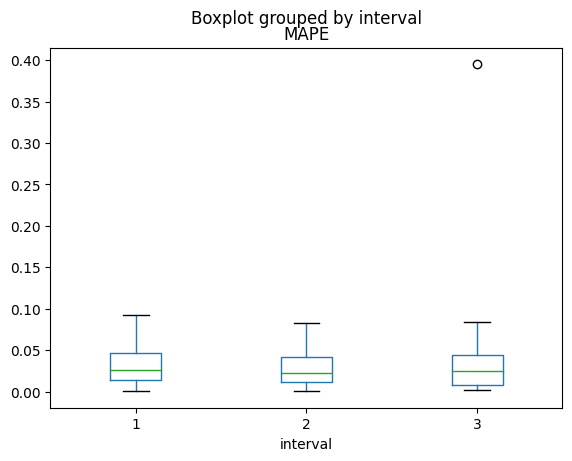

In [189]:
cluster1['interval'] = cluster1.apply (lambda row: label_time(row), axis = 1)
cluster1.boxplot(by ='interval', column =['MAPE'], grid = False)

In [190]:
mape1 = cluster1['MAPE'].mean()
mape1

0.03043797734645532

{'attention': <Figure size 640x480 with 1 Axes>,
 'static_variables': <Figure size 700x300 with 1 Axes>,
 'encoder_variables': <Figure size 700x925 with 1 Axes>,
 'decoder_variables': <Figure size 700x900 with 1 Axes>}

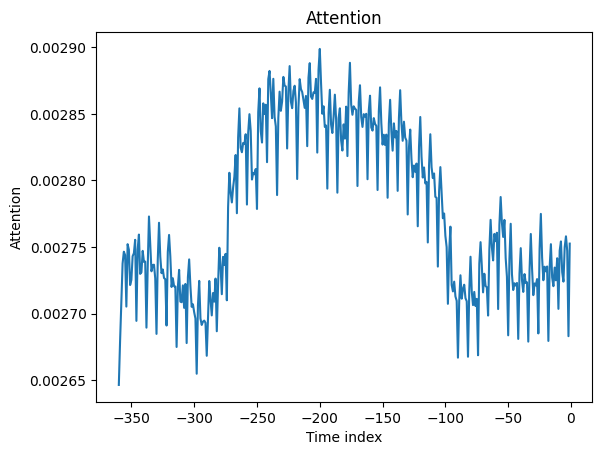

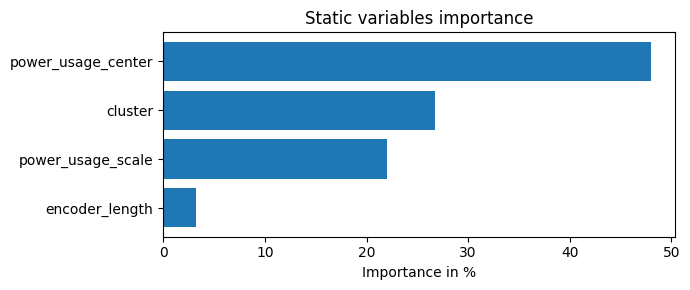

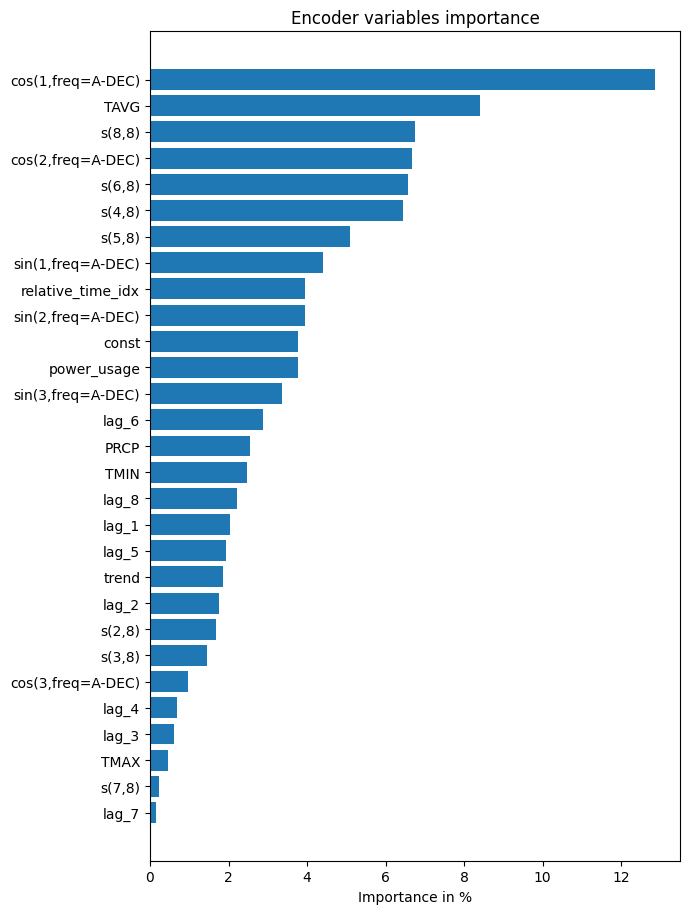

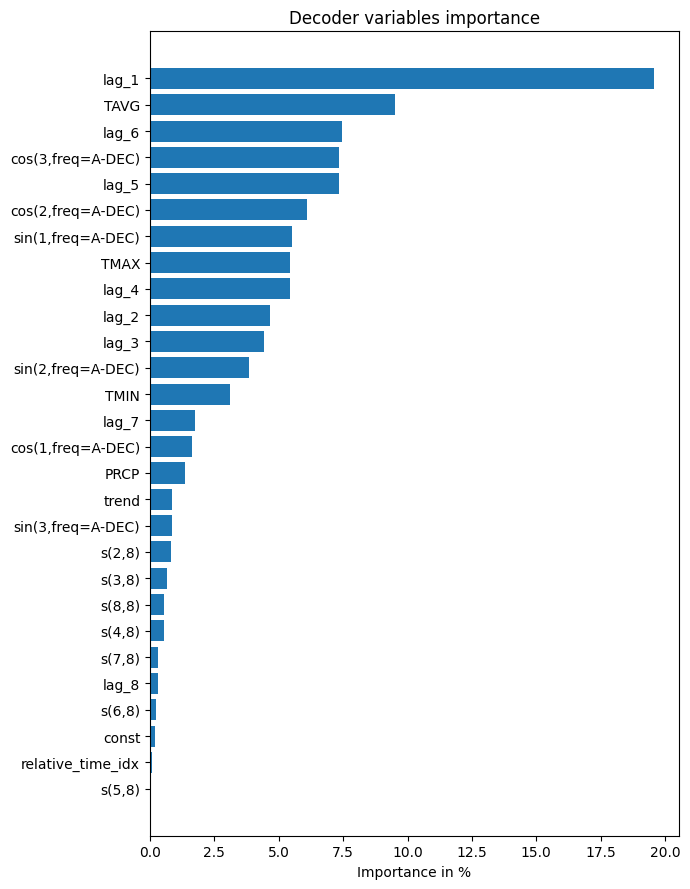

In [191]:
interpretation1 = best_tft1.interpret_output(raw_predictions1.output, reduction="sum")
best_tft1.plot_interpretation(interpretation1)



---



## Final results

In [ ]:
0.20625223307862986 * 6/370 + 0.04864703811270659 * 6/370 + 0.3081123891813 * 34/370 + 0.03773809757885193 * 7/370 + 0.21623360737927655 * 6/370 + 0.18055547413009995 * 3/370 + 0.0915144825217851 * 15/370 + 0.07605563283688646 * 2/370 + 0.08394842666833126 * 3/370 + 0.042938305456993425 * 141/370 + 0.022728467635363264 * 16/370 + 0.02463250434958997 * 121/370 + 0.2042210465002982 * 2/370 + 0.029311845577712728 * 8/370

0.07007176169746014

In [ ]:
# overall[0]['MAPE'] * 8/370 + overall[1]['MAPE']* 2/370 + overall[2]['MAPE'] * 121/370 + overall[3]['MAPE'] * 16/370 +overall[4]['MAPE'] * 141/370 + overall[5]['MAPE'] * 3/370 + overall[6]['MAPE'] * 2/370 + overall[7]['MAPE'] * 15/370 + overall[8]['MAPE'] * 3/370 + overall[9]['MAPE'] * 6/370 + overall[10]['MAPE'] * 7/370 + overall[11]['MAPE'] * 34/370 + overall[12]['MAPE'] * 6/370 + overall[13]['MAPE']* 6/370